<a href="https://colab.research.google.com/github/RaynaldyArief/ForecastingBitcoinPrice/blob/main/Skripsi-ForecastingBitcoin_LSTM_GRU_BiLSTM-RaynaldyArief.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Preprocessing

In [ ]:
%tensorflow_version 2.8
import numpy as np
import matplotlib.pyplot as plt
import math
import random
import pandas as pd
import tensorflow as tf
from sklearn.preprocessing import MinMaxScaler
from keras.utils.vis_utils import plot_model
from tensorflow import keras
from keras.models import Sequential
from keras.layers import Dense, LSTM, Dropout, GRU, Bidirectional
from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error

Colab only includes TensorFlow 2.x; %tensorflow_version has no effect.


In [ ]:
#!pip install tensorflow==2.8

In [ ]:
#!pip install keras==2.8

In [ ]:
print(tf.__version__)

In [ ]:
print(keras.__version__)

In [ ]:
#Inisialisasi weight agar tiap run hasilnya tidak random
tf.random.set_seed(20)

In [ ]:
directory_root="/content/drive/MyDrive/Dataset/Cryptocurrency/Bitcoin"

In [ ]:
dataset = pd.read_csv(directory_root+'/coin_Bitcoin.csv')
dataset.head()

,SNo,Name,Symbol,Date,High,Low,Open,Close,Volume,Marketcap
0,1,Bitcoin,BTC,2013-04-29 23:59:59,147.488007,134.000000,134.444000,144.539993,0.0,1.603769e+09
1,2,Bitcoin,BTC,2013-04-30 23:59:59,146.929993,134.050003,144.000000,139.000000,0.0,1.542813e+09
2,3,Bitcoin,BTC,2013-05-01 23:59:59,139.889999,107.720001,139.000000,116.989998,0.0,1.298955e+09
3,4,Bitcoin,BTC,2013-05-02 23:59:59,125.599998,92.281898,116.379997,105.209999,0.0,1.168517e+09
4,5,Bitcoin,BTC,2013-05-03 23:59:59,108.127998,79.099998,106.250000,97.750000,0.0,1.085995e+09


In [ ]:
dataset.tail()

,SNo,Name,Symbol,Date,High,Low,Open,Close,Volume,Marketcap
2986,2987,Bitcoin,BTC,2021-07-02 23:59:59,33939.588699,32770.680780,33549.600177,33897.048590,3.872897e+10,6.354508e+11
2987,2988,Bitcoin,BTC,2021-07-03 23:59:59,34909.259899,33402.696536,33854.421362,34668.548402,2.438396e+10,6.499397e+11
2988,2989,Bitcoin,BTC,2021-07-04 23:59:59,35937.567147,34396.477458,34665.564866,35287.779766,2.492431e+10,6.615748e+11
2989,2990,Bitcoin,BTC,2021-07-05 23:59:59,35284.344430,33213.661034,35284.344430,33746.002456,2.672155e+10,6.326962e+11
2990,2991,Bitcoin,BTC,2021-07-06 23:59:59,35038.536363,33599.916169,33723.509655,34235.193451,2.650126e+10,6.418992e+11


In [ ]:
dataset.shape

(2991, 10)

In [ ]:
dataset.dtypes

SNo            int64
Name          object
Symbol        object
Date          object
High         float64
Low          float64
Open         float64
Close        float64
Volume       float64
Marketcap    float64
dtype: object

In [ ]:
dataset['Date'] = dataset['Date'].astype('datetime64[ns]')

In [ ]:
dataset.dtypes

SNo                   int64
Name                 object
Symbol               object
Date         datetime64[ns]
High                float64
Low                 float64
Open                float64
Close               float64
Volume              float64
Marketcap           float64
dtype: object

In [ ]:
dataset.isnull().sum()

SNo          0
Name         0
Symbol       0
Date         0
High         0
Low          0
Open         0
Close        0
Volume       0
Marketcap    0
dtype: int64

In [ ]:
dataset = pd.read_csv(directory_root+'/coin_Bitcoin.csv', index_col='Date', parse_dates=['Date'])
dataset.head()

,SNo,Name,Symbol,High,Low,Open,Close,Volume,Marketcap
Date,,,,,,,,,
2013-04-29 23:59:59,1,Bitcoin,BTC,147.488007,134.000000,134.444000,144.539993,0.0,1.603769e+09
2013-04-30 23:59:59,2,Bitcoin,BTC,146.929993,134.050003,144.000000,139.000000,0.0,1.542813e+09
2013-05-01 23:59:59,3,Bitcoin,BTC,139.889999,107.720001,139.000000,116.989998,0.0,1.298955e+09
2013-05-02 23:59:59,4,Bitcoin,BTC,125.599998,92.281898,116.379997,105.209999,0.0,1.168517e+09
2013-05-03 23:59:59,5,Bitcoin,BTC,108.127998,79.099998,106.250000,97.750000,0.0,1.085995e+09


In [ ]:
df = dataset.drop(['SNo', 'Name', 'Symbol', 'Marketcap'], axis=1)
df.head()

,High,Low,Open,Close,Volume
Date,,,,,
2013-04-29 23:59:59,147.488007,134.000000,134.444000,144.539993,0.0
2013-04-30 23:59:59,146.929993,134.050003,144.000000,139.000000,0.0
2013-05-01 23:59:59,139.889999,107.720001,139.000000,116.989998,0.0
2013-05-02 23:59:59,125.599998,92.281898,116.379997,105.209999,0.0
2013-05-03 23:59:59,108.127998,79.099998,106.250000,97.750000,0.0


In [ ]:
df.tail()

,High,Low,Open,Close,Volume
Date,,,,,
2021-07-02 23:59:59,33939.588699,32770.680780,33549.600177,33897.048590,3.872897e+10
2021-07-03 23:59:59,34909.259899,33402.696536,33854.421362,34668.548402,2.438396e+10
2021-07-04 23:59:59,35937.567147,34396.477458,34665.564866,35287.779766,2.492431e+10
2021-07-05 23:59:59,35284.344430,33213.661034,35284.344430,33746.002456,2.672155e+10
2021-07-06 23:59:59,35038.536363,33599.916169,33723.509655,34235.193451,2.650126e+10


In [ ]:
df.describe()

,High,Low,Open,Close,Volume
count,2991.000000,2991.000000,2991.000000,2991.000000,2.991000e+03
mean,6893.326038,6486.009539,6700.146240,6711.290443,1.090633e+10
std,11642.832456,10869.032130,11288.043736,11298.141921,1.888895e+10
min,74.561096,65.526001,68.504997,68.431000,0.000000e+00
25%,436.179001,422.879486,430.445496,430.569489,3.036725e+07
50%,2387.610107,2178.500000,2269.889893,2286.409912,9.460360e+08
75%,8733.926948,8289.800459,8569.656494,8576.238715,1.592015e+10
max,64863.098908,62208.964366,63523.754869,63503.457930,3.509679e+11


## Visualisasi Dataset

In [ ]:
# Split data into train (80%) and test (20%)
def dataset(dataframe):
    train_size = int(len(dataframe)*0.8)
    train_dataset, test_dataset = dataframe.iloc[:train_size], dataframe.iloc[train_size:]
    return train_dataset, test_dataset

train_dataset, test_dataset = dataset(df)

Dimension of train data:  (2392, 5)
Dimension of test data:  (599, 5)


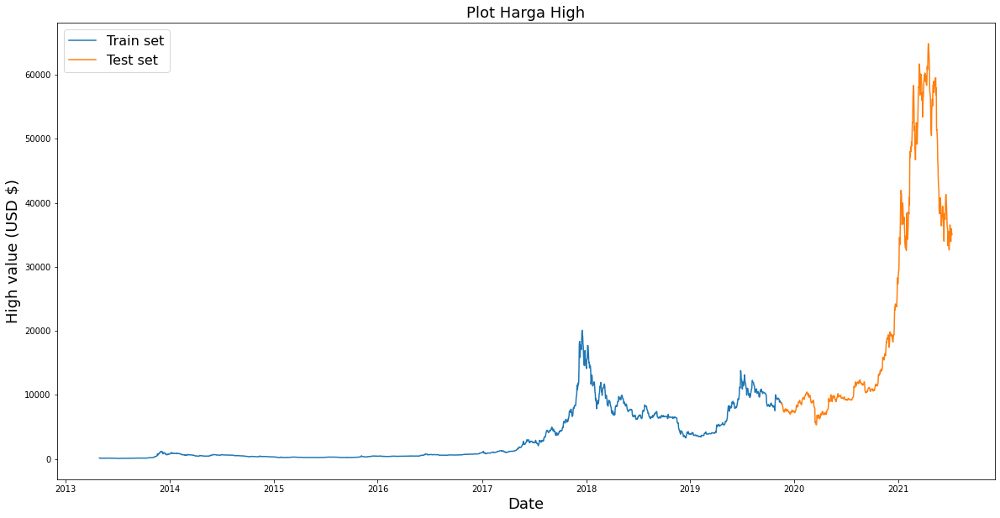

In [ ]:
# Plot train and test data
plt.figure(figsize = (20, 10))
plt.rcParams['figure.dpi'] = 240

plt.plot(train_dataset.High, linestyle="-")
plt.plot(test_dataset.High, linestyle="-")
plt.xlabel('Date', fontsize=18)
plt.ylabel('High value (USD $)', fontsize=18)
plt.title('Plot Harga High', fontsize=18)
plt.legend(['Train set', 'Test set'], loc='upper left', prop={'size': 16})
print('Dimension of train data: ', train_dataset.shape)
print('Dimension of test data: ', test_dataset.shape)

Dimension of train data:  (2392, 5)
Dimension of test data:  (599, 5)


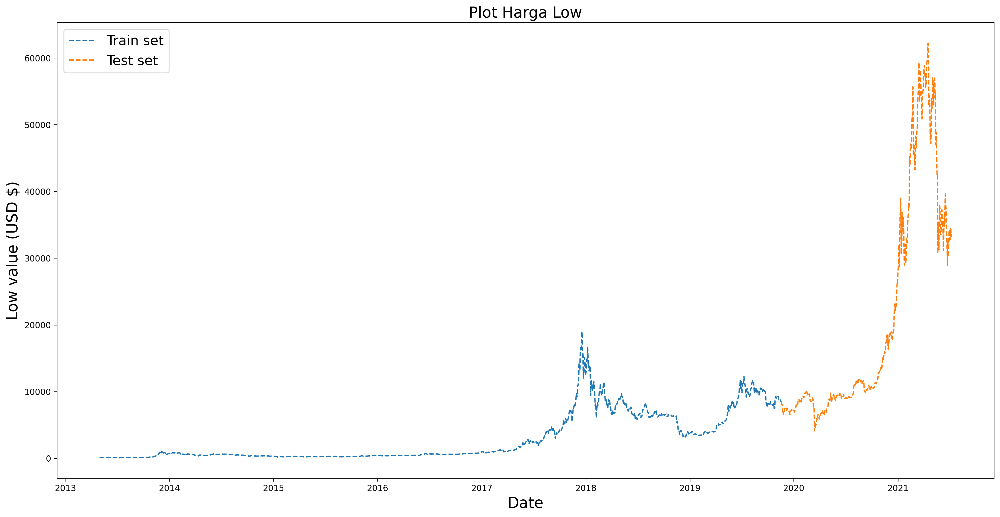

In [ ]:
# Plot train and test data
plt.figure(figsize = (20, 10))
plt.rcParams['figure.dpi'] = 240

plt.plot(train_dataset.Low, linestyle="--")
plt.plot(test_dataset.Low, linestyle="--")
plt.xlabel('Date', fontsize=18)
plt.ylabel('Low value (USD $)', fontsize=18)
plt.title('Plot Harga Low', fontsize=18)
plt.legend(['Train set', 'Test set'], loc='upper left', prop={'size': 16})
print('Dimension of train data: ',train_dataset.shape)
print('Dimension of test data: ', test_dataset.shape)

Dimension of train data:  (2392, 5)
Dimension of test data:  (599, 5)


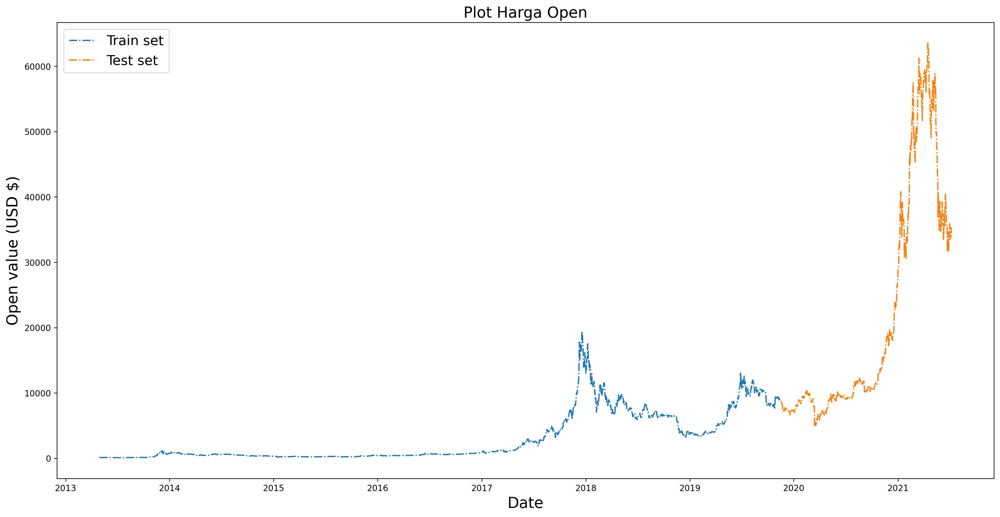

In [ ]:
# Plot train and test data
plt.figure(figsize = (20, 10))
plt.rcParams['figure.dpi'] = 240
plt.plot(train_dataset.Open, linestyle="-.")
plt.plot(test_dataset.Open, linestyle="-.")
plt.xlabel('Date', fontsize=18)
plt.ylabel('Open value (USD $)', fontsize=18)
plt.title('Plot Harga Open', fontsize=18)
plt.legend(['Train set', 'Test set'], loc='upper left', prop={'size': 16})
print('Dimension of train data: ',train_dataset.shape)
print('Dimension of test data: ', test_dataset.shape)

Dimension of train data:  (2392, 5)
Dimension of test data:  (599, 5)


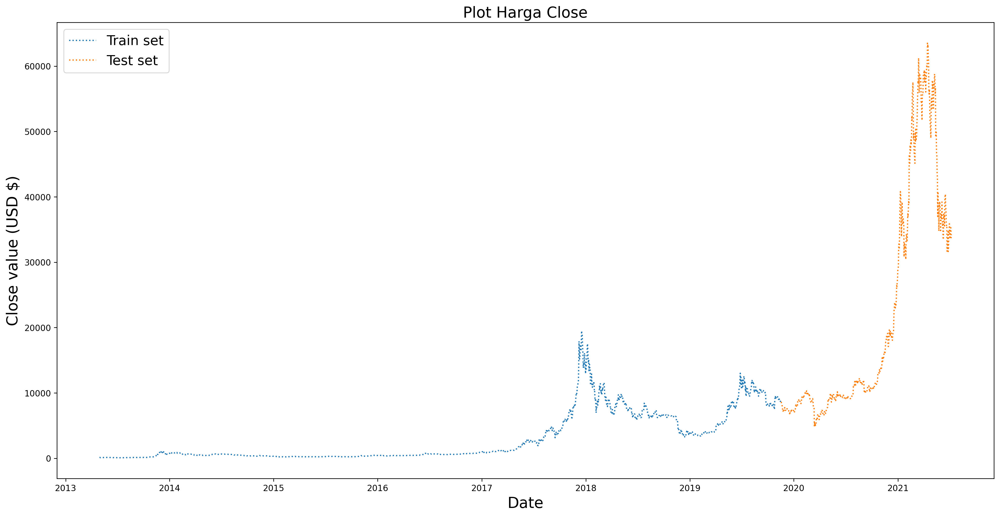

In [ ]:
# Plot train and test data
plt.figure(figsize = (20, 10))
plt.rcParams['figure.dpi'] = 240
plt.plot(train_dataset.Close, linestyle=":")
plt.plot(test_dataset.Close, linestyle=":")
plt.xlabel('Date', fontsize=18)
plt.ylabel('Close value (USD $)', fontsize=18)
plt.title('Plot Harga Close', fontsize=18)
plt.legend(['Train set', 'Test set'], loc='upper left', prop={'size': 16})
print('Dimension of train data: ', train_dataset.shape)
print('Dimension of test data: ', test_dataset.shape)

Dimension of train data:  (2392, 5)
Dimension of test data:  (599, 5)


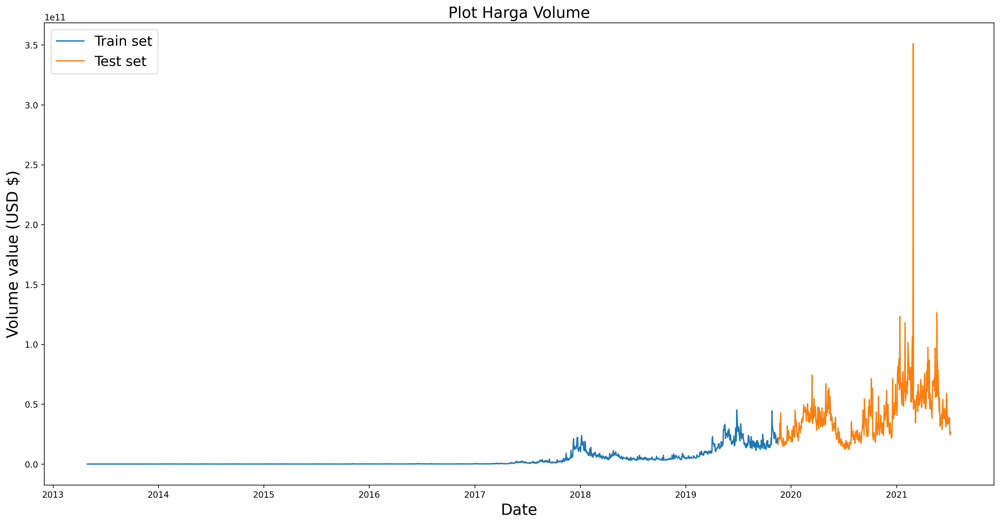

In [ ]:
# Plot train and test data
plt.figure(figsize = (20, 10))
plt.rcParams['figure.dpi'] = 240
plt.plot(train_dataset.Volume, linestyle="-")
plt.plot(test_dataset.Volume, linestyle="-")
plt.xlabel('Date', fontsize=18)
plt.ylabel('Volume value (USD $)', fontsize=18)
plt.title('Plot Harga Volume', fontsize=18)
plt.legend(['Train set', 'Test set'], loc='upper left', prop={'size': 16})
print('Dimension of train data: ', train_dataset.shape)
print('Dimension of test data: ', test_dataset.shape)

## Method

In [ ]:
#Normalisasi
scaler = MinMaxScaler(feature_range = (0,1))
def scaled(trainds, testds):
    scaler = MinMaxScaler(feature_range = (0,1))
    train_scaled = scaler.fit_transform(trainds)
    test_scaled = scaler.fit_transform(testds)
    return train_scaled, test_scaled

train_scaled, test_scaled = scaled(train_dataset, test_dataset)

In [ ]:
# Create input dataset
def create_dataset(X, look_back = 1):
    Xs, ys = [], []
 
    for i in range(len(X)-look_back):
        v = X[i:i+look_back, :]
        Xs.append(v)
        ys.append(X[i+look_back])
 
    return np.array(Xs), np.array(ys)
    
LOOK_BACK = 60

X_train, y_train = create_dataset(train_scaled, LOOK_BACK)
X_test, y_test = create_dataset(test_scaled, LOOK_BACK)

# Print data shape
print('X_train.shape: ', X_train.shape)
print('y_train.shape: ', y_train.shape)
print('X_test.shape: ', X_test.shape) 
print('y_test.shape: ', y_test.shape)

X_train.shape:  (2332, 60, 5)
y_train.shape:  (2332, 5)
X_test.shape:  (539, 60, 5)
y_test.shape:  (539, 5)


In [ ]:
print(train_scaled)

[[0.00364371 0.00362132 0.00339764 0.00391729 0.        ]
 [0.00361583 0.00362396 0.00389003 0.00363215 0.        ]
 [0.00326409 0.00223147 0.0036324  0.00249931 0.        ]
 ...
 [0.43779797 0.45990381 0.45052792 0.44983506 0.38899169]
 [0.43730342 0.45624943 0.45052291 0.44467948 0.42311118]
 [0.43250337 0.44526459 0.44504928 0.43355676 0.48323916]]


In [ ]:
print(train_dataset)

                            High          Low         Open        Close  \
Date                                                                      
2013-04-29 23:59:59   147.488007   134.000000   134.444000   144.539993   
2013-04-30 23:59:59   146.929993   134.050003   144.000000   139.000000   
2013-05-01 23:59:59   139.889999   107.720001   139.000000   116.989998   
2013-05-02 23:59:59   125.599998    92.281898   116.379997   105.209999   
2013-05-03 23:59:59   108.127998    79.099998   106.250000    97.750000   
...                          ...          ...          ...          ...   
2019-11-11 23:59:59  9081.279281  8700.608787  9056.917701  8757.788542   
2019-11-12 23:59:59  8853.768178  8685.428143  8759.751901  8815.662539   
2019-11-13 23:59:59  8836.841790  8761.651122  8812.033629  8808.262582   
2019-11-14 23:59:59  8826.943659  8692.551880  8811.936332  8708.095095   
2019-11-15 23:59:59  8730.873427  8484.844185  8705.708101  8491.992012   

                        

In [ ]:
train_df = pd.DataFrame(train_scaled, columns = ['High', 'Low', 'Open', 'Close', 'Volume'])
train_df.head(10)

,High,Low,Open,Close,Volume
0,0.003644,0.003621,0.003398,0.003917,0.0
1,0.003616,0.003624,0.003890,0.003632,0.0
2,0.003264,0.002231,0.003632,0.002499,0.0
3,0.002550,0.001415,0.002467,0.001893,0.0
4,0.001677,0.000718,0.001945,0.001509,0.0
5,0.002020,0.001427,0.001525,0.002268,0.0
6,0.002210,0.002201,0.002288,0.002444,0.0
7,0.002503,0.002174,0.002446,0.002258,0.0
8,0.001943,0.001702,0.002254,0.002217,0.0
9,0.002059,0.002331,0.002118,0.002323,0.0


In [ ]:
train_df.tail(10)

,High,Low,Open,Close,Volume
2382,0.467097,0.488687,0.477777,0.478278,0.512881
2383,0.464361,0.483211,0.478371,0.473475,0.503270
2384,0.459578,0.460638,0.473887,0.449661,0.539467
2385,0.440545,0.461570,0.450396,0.450109,0.389721
2386,0.451138,0.462258,0.450551,0.462562,0.456437
2387,0.450011,0.456676,0.463146,0.447237,0.449289
2388,0.438644,0.455873,0.447834,0.450216,0.450270
2389,0.437798,0.459904,0.450528,0.449835,0.388992
2390,0.437303,0.456249,0.450523,0.444679,0.423111
2391,0.432503,0.445265,0.445049,0.433557,0.483239


In [ ]:
print(test_scaled)

[[0.05476389 0.07516083 0.05961241 0.06116196 0.01252612]
 [0.05704491 0.07562542 0.06060871 0.06162691 0.01894227]
 [0.05579331 0.0717117  0.06102751 0.05703649 0.02753601]
 ...
 [0.51411193 0.52131605 0.50687612 0.51794992 0.03741108]
 [0.50313916 0.50095846 0.51744972 0.49160946 0.04271715]
 [0.4990101  0.50760634 0.49077843 0.49996704 0.04206676]]


In [ ]:
print(test_dataset)

                             High           Low          Open         Close  \
Date                                                                          
2019-11-16 23:59:59   8591.997241   8473.974064   8491.166317   8550.760557   
2019-11-17 23:59:59   8727.789227   8500.967887   8549.470909   8577.975782   
2019-11-18 23:59:59   8653.280158   8273.572887   8573.980092   8309.285983   
2019-11-19 23:59:59   8408.516128   8099.963369   8305.134291   8206.145918   
2019-11-20 23:59:59   8237.239874   8010.511901   8203.613180   8027.268243   
...                           ...           ...           ...           ...   
2021-07-02 23:59:59  33939.588699  32770.680780  33549.600177  33897.048590   
2021-07-03 23:59:59  34909.259899  33402.696536  33854.421362  34668.548402   
2021-07-04 23:59:59  35937.567147  34396.477458  34665.564866  35287.779766   
2021-07-05 23:59:59  35284.344430  33213.661034  35284.344430  33746.002456   
2021-07-06 23:59:59  35038.536363  33599.916169  337

In [ ]:
test_df = pd.DataFrame(test_scaled, columns = ['High', 'Low', 'Open', 'Close', 'Volume'])
test_df.head(10)

,High,Low,Open,Close,Volume
0,0.054764,0.075161,0.059612,0.061162,0.012526
1,0.057045,0.075625,0.060609,0.061627,0.018942
2,0.055793,0.071712,0.061028,0.057036,0.027536
3,0.051682,0.068724,0.056434,0.055274,0.026072
4,0.048805,0.067184,0.054699,0.052218,0.025129
5,0.046669,0.060074,0.051623,0.045649,0.030296
6,0.039736,0.048703,0.045129,0.039735,0.064921
7,0.035451,0.052398,0.039192,0.041464,0.025852
8,0.034885,0.050296,0.040943,0.035487,0.053676
9,0.033395,0.043203,0.034815,0.037165,0.089847


In [ ]:
test_df.tail(10)

,High,Low,Open,Close,Volume
589,0.492586,0.481305,0.466241,0.507048,0.068668
590,0.502056,0.512807,0.507108,0.503369,0.063888
591,0.524267,0.518838,0.503629,0.527859,0.075724
592,0.516416,0.515975,0.528113,0.513731,0.064380
593,0.498967,0.495281,0.513206,0.488639,0.075539
594,0.480550,0.493334,0.487807,0.494190,0.078167
595,0.496839,0.504212,0.493015,0.507371,0.035816
596,0.514112,0.521316,0.506876,0.517950,0.037411
597,0.503139,0.500958,0.517450,0.491609,0.042717
598,0.499010,0.507606,0.490778,0.499967,0.042067


In [ ]:
# Fit Model
def fit_model(model, X, y):
    early_stop = keras.callbacks.EarlyStopping(monitor = 'val_loss', patience = 10)
    history = model.fit(X, y, epochs = 50, validation_split = 0.2, batch_size = 32,
                        shuffle = False, callbacks = [early_stop])
    return history

In [ ]:
# Make prediction for Independen Model
def prediction(model_predict, x_test):
    prediction = model_predict.predict(x_test)
    #prediction = scaler.inverse_transform(prediction)
    return prediction

# Plot test data vs prediction Independen Model
def plot_future(prediction, model_name, y_test):
    plt.figure(figsize=(20, 6))
    range_future = len(prediction)
    plt.plot(np.arange(range_future), np.array(y_test), 
             label='Test data')
    plt.plot(np.arange(range_future), np.array(prediction), 
             label='Prediction')
    plt.title('Test data vs prediction for ' + model_name, fontsize=18)
    plt.legend(loc='upper left', prop={'size': 16})
    plt.xlabel('Time (day)', fontsize=18)
    plt.ylabel('Price (USD $)', fontsize=18)

# Plot Loss data
def plot_loss(history, model_name):
    plt.figure(figsize = (28, 12))
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('Model Train vs Validation Loss for ' + model_name, fontsize=18)
    plt.ylabel('Loss', fontsize=18)
    plt.xlabel('epoch', fontsize=18)
    plt.legend(['Train loss', 'Validation loss'], loc='upper right', prop={'size': 16})
    #plt.savefig(model_name.jpg, dpi=300)

# Model Independen

In [ ]:
#Dataframe untuk setiap variable
df_High = df.drop(['Low', 'Open', 'Close', 'Volume'], axis=1)
df_Low = df.drop(['High', 'Open', 'Close', 'Volume'], axis=1)
df_Open = df.drop(['High', 'Low', 'Close', 'Volume'], axis=1)
df_Close = df.drop(['High', 'Low', 'Open', 'Volume'], axis=1)
df_Volume = df.drop(['High', 'Low', 'Open', 'Close'], axis=1)

df_High.head()

,High
Date,
2013-04-29 23:59:59,147.488007
2013-04-30 23:59:59,146.929993
2013-05-01 23:59:59,139.889999
2013-05-02 23:59:59,125.599998
2013-05-03 23:59:59,108.127998


In [ ]:
df_High.tail()

,High
Date,
2021-07-02 23:59:59,33939.588699
2021-07-03 23:59:59,34909.259899
2021-07-04 23:59:59,35937.567147
2021-07-05 23:59:59,35284.344430
2021-07-06 23:59:59,35038.536363


In [ ]:
df_Low.head()

,Low
Date,
2013-04-29 23:59:59,134.000000
2013-04-30 23:59:59,134.050003
2013-05-01 23:59:59,107.720001
2013-05-02 23:59:59,92.281898
2013-05-03 23:59:59,79.099998


In [ ]:
df_Open.head()

,Open
Date,
2013-04-29 23:59:59,134.444000
2013-04-30 23:59:59,144.000000
2013-05-01 23:59:59,139.000000
2013-05-02 23:59:59,116.379997
2013-05-03 23:59:59,106.250000


In [ ]:
df_Close.head()

,Close
Date,
2013-04-29 23:59:59,144.539993
2013-04-30 23:59:59,139.000000
2013-05-01 23:59:59,116.989998
2013-05-02 23:59:59,105.209999
2013-05-03 23:59:59,97.750000


In [ ]:
df_Volume.head()

,Volume
Date,
2013-04-29 23:59:59,0.0
2013-04-30 23:59:59,0.0
2013-05-01 23:59:59,0.0
2013-05-02 23:59:59,0.0
2013-05-03 23:59:59,0.0


In [ ]:
train_dataset_high, test_dataset_high = dataset(df_High)
train_dataset_low, test_dataset_low = dataset(df_Low)
train_dataset_open, test_dataset_open = dataset(df_Open)
train_dataset_close, test_dataset_close = dataset(df_Close)
train_dataset_volume, test_dataset_volume = dataset(df_Volume)

In [ ]:
train_scaled_high, test_scaled_high = scaled(train_dataset_high, test_dataset_high)
train_scaled_low, test_scaled_low = scaled(train_dataset_low, test_dataset_low)
train_scaled_open, test_scaled_open = scaled(train_dataset_open, test_dataset_open)
train_scaled_close, test_scaled_close = scaled(train_dataset_close, test_dataset_close)
train_scaled_volume, test_scaled_volume = scaled(train_dataset_volume, test_dataset_volume)

In [ ]:
X_train_high, y_train_high = create_dataset(train_scaled_high, LOOK_BACK)
X_test_high, y_test_high = create_dataset(test_scaled_high, LOOK_BACK)

print('X_train_High.shape: ', X_train_high.shape)
print('y_train_High.shape: ', y_train_high.shape)
print('X_test_High.shape: ', X_test_high.shape) 
print('y_test_High.shape: ', y_test_high.shape)

X_train_High.shape:  (2332, 60, 1)
y_train_High.shape:  (2332, 1)
X_test_High.shape:  (539, 60, 1)
y_test_High.shape:  (539, 1)


In [ ]:
X_train_low, y_train_low = create_dataset(train_scaled_low, LOOK_BACK)
X_test_low, y_test_low = create_dataset(test_scaled_low, LOOK_BACK)

print('X_train_Low.shape: ', X_train_low.shape)
print('y_train_Low.shape: ', y_train_low.shape)
print('X_test_Low.shape: ', X_test_low.shape) 
print('y_test_Low.shape: ', y_test_low.shape)

X_train_Low.shape:  (2332, 60, 1)
y_train_Low.shape:  (2332, 1)
X_test_Low.shape:  (539, 60, 1)
y_test_Low.shape:  (539, 1)


In [ ]:
X_train_open, y_train_open = create_dataset(train_scaled_open, LOOK_BACK)
X_test_open, y_test_open = create_dataset(test_scaled_open, LOOK_BACK)

print('X_train_Open.shape: ', X_train_open.shape)
print('y_train_Open.shape: ', y_train_open.shape)
print('X_test_Open.shape: ', X_test_open.shape) 
print('y_test_Open.shape: ', y_test_open.shape)

X_train_Open.shape:  (2332, 60, 1)
y_train_Open.shape:  (2332, 1)
X_test_Open.shape:  (539, 60, 1)
y_test_Open.shape:  (539, 1)


In [ ]:
X_train_close, y_train_close = create_dataset(train_scaled_close, LOOK_BACK)
X_test_close, y_test_close = create_dataset(test_scaled_close, LOOK_BACK)

print('X_train_Close.shape: ', X_train_close.shape)
print('y_train_Close.shape: ', y_train_close.shape)
print('X_test_Close.shape: ', X_test_close.shape) 
print('y_test_Close.shape: ', y_test_close.shape)

X_train_Close.shape:  (2332, 60, 1)
y_train_Close.shape:  (2332, 1)
X_test_Close.shape:  (539, 60, 1)
y_test_Close.shape:  (539, 1)


In [ ]:
X_train_volume, y_train_volume = create_dataset(train_scaled_volume, LOOK_BACK)
X_test_volume, y_test_volume = create_dataset(test_scaled_volume, LOOK_BACK)

print('X_train_Volume.shape: ', X_train_volume.shape)
print('y_train_Volume.shape: ', y_train_volume.shape)
print('X_test_Volume.shape: ', X_test_volume.shape) 
print('y_test_Volume.shape: ', y_test_volume.shape)

X_train_Volume.shape:  (2332, 60, 1)
y_train_Volume.shape:  (2332, 1)
X_test_Volume.shape:  (539, 60, 1)
y_test_Volume.shape:  (539, 1)


## Model Independen LSTM

In [ ]:
# Create Independen LSTM model
def create_independen_lstm(units, x_train):
    model = Sequential()
    # Input layer
    model.add(LSTM(units = units, return_sequences = True, 
                    input_shape = ([x_train.shape[1], X_train_high.shape[2]])))
    model.add(Dropout(0.3)) 
    # Hidden layer
    model.add(LSTM (units = units*2)) 
    model.add(Dropout(0.3))
    # Output Layer
    model.add(Dense(units = 1)) 
    #Compile model
    model.compile(optimizer='adam', loss='mse')
    return model

### Independen LSTM High

In [ ]:
#Model Independen LSTM High
model_lstm_high = create_independen_lstm(32, X_train_high)

In [ ]:
print(model_lstm_high.summary())

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 60, 32)            4352      
                                                                 
 dropout (Dropout)           (None, 60, 32)            0         
                                                                 
 lstm_1 (LSTM)               (None, 64)                24832     
                                                                 
 dropout_1 (Dropout)         (None, 64)                0         
                                                                 
 dense (Dense)               (None, 1)                 65        
                                                                 
Total params: 29,249
Trainable params: 29,249
Non-trainable params: 0
_________________________________________________________________
None


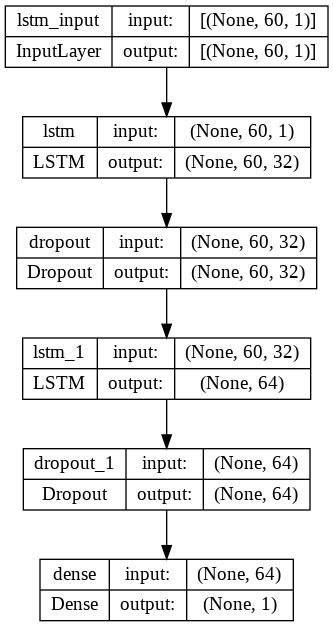

In [ ]:
plot_model(model_lstm_high, to_file='model_lstm_high.png', show_shapes=True, show_layer_names=True)

In [ ]:
history_lstm_high = fit_model(model_lstm_high, X_train_high, y_train_high)

Epoch 1/50
59/59 [==============================] - 13s 25ms/step - loss: 0.0071 - val_loss: 0.0073
Epoch 2/50
59/59 [==============================] - 1s 11ms/step - loss: 0.0176 - val_loss: 0.0061
Epoch 3/50
59/59 [==============================] - 1s 9ms/step - loss: 0.0087 - val_loss: 0.0072
Epoch 4/50
59/59 [==============================] - 1s 10ms/step - loss: 0.0021 - val_loss: 9.5542e-04
Epoch 5/50
59/59 [==============================] - 1s 9ms/step - loss: 0.0018 - val_loss: 0.0014
Epoch 6/50
59/59 [==============================] - 1s 10ms/step - loss: 0.0018 - val_loss: 0.0022
Epoch 7/50
59/59 [==============================] - 1s 10ms/step - loss: 0.0016 - val_loss: 8.3911e-04
Epoch 8/50
59/59 [==============================] - 1s 10ms/step - loss: 0.0015 - val_loss: 8.8559e-04
Epoch 9/50
59/59 [==============================] - 1s 10ms/step - loss: 0.0015 - val_loss: 9.3951e-04
Epoch 10/50
59/59 [==============================] - 1s 14ms/step - loss: 0.0013 - val_loss: 7

In [ ]:
evaluation_LSTM_high = model_lstm_high.evaluate(X_test_high, y_test_high)
print(evaluation_LSTM_high)

17/17 [==============================] - 0s 5ms/step - loss: 0.0015
0.0015009891940280795


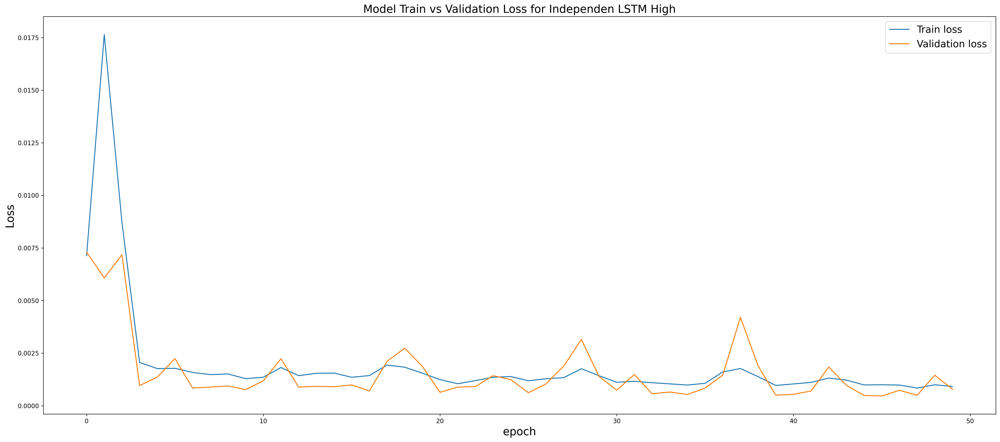

In [ ]:
plot_loss(history_lstm_high, 'Independen LSTM High') 

17/17 [==============================] - 1s 5ms/step


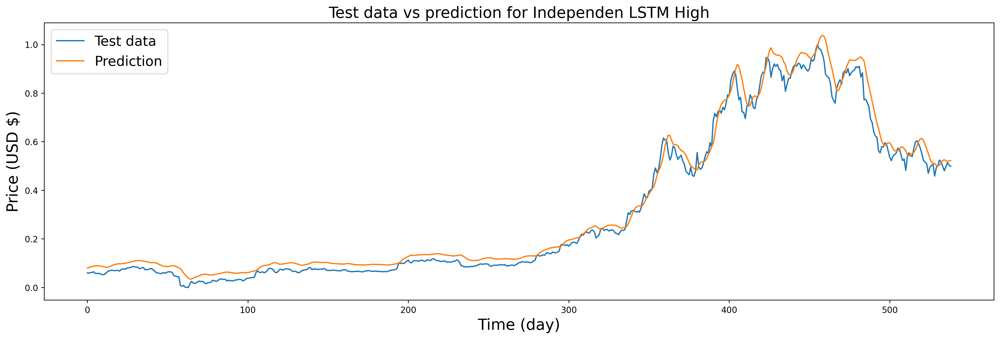

In [ ]:
prediction_lstm_high = prediction(model_lstm_high, X_test_high)
plot_future(prediction_lstm_high, 'Independen LSTM High', y_test_high)

In [ ]:
scaler = MinMaxScaler(feature_range=(0,1)).fit(test_dataset_high)
pred_inv_lstm_high = scaler.inverse_transform(prediction_lstm_high)
y_test_high_inv = scaler.inverse_transform(y_test_high)

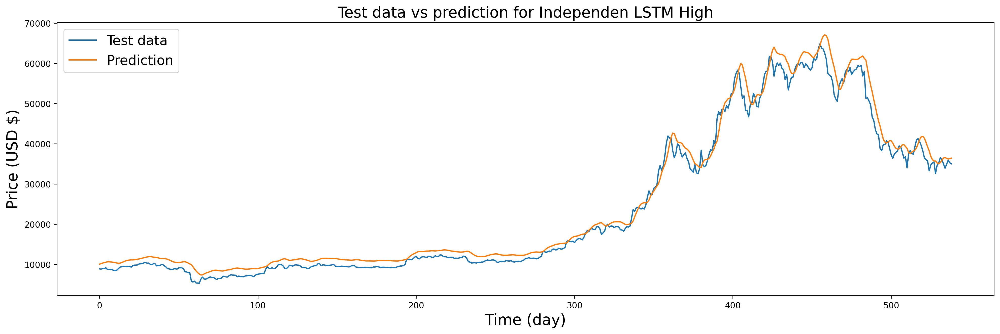

In [ ]:
plot_future(pred_inv_lstm_high, 'Independen LSTM High', y_test_high_inv)

### Independen LSTM Low

In [ ]:
#Model Independen LSTM Low
model_lstm_low = create_independen_lstm(32, X_train_low)

In [ ]:
print(model_lstm_low.summary())

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_2 (LSTM)               (None, 60, 32)            4352      
                                                                 
 dropout_2 (Dropout)         (None, 60, 32)            0         
                                                                 
 lstm_3 (LSTM)               (None, 64)                24832     
                                                                 
 dropout_3 (Dropout)         (None, 64)                0         
                                                                 
 dense_1 (Dense)             (None, 1)                 65        
                                                                 
Total params: 29,249
Trainable params: 29,249
Non-trainable params: 0
_________________________________________________________________
None


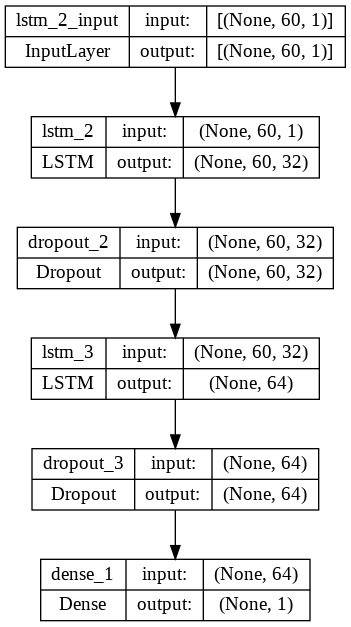

In [ ]:
plot_model(model_lstm_low, to_file='model_lstm_low.png', show_shapes=True, show_layer_names=True)

In [ ]:
history_lstm_low = fit_model(model_lstm_low, X_train_low, y_train_low)

Epoch 1/50
59/59 [==============================] - 4s 22ms/step - loss: 0.0047 - val_loss: 0.0147
Epoch 2/50
59/59 [==============================] - 1s 10ms/step - loss: 0.0156 - val_loss: 0.0235
Epoch 3/50
59/59 [==============================] - 1s 10ms/step - loss: 0.0152 - val_loss: 0.0080
Epoch 4/50
59/59 [==============================] - 1s 10ms/step - loss: 0.0058 - val_loss: 0.0069
Epoch 5/50
59/59 [==============================] - 1s 10ms/step - loss: 0.0029 - val_loss: 0.0054
Epoch 6/50
59/59 [==============================] - 1s 10ms/step - loss: 0.0022 - val_loss: 0.0032
Epoch 7/50
59/59 [==============================] - 1s 10ms/step - loss: 0.0019 - val_loss: 0.0032
Epoch 8/50
59/59 [==============================] - 1s 10ms/step - loss: 0.0017 - val_loss: 0.0026
Epoch 9/50
59/59 [==============================] - 1s 10ms/step - loss: 0.0017 - val_loss: 0.0021
Epoch 10/50
59/59 [==============================] - 1s 10ms/step - loss: 0.0014 - val_loss: 9.3820e-04
Epoch

In [ ]:
evaluation_LSTM_low = model_lstm_low.evaluate(X_test_low, y_test_low)
print(evaluation_LSTM_low)

17/17 [==============================] - 0s 5ms/step - loss: 0.0015
0.0015122672775760293


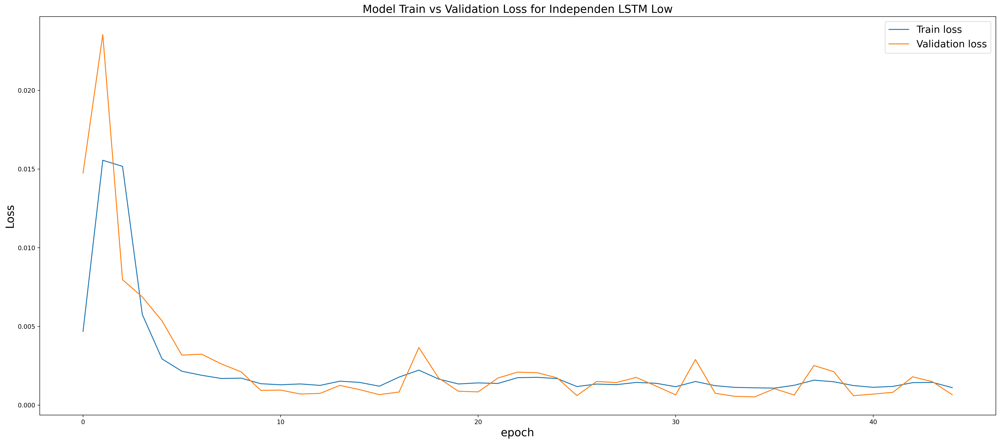

In [ ]:
plot_loss(history_lstm_low, 'Independen LSTM Low') 

17/17 [==============================] - 1s 4ms/step


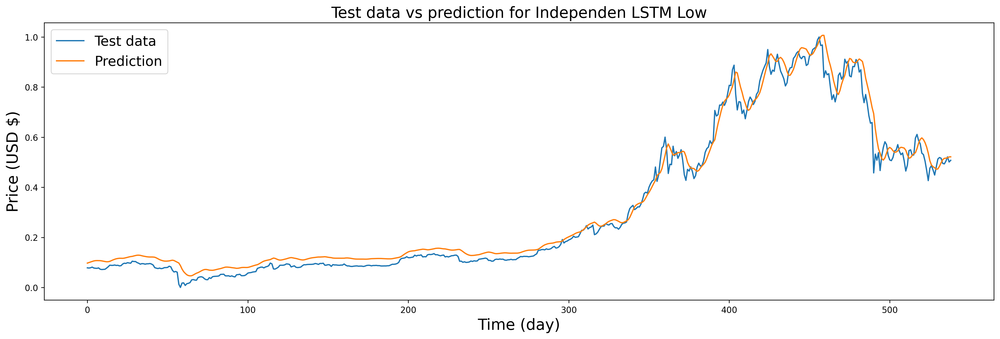

In [ ]:
prediction_lstm_low = prediction(model_lstm_low, X_test_low)
plot_future(prediction_lstm_low, 'Independen LSTM Low', y_test_low)

In [ ]:
scaler = MinMaxScaler(feature_range=(0,1)).fit(test_dataset_low)
pred_inv_lstm_low = scaler.inverse_transform(prediction_lstm_low)
y_test_low_inv = scaler.inverse_transform(y_test_low)

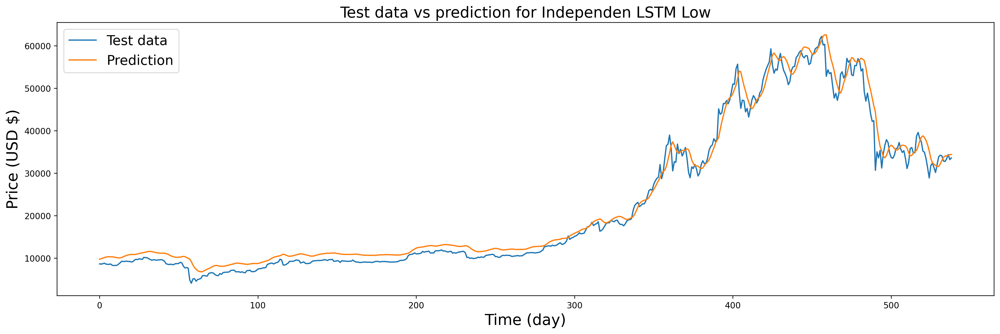

In [ ]:
plot_future(pred_inv_lstm_low, 'Independen LSTM Low', y_test_low_inv)

### Independen LSTM Open

In [ ]:
#Model Independen LSTM Open
model_lstm_open = create_independen_lstm(32, X_train_open)

In [ ]:
print(model_lstm_open.summary())

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_4 (LSTM)               (None, 60, 32)            4352      
                                                                 
 dropout_4 (Dropout)         (None, 60, 32)            0         
                                                                 
 lstm_5 (LSTM)               (None, 64)                24832     
                                                                 
 dropout_5 (Dropout)         (None, 64)                0         
                                                                 
 dense_2 (Dense)             (None, 1)                 65        
                                                                 
Total params: 29,249
Trainable params: 29,249
Non-trainable params: 0
_________________________________________________________________
None


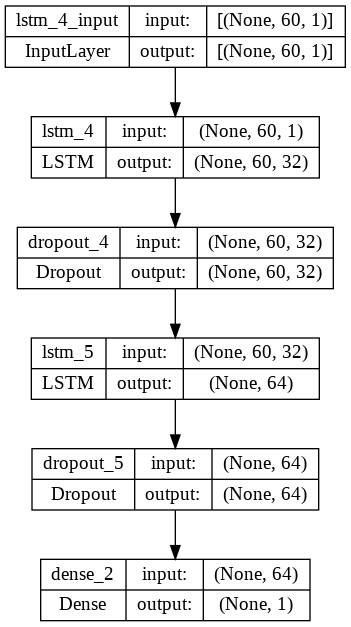

In [ ]:
plot_model(model_lstm_open, to_file='model_lstm_open.png', show_shapes=True, show_layer_names=True)

In [ ]:
history_lstm_open = fit_model(model_lstm_open, X_train_open, y_train_open)

Epoch 1/50
59/59 [==============================] - 4s 22ms/step - loss: 0.0060 - val_loss: 0.0073
Epoch 2/50
59/59 [==============================] - 1s 10ms/step - loss: 0.0141 - val_loss: 0.0133
Epoch 3/50
59/59 [==============================] - 1s 10ms/step - loss: 0.0100 - val_loss: 0.0093
Epoch 4/50
59/59 [==============================] - 1s 9ms/step - loss: 0.0030 - val_loss: 0.0034
Epoch 5/50
59/59 [==============================] - 1s 10ms/step - loss: 0.0028 - val_loss: 0.0038
Epoch 6/50
59/59 [==============================] - 1s 9ms/step - loss: 0.0024 - val_loss: 0.0069
Epoch 7/50
59/59 [==============================] - 1s 10ms/step - loss: 0.0028 - val_loss: 0.0062
Epoch 8/50
59/59 [==============================] - 1s 13ms/step - loss: 0.0024 - val_loss: 0.0058
Epoch 9/50
59/59 [==============================] - 1s 15ms/step - loss: 0.0023 - val_loss: 0.0050
Epoch 10/50
59/59 [==============================] - 1s 10ms/step - loss: 0.0016 - val_loss: 0.0021
Epoch 11/50

In [ ]:
evaluation_LSTM_open = model_lstm_open.evaluate(X_test_open, y_test_open)
print(evaluation_LSTM_open)

17/17 [==============================] - 0s 6ms/step - loss: 0.0020
0.002028221497312188


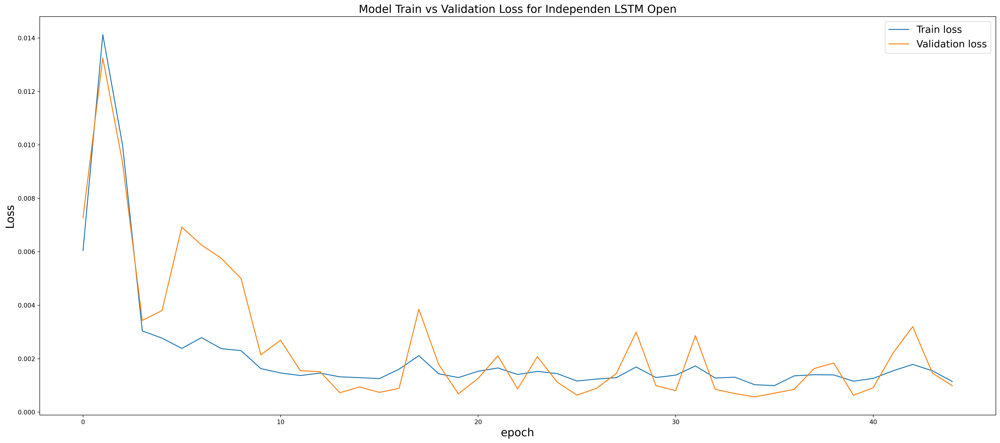

In [ ]:
plot_loss(history_lstm_open, 'Independen LSTM Open') 

17/17 [==============================] - 1s 4ms/step


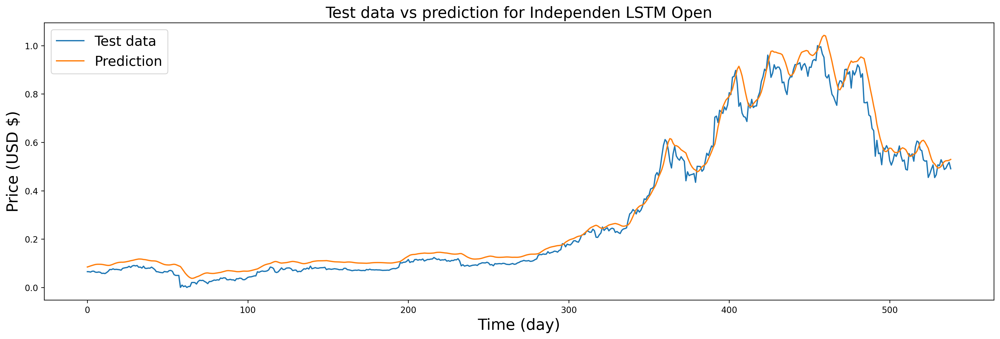

In [ ]:
prediction_lstm_open = prediction(model_lstm_open, X_test_open)
plot_future(prediction_lstm_open, 'Independen LSTM Open', y_test_open)

In [ ]:
scaler = MinMaxScaler(feature_range=(0,1)).fit(test_dataset_open)
pred_inv_lstm_open = scaler.inverse_transform(prediction_lstm_open)
y_test_open_inv = scaler.inverse_transform(y_test_open)

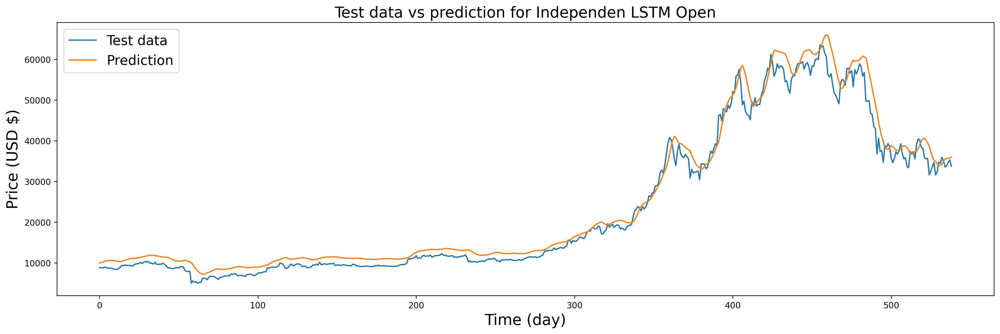

In [ ]:
plot_future(pred_inv_lstm_open, 'Independen LSTM Open', y_test_open_inv)

### Independen LSTM Close

In [ ]:
#Model Independen LSTM Close
model_lstm_close = create_independen_lstm(32, X_train_close)

In [ ]:
print(model_lstm_close.summary())

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_6 (LSTM)               (None, 60, 32)            4352      
                                                                 
 dropout_6 (Dropout)         (None, 60, 32)            0         
                                                                 
 lstm_7 (LSTM)               (None, 64)                24832     
                                                                 
 dropout_7 (Dropout)         (None, 64)                0         
                                                                 
 dense_3 (Dense)             (None, 1)                 65        
                                                                 
Total params: 29,249
Trainable params: 29,249
Non-trainable params: 0
_________________________________________________________________
None


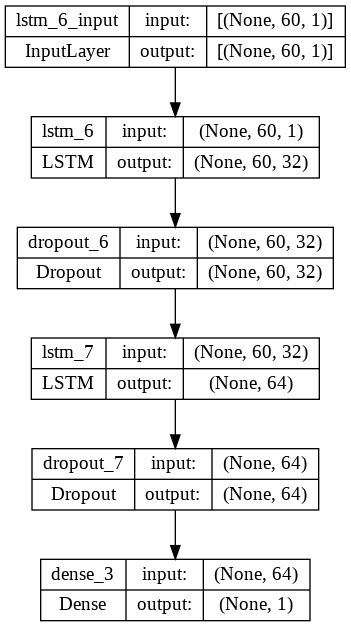

In [ ]:
plot_model(model_lstm_close, to_file='model_lstm_close.png', show_shapes=True, show_layer_names=True)

In [ ]:
history_lstm_close= fit_model(model_lstm_close, X_train_close, y_train_close)

Epoch 1/50
59/59 [==============================] - 4s 23ms/step - loss: 0.0038 - val_loss: 0.0168
Epoch 2/50
59/59 [==============================] - 1s 10ms/step - loss: 0.0118 - val_loss: 0.0248
Epoch 3/50
59/59 [==============================] - 1s 10ms/step - loss: 0.0084 - val_loss: 0.0131
Epoch 4/50
59/59 [==============================] - 1s 9ms/step - loss: 0.0033 - val_loss: 0.0011
Epoch 5/50
59/59 [==============================] - 1s 10ms/step - loss: 0.0017 - val_loss: 8.8855e-04
Epoch 6/50
59/59 [==============================] - 1s 10ms/step - loss: 0.0015 - val_loss: 0.0013
Epoch 7/50
59/59 [==============================] - 1s 9ms/step - loss: 0.0017 - val_loss: 0.0011
Epoch 8/50
59/59 [==============================] - 1s 9ms/step - loss: 0.0017 - val_loss: 0.0011
Epoch 9/50
59/59 [==============================] - 1s 10ms/step - loss: 0.0018 - val_loss: 8.3439e-04
Epoch 10/50
59/59 [==============================] - 1s 9ms/step - loss: 0.0015 - val_loss: 8.2516e-04
E

In [ ]:
evaluation_LSTM_close = model_lstm_close.evaluate(X_test_close, y_test_close)
print(evaluation_LSTM_close)

17/17 [==============================] - 0s 6ms/step - loss: 0.0020
0.0020004864782094955


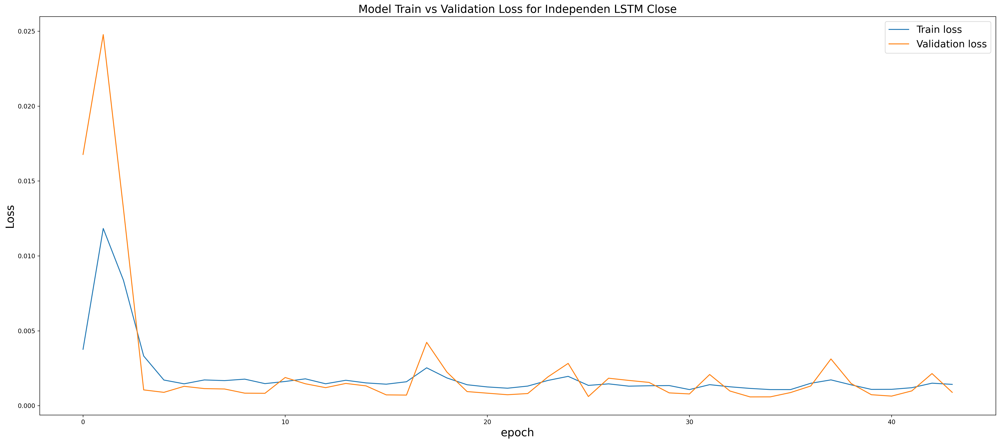

In [ ]:
plot_loss(history_lstm_close, 'Independen LSTM Close') 

17/17 [==============================] - 1s 4ms/step


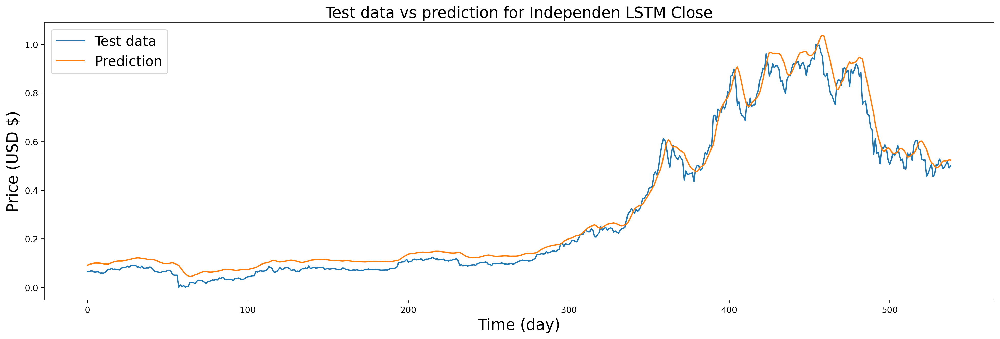

In [ ]:
prediction_lstm_close= prediction(model_lstm_close, X_test_close)
plot_future(prediction_lstm_close, 'Independen LSTM Close', y_test_close)

In [ ]:
scaler = MinMaxScaler(feature_range=(0,1)).fit(test_dataset_close)
pred_inv_lstm_close = scaler.inverse_transform(prediction_lstm_close)
y_test_close_inv = scaler.inverse_transform(y_test_close)

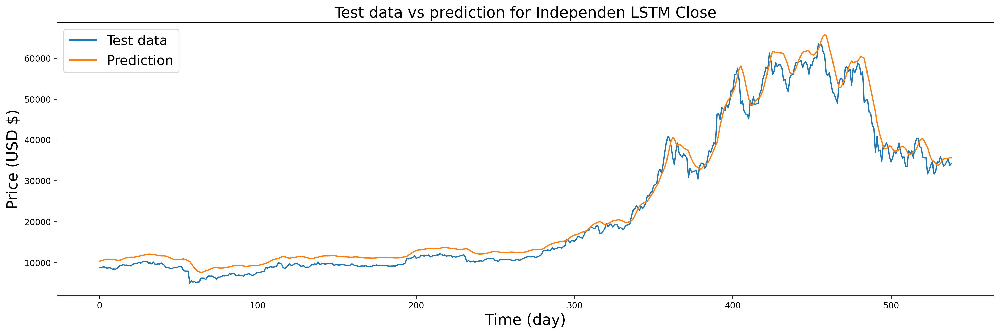

In [ ]:
plot_future(pred_inv_lstm_close, 'Independen LSTM Close', y_test_close_inv)

### Independen LSTM Volume

In [ ]:
#Model Independen LSTM Volume
model_lstm_volume = create_independen_lstm(32, X_train_volume)

In [ ]:
print(model_lstm_volume.summary())

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_8 (LSTM)               (None, 60, 32)            4352      
                                                                 
 dropout_8 (Dropout)         (None, 60, 32)            0         
                                                                 
 lstm_9 (LSTM)               (None, 64)                24832     
                                                                 
 dropout_9 (Dropout)         (None, 64)                0         
                                                                 
 dense_4 (Dense)             (None, 1)                 65        
                                                                 
Total params: 29,249
Trainable params: 29,249
Non-trainable params: 0
_________________________________________________________________
None


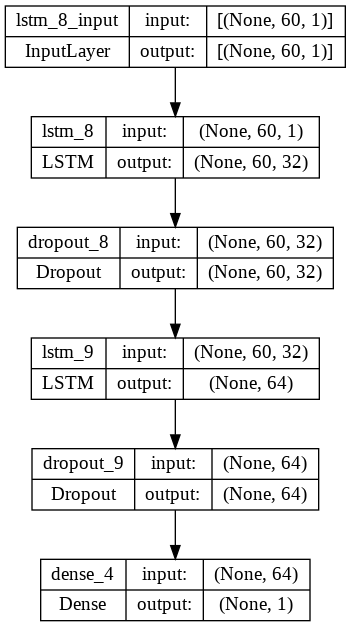

In [ ]:
plot_model(model_lstm_volume, to_file='model_lstm_volume.png', show_shapes=True, show_layer_names=True)

In [ ]:
history_lstm_volume = fit_model(model_lstm_volume, X_train_volume, y_train_volume)

Epoch 1/50
59/59 [==============================] - 4s 22ms/step - loss: 0.0016 - val_loss: 0.0128
Epoch 2/50
59/59 [==============================] - 1s 9ms/step - loss: 0.0026 - val_loss: 0.0115
Epoch 3/50
59/59 [==============================] - 1s 10ms/step - loss: 0.0024 - val_loss: 0.0073
Epoch 4/50
59/59 [==============================] - 1s 10ms/step - loss: 0.0011 - val_loss: 0.0074
Epoch 5/50
59/59 [==============================] - 1s 10ms/step - loss: 6.2810e-04 - val_loss: 0.0073
Epoch 6/50
59/59 [==============================] - 1s 9ms/step - loss: 5.7600e-04 - val_loss: 0.0068
Epoch 7/50
59/59 [==============================] - 1s 9ms/step - loss: 5.7076e-04 - val_loss: 0.0066
Epoch 8/50
59/59 [==============================] - 1s 10ms/step - loss: 5.7918e-04 - val_loss: 0.0065
Epoch 9/50
59/59 [==============================] - 1s 9ms/step - loss: 5.6211e-04 - val_loss: 0.0068
Epoch 10/50
59/59 [==============================] - 1s 10ms/step - loss: 6.2597e-04 - val_lo

In [ ]:
evaluation_LSTM_volume = model_lstm_volume.evaluate(X_test_volume, y_test_volume)
print(evaluation_LSTM_volume)

17/17 [==============================] - 0s 6ms/step - loss: 0.0028
0.0028253665659576654


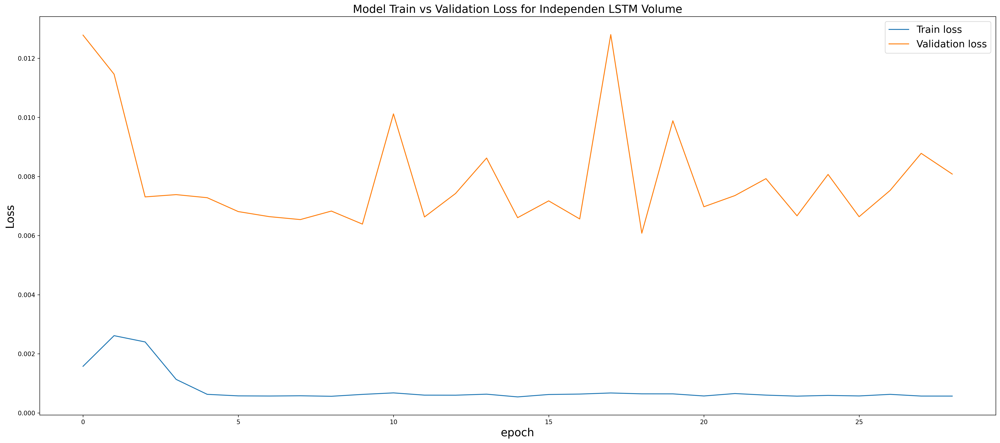

In [ ]:
plot_loss(history_lstm_volume, 'Independen LSTM Volume') 

17/17 [==============================] - 1s 4ms/step


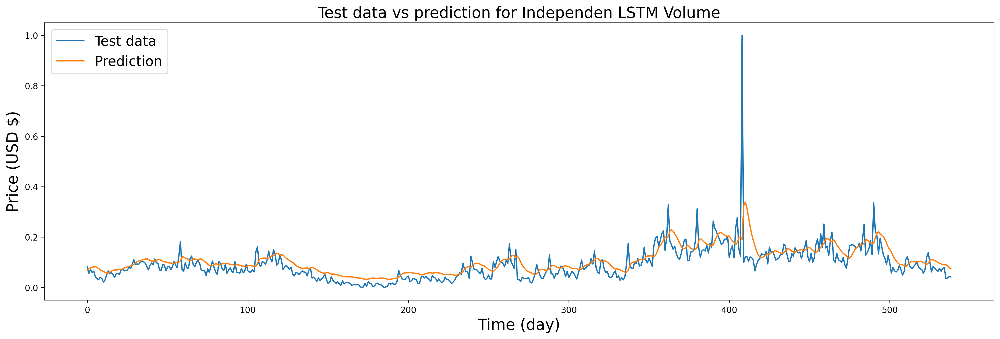

In [ ]:
prediction_lstm_volume = prediction(model_lstm_volume, X_test_volume)
plot_future(prediction_lstm_volume, 'Independen LSTM Volume', y_test_volume)

In [ ]:
scaler = MinMaxScaler(feature_range=(0,1)).fit(test_dataset_volume)
pred_inv_lstm_volume = scaler.inverse_transform(prediction_lstm_volume)
y_test_volume_inv = scaler.inverse_transform(y_test_volume)

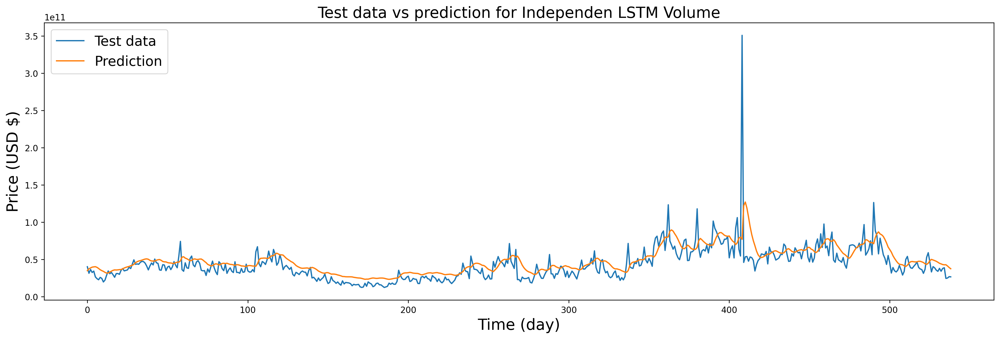

In [ ]:
plot_future(pred_inv_lstm_volume, 'Independen LSTM Volume', y_test_volume_inv)

### Ukuran Kinerja Model Independen LSTM

In [ ]:
mse = mean_squared_error(y_test_high_inv, pred_inv_lstm_high, squared=True, multioutput='raw_values')
rmse = mean_squared_error(y_test_high_inv, pred_inv_lstm_high, squared=False, multioutput='raw_values')
mae = mean_absolute_error(y_test_high_inv, pred_inv_lstm_high, multioutput='raw_values')
mape = mean_absolute_percentage_error(y_test_high_inv, pred_inv_lstm_high, multioutput='raw_values')
print('Prediksi Metode Independen LSTM High')
print('MSE High = %.4f'%(mse[0]))
print()
print('RMSE High = %.4f'%(rmse[0]))
print()
print('MAE High = %.4f'%(mae[0]))
print()
print('MAPE High = %.4f'%((mape[0])*100), '%')

Prediksi Metode Independen LSTM High
MSE High = 5319464.6824

RMSE High = 2306.3965

MAE High = 1851.6815

MAPE High = 11.8204 %


In [ ]:
mse = mean_squared_error(y_test_low_inv, pred_inv_lstm_low, squared=True, multioutput='raw_values')
rmse = mean_squared_error(y_test_low_inv, pred_inv_lstm_low, squared=False, multioutput='raw_values')
mae = mean_absolute_error(y_test_low_inv, pred_inv_lstm_low, multioutput='raw_values')
mape = mean_absolute_percentage_error(y_test_low_inv, pred_inv_lstm_low, multioutput='raw_values')
print('Prediksi Metode Independen LSTM Low')
print('MSE Low = %.4f'%(mse[0]))
print()
print('RMSE Low = %.4f'%(rmse[0]))
print()
print('MAE Low = %.4f'%(mae[0]))
print()
print('MAPE Low = %.4f'%((mape[0])*100), '%')

Prediksi Metode Independen LSTM Low
MSE Low = 5105173.8181

RMSE Low = 2259.4632

MAE Low = 1798.7762

MAPE Low = 12.4173 %


In [ ]:
mse = mean_squared_error(y_test_open_inv, pred_inv_lstm_open, squared=True, multioutput='raw_values')
rmse = mean_squared_error(y_test_open_inv, pred_inv_lstm_open, squared=False, multioutput='raw_values')
mae = mean_absolute_error(y_test_open_inv, pred_inv_lstm_open, multioutput='raw_values')
mape = mean_absolute_percentage_error(y_test_open_inv, pred_inv_lstm_open, multioutput='raw_values')
print('Prediksi Metode Independen LSTM Open')
print('MSE Open = %.4f'%(mse[0]))
print()
print('RMSE Open = %.4f'%(rmse[0]))
print()
print('MAE Open = %.4f'%(mae[0]))
print()
print('MAPE Open = %.4f'%((mape[0])*100), '%')

Prediksi Metode Independen LSTM Open
MSE Open = 6946106.9325

RMSE Open = 2635.5468

MAE Open = 2052.5896

MAPE Open = 13.1296 %


In [ ]:
mse = mean_squared_error(y_test_close_inv, pred_inv_lstm_close, squared=True, multioutput='raw_values')
rmse = mean_squared_error(y_test_close_inv, pred_inv_lstm_close, squared=False, multioutput='raw_values')
mae = mean_absolute_error(y_test_close_inv, pred_inv_lstm_close, multioutput='raw_values')
mape = mean_absolute_percentage_error(y_test_close_inv, pred_inv_lstm_close, multioutput='raw_values')
print('Prediksi Metode Independen LSTM Close')
print('MSE Close = %.4f'%(mse[0]))
print()
print('RMSE Close = %.4f'%(rmse[0]))
print()
print('MAE Close = %.4f'%(mae[0]))
print()
print('MAPE Close = %.4f'%((mape[0])*100), '%')

Prediksi Metode Independen LSTM Close
MSE Close = 6853814.1612

RMSE Close = 2617.9790

MAE Close = 2124.8724

MAPE Close = 14.4269 %


In [ ]:
mse = mean_squared_error(y_test_volume_inv, pred_inv_lstm_volume, squared=True, multioutput='raw_values')
rmse = mean_squared_error(y_test_volume_inv, pred_inv_lstm_volume, squared=False, multioutput='raw_values')
mae = mean_absolute_error(y_test_volume_inv, pred_inv_lstm_volume, multioutput='raw_values')
mape = mean_absolute_percentage_error(y_test_volume_inv, pred_inv_lstm_volume, multioutput='raw_values')
print('Prediksi Metode Independen LSTM Volume')
print('MSE Volume = %.4f'%(mse[0]))
print()
print('RMSE Volume = %.4f'%(rmse[0]))
print()
print('MAE Volume = %.4f'%(mae[0]))
print()
print('MAPE Volume = %.4f'%((mape[0])*100), '%')

Prediksi Metode Independen LSTM Volume
MSE Volume = 324148880386808283136.0000

RMSE Volume = 18004135091.3286

MAE Volume = 10784060613.8147

MAPE Volume = 29.0080 %


### Prediksi H+1 Independen LSTM

#### LSTM High

In [ ]:
NormalizedDataframeHigh = MinMaxScaler(feature_range=(0,1)).fit_transform(df_High)
num_data_high = len(NormalizedDataframeHigh)
data_pred_high = NormalizedDataframeHigh[num_data_high-60:,:1].reshape(1,60,1)
data_pred_high

array([[[0.91667529],
        [0.912759  ],
        [0.91752022],
        [0.87666717],
        [0.89313331],
        [0.79113195],
        [0.79278773],
        [0.78046374],
        [0.76626955],
        [0.71847581],
        [0.70595662],
        [0.67097602],
        [0.65425807],
        [0.64976945],
        [0.59819985],
        [0.5898367 ],
        [0.61369773],
        [0.61279032],
        [0.62831356],
        [0.62210165],
        [0.59859982],
        [0.57355728],
        [0.56068726],
        [0.57716518],
        [0.5837788 ],
        [0.58894334],
        [0.60820002],
        [0.60455023],
        [0.58410259],
        [0.56123909],
        [0.56670535],
        [0.52390173],
        [0.57823207],
        [0.59053292],
        [0.57933293],
        [0.57624953],
        [0.60578955],
        [0.63134321],
        [0.63623457],
        [0.62421868],
        [0.6087359 ],
        [0.58826299],
        [0.56156901],
        [0.55542112],
        [0.55020656],
        [0

In [ ]:
scaler = MinMaxScaler(feature_range=(0,1)).fit(test_dataset_high)
y_high_inde_lstm = model_lstm_high.predict(data_pred_high)
yhat_high_lstm = y_high_inde_lstm
nextday_pred_high_lstm = np.hstack(y_high_inde_lstm).reshape(-1,1)
nextday_pred_high_lstm2 = scaler.inverse_transform(nextday_pred_high_lstm)
print('Next day prediction Independen LSTM High = %.3f'%(nextday_pred_high_lstm2))

1/1 [==============================] - 0s 182ms/step
Next day prediction Independen LSTM High = 38888.594


In [ ]:
nextday_pred_high_lstm

array([[0.563683]], dtype=float32)

#### LSTM Low

In [ ]:
NormalizedDataframeLow = MinMaxScaler(feature_range=(0,1)).fit_transform(df_Low)
num_data_low = len(NormalizedDataframeLow)
data_pred_low = NormalizedDataframeLow[num_data_low-60:,:1].reshape(1,60,1)
data_pred_low

array([[[0.91577946],
        [0.90784287],
        [0.8690528 ],
        [0.87769727],
        [0.7898663 ],
        [0.7549388 ],
        [0.78532913],
        [0.74985577],
        [0.70639516],
        [0.67813696],
        [0.68072039],
        [0.49266619],
        [0.56297319],
        [0.53989494],
        [0.56833286],
        [0.50144978],
        [0.55493477],
        [0.58760673],
        [0.60891882],
        [0.59833152],
        [0.55860304],
        [0.54114166],
        [0.5383547 ],
        [0.5499602 ],
        [0.57482432],
        [0.57770832],
        [0.59826828],
        [0.57370814],
        [0.56055614],
        [0.56705993],
        [0.53770947],
        [0.49963306],
        [0.52154082],
        [0.575798  ],
        [0.57896577],
        [0.55778478],
        [0.55997198],
        [0.62262017],
        [0.63633336],
        [0.61326681],
        [0.60141745],
        [0.56627586],
        [0.56108154],
        [0.53692797],
        [0.50255361],
        [0

In [ ]:
scaler = MinMaxScaler(feature_range=(0,1)).fit(test_dataset_low)
y_low_inde_lstm = model_lstm_low.predict(data_pred_low)
yhat_low_lstm = y_low_inde_lstm
nextday_pred_low_lstm = np.hstack(y_low_inde_lstm).reshape(-1,1)
nextday_pred_low_lstm2 = scaler.inverse_transform(nextday_pred_low_lstm)
print('Next day prediction Independen LSTM Low = %.3f'%(nextday_pred_low_lstm2))

1/1 [==============================] - 0s 20ms/step
Next day prediction Independen LSTM Low = 36276.707


In [ ]:
nextday_pred_low_lstm

array([[0.5536769]], dtype=float32)

#### LSTM Open

In [ ]:
NormalizedDataframeOpen = MinMaxScaler(feature_range=(0,1)).fit_transform(df_Open)
num_data_open = len(NormalizedDataframeOpen)
data_pred_open = NormalizedDataframeOpen[num_data_open-60:,:1].reshape(1,60,1)
data_pred_open

array([[[0.90275054],
        [0.92677728],
        [0.91690392],
        [0.87902476],
        [0.89269254],
        [0.78270793],
        [0.78188136],
        [0.78460001],
        [0.73513434],
        [0.73039495],
        [0.6842547 ],
        [0.67569619],
        [0.57812655],
        [0.63869331],
        [0.58785561],
        [0.59038367],
        [0.54576822],
        [0.61030845],
        [0.60395505],
        [0.61852069],
        [0.60575883],
        [0.56127195],
        [0.54430329],
        [0.56086909],
        [0.58663842],
        [0.57727955],
        [0.59145469],
        [0.61734815],
        [0.58011986],
        [0.55897824],
        [0.56365329],
        [0.52826229],
        [0.52554317],
        [0.58814693],
        [0.57723398],
        [0.58736886],
        [0.559249  ],
        [0.61379421],
        [0.63601774],
        [0.63194433],
        [0.60314819],
        [0.59933531],
        [0.56395687],
        [0.55936482],
        [0.56059414],
        [0

In [ ]:
scaler = MinMaxScaler(feature_range=(0,1)).fit(test_dataset_open)
y_open_inde_lstm = model_lstm_open.predict(data_pred_open)
yhat_open_lstm = y_open_inde_lstm
nextday_pred_open_lstm = np.hstack(y_open_inde_lstm).reshape(-1,1)
nextday_pred_open_lstm2 = scaler.inverse_transform(nextday_pred_open_lstm)
print('Next day prediction Independen LSTM Open = %.3f'%(nextday_pred_open_lstm2))

1/1 [==============================] - 0s 24ms/step
Next day prediction Independen LSTM Open = 38285.566


In [ ]:
nextday_pred_open_lstm

array([[0.5687341]], dtype=float32)

#### LSTM Close

In [ ]:
NormalizedDataframeClose = MinMaxScaler(feature_range=(0,1)).fit_transform(df_Close)
num_data_close = len(NormalizedDataframeClose)
data_pred_close = NormalizedDataframeClose[num_data_close-60:,:1].reshape(1,60,1)
data_pred_close

array([[[0.92591345],
        [0.91690487],
        [0.8795041 ],
        [0.89282128],
        [0.77373819],
        [0.78265531],
        [0.78524602],
        [0.73605637],
        [0.73126204],
        [0.6852536 ],
        [0.67535196],
        [0.58223368],
        [0.64182691],
        [0.58699841],
        [0.59065475],
        [0.54705033],
        [0.60908854],
        [0.6043001 ],
        [0.61836131],
        [0.60484782],
        [0.56166407],
        [0.54461452],
        [0.56135703],
        [0.58744237],
        [0.57722831],
        [0.59126244],
        [0.61701456],
        [0.5805306 ],
        [0.55936806],
        [0.56426155],
        [0.52797766],
        [0.52658921],
        [0.58763576],
        [0.57750694],
        [0.58746674],
        [0.55937686],
        [0.61526623],
        [0.63293182],
        [0.63589219],
        [0.60343053],
        [0.59880282],
        [0.56307714],
        [0.56037555],
        [0.56167495],
        [0.49827775],
        [0

In [ ]:
scaler = MinMaxScaler(feature_range=(0,1)).fit(test_dataset_close)
y_close_inde_lstm = model_lstm_close.predict(data_pred_close)
yhat_close_lstm = y_close_inde_lstm
nextday_pred_close_lstm = np.hstack(y_close_inde_lstm).reshape(-1,1)
nextday_pred_close_lstm2 = scaler.inverse_transform(nextday_pred_close_lstm)
print('Next day prediction Independen LSTM Close = %.3f'%(nextday_pred_close_lstm2))

1/1 [==============================] - 0s 21ms/step
Next day prediction Independen LSTM Close = 37863.297


In [ ]:
nextday_pred_close_lstm

array([[0.5619513]], dtype=float32)

#### LSTM Volume

In [ ]:
NormalizedDataframeVolume = MinMaxScaler(feature_range=(0,1)).fit_transform(df_Volume)
num_data_volume = len(NormalizedDataframeVolume)
data_pred_volume = NormalizedDataframeVolume[num_data_volume-60:,:1].reshape(1,60,1)
data_pred_volume

array([[[0.18629331],
        [0.1877855 ],
        [0.20451026],
        [0.17468375],
        [0.21430847],
        [0.27558401],
        [0.15881079],
        [0.16856539],
        [0.18248924],
        [0.21342017],
        [0.16009259],
        [0.36002747],
        [0.25153848],
        [0.23378664],
        [0.16348295],
        [0.22357961],
        [0.19192518],
        [0.16016254],
        [0.14630036],
        [0.12311942],
        [0.15727987],
        [0.12887506],
        [0.09016801],
        [0.11114932],
        [0.09869683],
        [0.0942276 ],
        [0.10103701],
        [0.11918778],
        [0.102458  ],
        [0.082382  ],
        [0.0959744 ],
        [0.14218407],
        [0.15378305],
        [0.12415958],
        [0.11026573],
        [0.1080561 ],
        [0.115877  ],
        [0.12294261],
        [0.13226322],
        [0.11172426],
        [0.10569817],
        [0.10314585],
        [0.08891775],
        [0.10446548],
        [0.15046684],
        [0

In [ ]:
scaler = MinMaxScaler(feature_range=(0,1)).fit(test_dataset_volume)
y_volume_inde_lstm = model_lstm_volume.predict(data_pred_volume)
yhat_volume_lstm = y_volume_inde_lstm
nextday_pred_volume_lstm = np.hstack(y_volume_inde_lstm).reshape(-1,1)
nextday_pred_volume_lstm2 = scaler.inverse_transform(nextday_pred_volume_lstm)
print('Next day prediction Independen LSTM Volume =  %.3f'%(nextday_pred_volume_lstm2))

1/1 [==============================] - 0s 20ms/step
Next day prediction Independen LSTM Volume =  46085615616.000


In [ ]:
nextday_pred_volume_lstm

array([[0.09988627]], dtype=float32)

## Model Independen GRU

In [ ]:
#Independen GRU Model
def create_independen_gru(units, x_train):
    model = Sequential()
    # Input layer
    model.add(GRU(units = units, return_sequences = True, 
                   input_shape = ([x_train.shape[1], x_train.shape[2]])))
    model.add(Dropout(0.3)) 
    # Hidden layer
    model.add(GRU (units = units*2)) 
    model.add(Dropout(0.3))
    # Output Layer
    model.add(Dense(units = 1)) 
    #Compile model
    model.compile(optimizer='adam',loss='mse')
    return model

### Independen GRU High

In [ ]:
#Independen GRU High
model_gru_high = create_independen_gru(32, X_train_high)

In [ ]:
print(model_gru_high.summary())

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru (GRU)                   (None, 60, 32)            3360      
                                                                 
 dropout_10 (Dropout)        (None, 60, 32)            0         
                                                                 
 gru_1 (GRU)                 (None, 64)                18816     
                                                                 
 dropout_11 (Dropout)        (None, 64)                0         
                                                                 
 dense_5 (Dense)             (None, 1)                 65        
                                                                 
Total params: 22,241
Trainable params: 22,241
Non-trainable params: 0
_________________________________________________________________
None


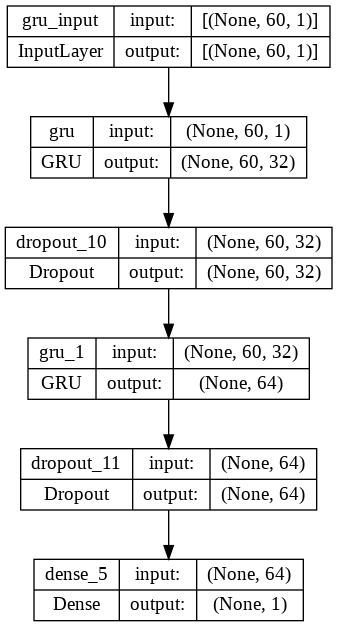

In [ ]:
plot_model(model_gru_high, to_file='model_gru_high.png', show_shapes=True, show_layer_names=True)

In [ ]:
history_gru_high = fit_model(model_gru_high, X_train_high, y_train_high)

Epoch 1/50
59/59 [==============================] - 4s 20ms/step - loss: 0.0037 - val_loss: 0.0036
Epoch 2/50
59/59 [==============================] - 1s 9ms/step - loss: 0.0134 - val_loss: 0.0300
Epoch 3/50
59/59 [==============================] - 1s 9ms/step - loss: 0.0122 - val_loss: 0.0085
Epoch 4/50
59/59 [==============================] - 1s 9ms/step - loss: 0.0034 - val_loss: 6.9955e-04
Epoch 5/50
59/59 [==============================] - 1s 10ms/step - loss: 0.0011 - val_loss: 3.9981e-04
Epoch 6/50
59/59 [==============================] - 1s 9ms/step - loss: 0.0012 - val_loss: 7.0677e-04
Epoch 7/50
59/59 [==============================] - 1s 9ms/step - loss: 0.0012 - val_loss: 7.3111e-04
Epoch 8/50
59/59 [==============================] - 1s 9ms/step - loss: 0.0012 - val_loss: 4.2367e-04
Epoch 9/50
59/59 [==============================] - 1s 9ms/step - loss: 0.0012 - val_loss: 4.8442e-04
Epoch 10/50
59/59 [==============================] - 1s 9ms/step - loss: 0.0010 - val_loss: 

In [ ]:
evaluation_GRU_high = model_gru_high.evaluate(X_test_high, y_test_high)
print(evaluation_GRU_high)

17/17 [==============================] - 0s 5ms/step - loss: 0.0036
0.003552895039319992


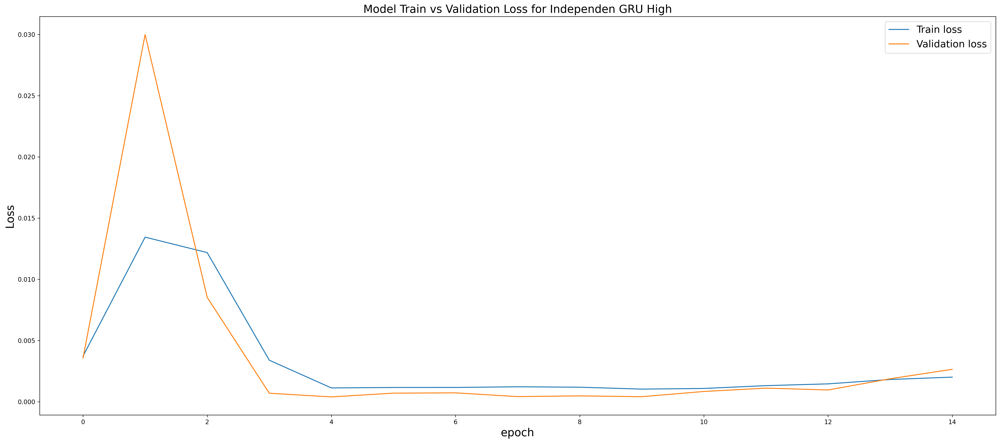

In [ ]:
plot_loss(history_gru_high, 'Independen GRU High') 

17/17 [==============================] - 1s 5ms/step


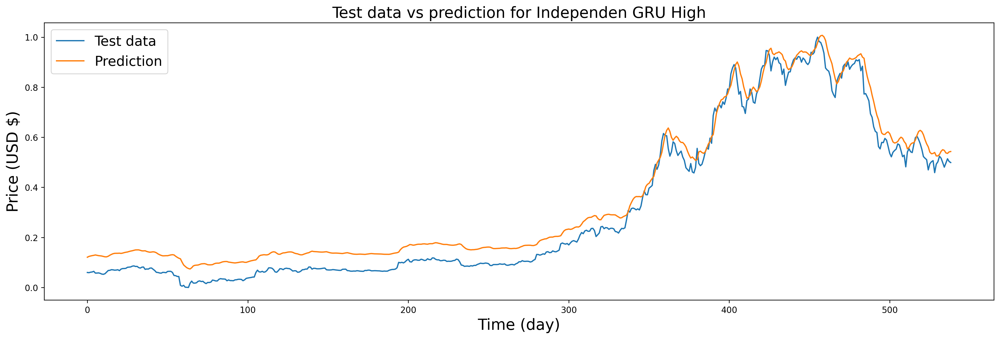

In [ ]:
prediction_gru_high = prediction(model_gru_high, X_test_high)
plot_future(prediction_gru_high, 'Independen GRU High', y_test_high)

In [ ]:
scaler = MinMaxScaler(feature_range=(0,1)).fit(test_dataset_high)
pred_inv_gru_high = scaler.inverse_transform(prediction_gru_high)
print(pred_inv_gru_high)

[[12519.827 ]
 [12712.075 ]
 [12814.369 ]
 [12899.612 ]
 [12967.799 ]
 [13058.204 ]
 [12978.492 ]
 [12897.513 ]
 [12856.545 ]
 [12802.069 ]
 [12706.538 ]
 [12618.727 ]
 [12612.417 ]
 [12750.558 ]
 [12995.681 ]
 [13190.305 ]
 [13355.199 ]
 [13443.821 ]
 [13457.085 ]
 [13459.569 ]
 [13481.737 ]
 [13428.38  ]
 [13503.843 ]
 [13617.729 ]
 [13701.704 ]
 [13763.971 ]
 [13884.368 ]
 [13984.184 ]
 [14058.742 ]
 [14162.865 ]
 [14255.939 ]
 [14267.053 ]
 [14264.363 ]
 [14161.945 ]
 [14037.79  ]
 [14028.531 ]
 [14054.409 ]
 [13893.574 ]
 [13782.372 ]
 [13711.828 ]
 [13755.47  ]
 [13810.903 ]
 [13749.045 ]
 [13587.2295]
 [13322.198 ]
 [13118.065 ]
 [12960.368 ]
 [12852.977 ]
 [12860.73  ]
 [12882.756 ]
 [12881.734 ]
 [12978.112 ]
 [13067.576 ]
 [13122.68  ]
 [13067.702 ]
 [12763.459 ]
 [12506.26  ]
 [12286.861 ]
 [12146.821 ]
 [11373.202 ]
 [10686.4795]
 [10332.94  ]
 [10022.83  ]
 [ 9832.843 ]
 [ 9725.384 ]
 [10009.322 ]
 [10442.217 ]
 [10596.031 ]
 [10636.436 ]
 [10667.207 ]
 [10798.743 ]
 [1093

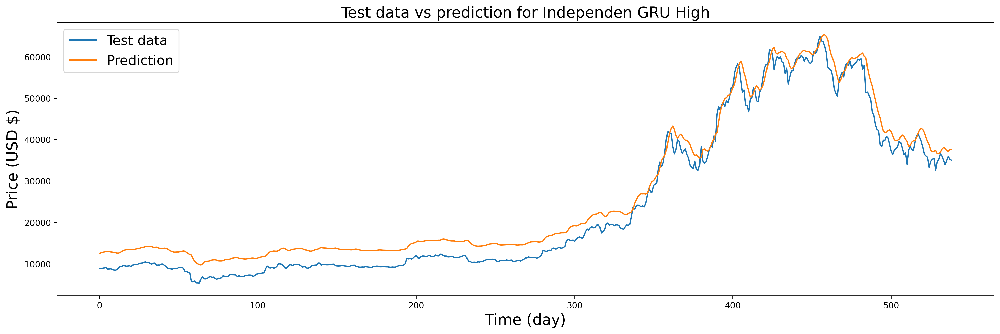

In [ ]:
plot_future(pred_inv_gru_high, 'Independen GRU High', y_test_high_inv)

### Independen GRU Low

In [ ]:
#Independen GRU Low
model_gru_low = create_independen_gru(32, X_train_low)

In [ ]:
print(model_gru_low.summary())

Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru_2 (GRU)                 (None, 60, 32)            3360      
                                                                 
 dropout_12 (Dropout)        (None, 60, 32)            0         
                                                                 
 gru_3 (GRU)                 (None, 64)                18816     
                                                                 
 dropout_13 (Dropout)        (None, 64)                0         
                                                                 
 dense_6 (Dense)             (None, 1)                 65        
                                                                 
Total params: 22,241
Trainable params: 22,241
Non-trainable params: 0
_________________________________________________________________
None


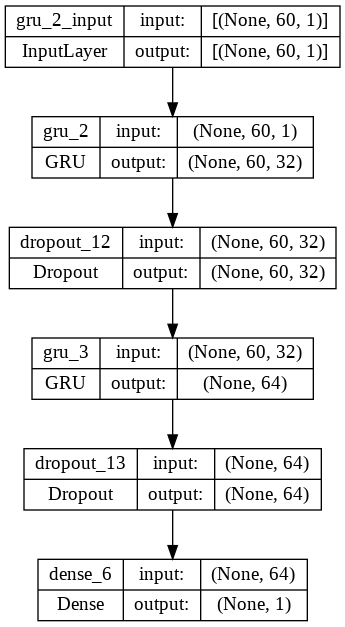

In [ ]:
plot_model(model_gru_low, to_file='model_gru_low.png', show_shapes=True, show_layer_names=True)

In [ ]:
history_gru_low = fit_model(model_gru_low, X_train_low, y_train_low)

Epoch 1/50
59/59 [==============================] - 4s 20ms/step - loss: 0.0068 - val_loss: 0.0175
Epoch 2/50
59/59 [==============================] - 1s 9ms/step - loss: 0.0143 - val_loss: 0.0131
Epoch 3/50
59/59 [==============================] - 1s 9ms/step - loss: 0.0104 - val_loss: 0.0063
Epoch 4/50
59/59 [==============================] - 1s 9ms/step - loss: 0.0035 - val_loss: 9.6878e-04
Epoch 5/50
59/59 [==============================] - 1s 9ms/step - loss: 0.0013 - val_loss: 4.7048e-04
Epoch 6/50
59/59 [==============================] - 1s 9ms/step - loss: 0.0012 - val_loss: 5.6304e-04
Epoch 7/50
59/59 [==============================] - 1s 9ms/step - loss: 0.0013 - val_loss: 4.4461e-04
Epoch 8/50
59/59 [==============================] - 1s 10ms/step - loss: 0.0012 - val_loss: 4.2955e-04
Epoch 9/50
59/59 [==============================] - 1s 9ms/step - loss: 0.0015 - val_loss: 6.2723e-04
Epoch 10/50
59/59 [==============================] - 1s 9ms/step - loss: 0.0013 - val_loss: 

In [ ]:
evaluation_GRU_low = model_gru_low.evaluate(X_test_low, y_test_low)
print(evaluation_GRU_low)

17/17 [==============================] - 0s 4ms/step - loss: 0.0059
0.0058805616572499275


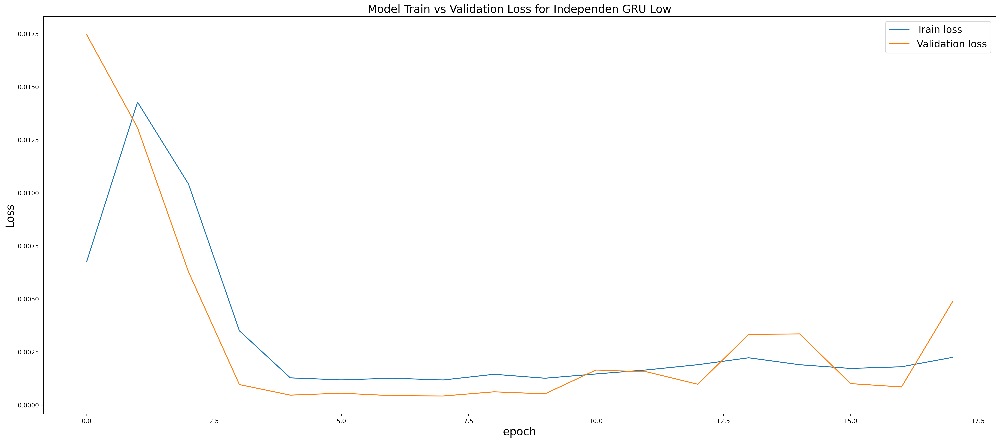

In [ ]:
plot_loss(history_gru_low, 'Independen GRU Low') 

17/17 [==============================] - 1s 4ms/step


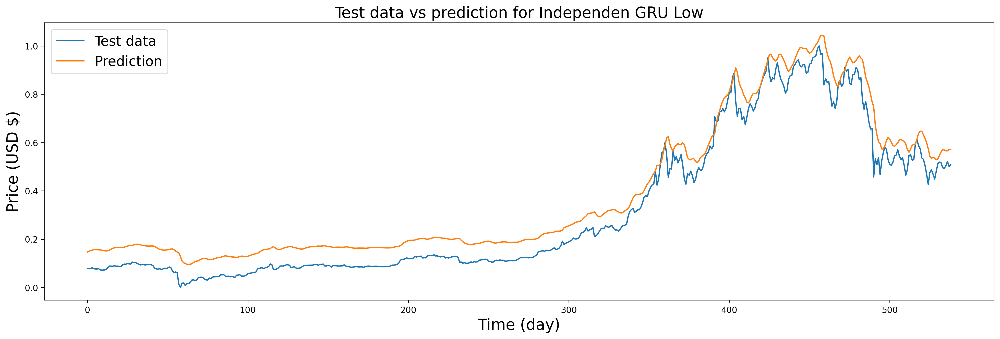

In [ ]:
prediction_gru_low = prediction(model_gru_low, X_test_low)
plot_future(prediction_gru_low, 'Independen GRU Low', y_test_low)

In [ ]:
scaler = MinMaxScaler(feature_range=(0,1)).fit(test_dataset_low)
pred_inv_gru_low = scaler.inverse_transform(prediction_gru_low)

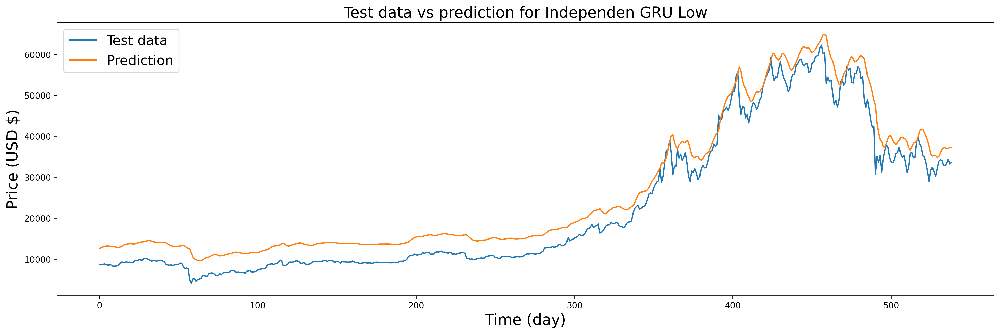

In [ ]:
plot_future(pred_inv_gru_low, 'Independen GRU Low', y_test_low_inv)

### Independen GRU Open

In [ ]:
#Independen GRU Open
model_gru_open = create_independen_gru(32, X_train_open)

In [ ]:
print(model_gru_open.summary())

Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru_4 (GRU)                 (None, 60, 32)            3360      
                                                                 
 dropout_14 (Dropout)        (None, 60, 32)            0         
                                                                 
 gru_5 (GRU)                 (None, 64)                18816     
                                                                 
 dropout_15 (Dropout)        (None, 64)                0         
                                                                 
 dense_7 (Dense)             (None, 1)                 65        
                                                                 
Total params: 22,241
Trainable params: 22,241
Non-trainable params: 0
_________________________________________________________________
None


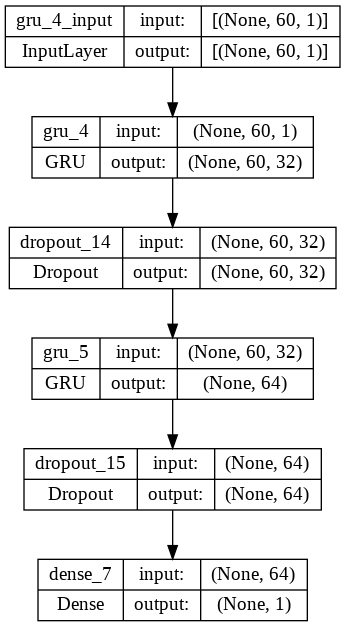

In [ ]:
plot_model(model_gru_open, to_file='model_gru_open.png', show_shapes=True, show_layer_names=True)

In [ ]:
history_gru_open = fit_model(model_gru_open, X_train_open, y_train_open)

Epoch 1/50
59/59 [==============================] - 4s 28ms/step - loss: 0.0059 - val_loss: 0.0098
Epoch 2/50
59/59 [==============================] - 1s 10ms/step - loss: 0.0133 - val_loss: 0.0138
Epoch 3/50
59/59 [==============================] - 1s 9ms/step - loss: 0.0091 - val_loss: 0.0044
Epoch 4/50
59/59 [==============================] - 1s 9ms/step - loss: 0.0023 - val_loss: 0.0044
Epoch 5/50
59/59 [==============================] - 1s 10ms/step - loss: 0.0018 - val_loss: 0.0029
Epoch 6/50
59/59 [==============================] - 1s 9ms/step - loss: 0.0013 - val_loss: 6.4847e-04
Epoch 7/50
59/59 [==============================] - 1s 9ms/step - loss: 0.0012 - val_loss: 5.7588e-04
Epoch 8/50
59/59 [==============================] - 1s 9ms/step - loss: 0.0011 - val_loss: 4.1148e-04
Epoch 9/50
59/59 [==============================] - 1s 9ms/step - loss: 0.0012 - val_loss: 4.2451e-04
Epoch 10/50
59/59 [==============================] - 1s 9ms/step - loss: 0.0011 - val_loss: 3.8174e

In [ ]:
evaluation_GRU_open = model_gru_open.evaluate(X_test_open, y_test_open)
print(evaluation_GRU_open)

17/17 [==============================] - 0s 5ms/step - loss: 0.0015
0.001455815858207643


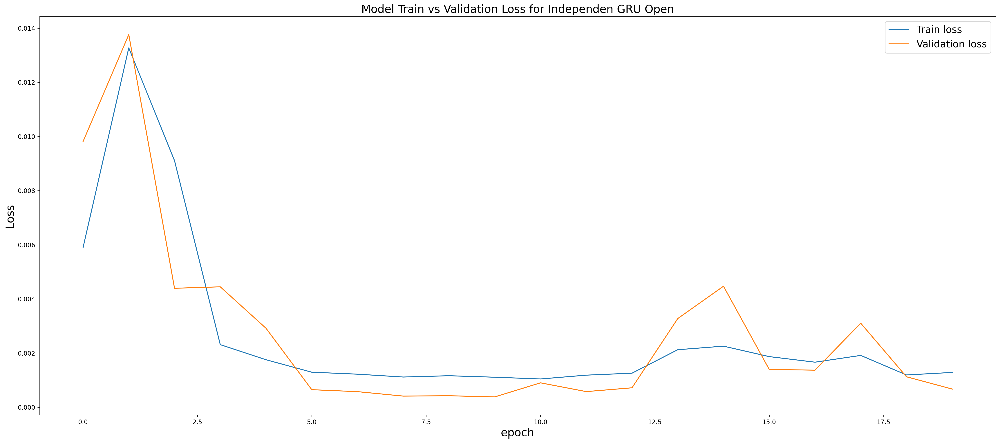

In [ ]:
plot_loss(history_gru_open, 'Independen GRU Open') 

17/17 [==============================] - 1s 4ms/step


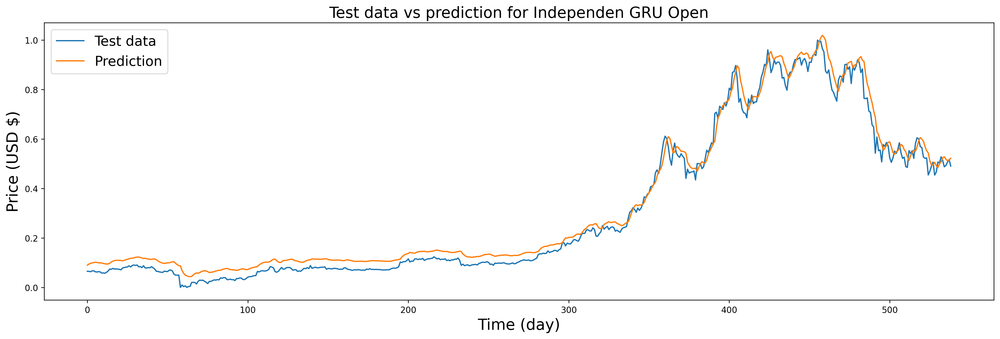

In [ ]:
prediction_gru_open = prediction(model_gru_open, X_test_open)
plot_future(prediction_gru_open, 'Independen GRU Open', y_test_open)

In [ ]:
scaler = MinMaxScaler(feature_range=(0,1)).fit(test_dataset_open)
pred_inv_gru_open = scaler.inverse_transform(prediction_gru_open)

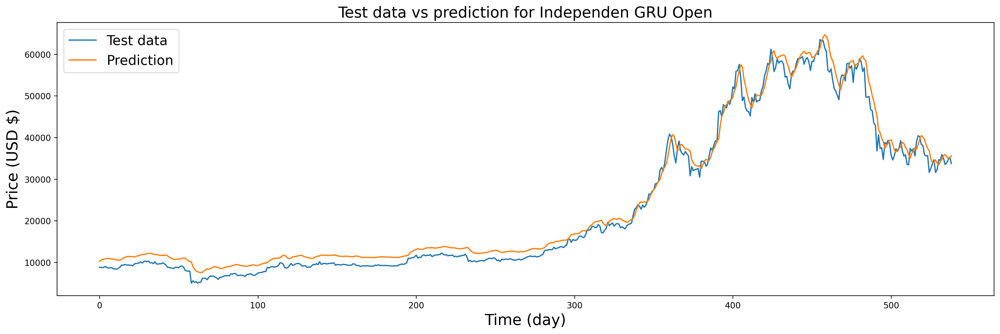

In [ ]:
plot_future(pred_inv_gru_open, 'Independen GRU Open', y_test_open_inv)

### Independen GRU Close

In [ ]:
#Independen GRU Close
model_gru_close = create_independen_gru(32, X_train_close)

In [ ]:
print(model_gru_close.summary())

Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru_6 (GRU)                 (None, 60, 32)            3360      
                                                                 
 dropout_16 (Dropout)        (None, 60, 32)            0         
                                                                 
 gru_7 (GRU)                 (None, 64)                18816     
                                                                 
 dropout_17 (Dropout)        (None, 64)                0         
                                                                 
 dense_8 (Dense)             (None, 1)                 65        
                                                                 
Total params: 22,241
Trainable params: 22,241
Non-trainable params: 0
_________________________________________________________________
None


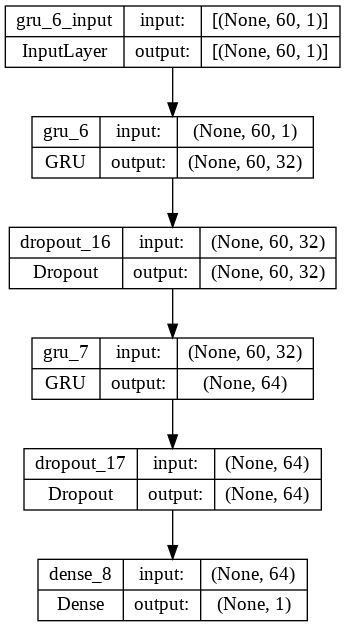

In [ ]:
plot_model(model_gru_close, to_file='model_gru_close.png', show_shapes=True, show_layer_names=True)

In [ ]:
history_gru_close = fit_model(model_gru_close, X_train_close, y_train_close)

Epoch 1/50
59/59 [==============================] - 4s 20ms/step - loss: 0.0077 - val_loss: 0.0235
Epoch 2/50
59/59 [==============================] - 1s 9ms/step - loss: 0.0138 - val_loss: 0.0110
Epoch 3/50
59/59 [==============================] - 1s 9ms/step - loss: 0.0077 - val_loss: 0.0034
Epoch 4/50
59/59 [==============================] - 1s 10ms/step - loss: 0.0023 - val_loss: 0.0028
Epoch 5/50
59/59 [==============================] - 1s 9ms/step - loss: 0.0016 - val_loss: 0.0017
Epoch 6/50
59/59 [==============================] - 1s 9ms/step - loss: 0.0013 - val_loss: 4.1302e-04
Epoch 7/50
59/59 [==============================] - 1s 10ms/step - loss: 0.0010 - val_loss: 6.2668e-04
Epoch 8/50
59/59 [==============================] - 1s 9ms/step - loss: 0.0013 - val_loss: 4.4750e-04
Epoch 9/50
59/59 [==============================] - 1s 9ms/step - loss: 0.0012 - val_loss: 4.1823e-04
Epoch 10/50
59/59 [==============================] - 1s 9ms/step - loss: 0.0011 - val_loss: 4.6230e

In [ ]:
evaluation_GRU_close = model_gru_high.evaluate(X_test_close, y_test_close)
print(evaluation_GRU_close)

17/17 [==============================] - 0s 4ms/step - loss: 0.0036
0.00362967187538743


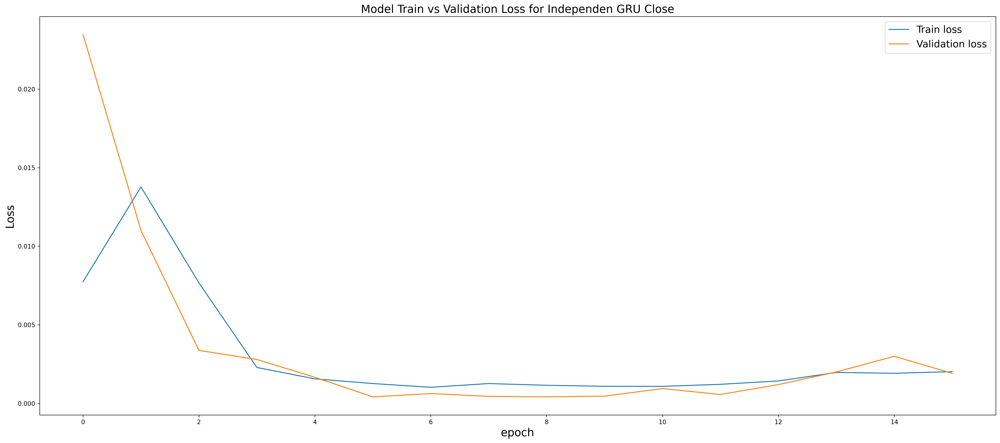

In [ ]:
plot_loss(history_gru_close, 'Independen GRU Close') 

17/17 [==============================] - 1s 5ms/step


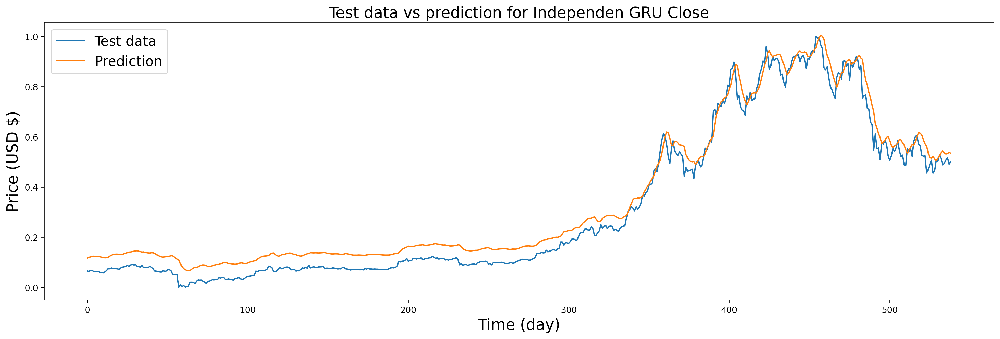

In [ ]:
prediction_gru_close = prediction(model_gru_close, X_test_close)
plot_future(prediction_gru_close, 'Independen GRU Close', y_test_close)

In [ ]:
scaler = MinMaxScaler(feature_range=(0,1)).fit(test_dataset_close)
pred_inv_gru_close = scaler.inverse_transform(prediction_gru_close)

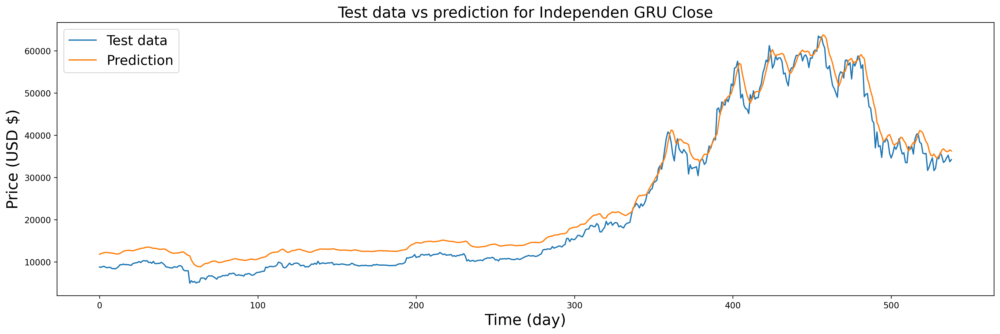

In [ ]:
plot_future(pred_inv_gru_close, 'Independen GRU Close', y_test_close_inv)

### Independen GRU Volume

In [ ]:
#Independen GRU Volume
model_gru_volume = create_independen_gru(32, X_train_volume)

In [ ]:
print(model_gru_volume.summary())

Model: "sequential_9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru_8 (GRU)                 (None, 60, 32)            3360      
                                                                 
 dropout_18 (Dropout)        (None, 60, 32)            0         
                                                                 
 gru_9 (GRU)                 (None, 64)                18816     
                                                                 
 dropout_19 (Dropout)        (None, 64)                0         
                                                                 
 dense_9 (Dense)             (None, 1)                 65        
                                                                 
Total params: 22,241
Trainable params: 22,241
Non-trainable params: 0
_________________________________________________________________
None


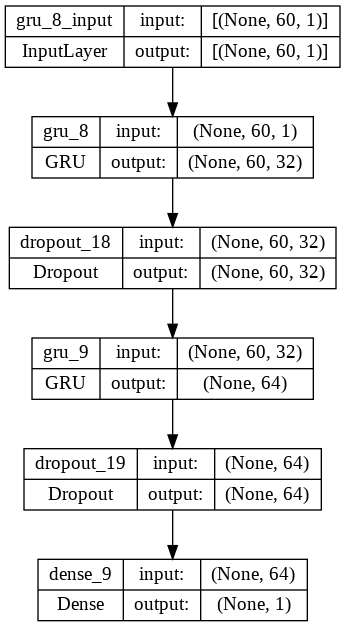

In [ ]:
plot_model(model_gru_volume, to_file='model_gru_volume.png', show_shapes=True, show_layer_names=True)

In [ ]:
history_gru_volume = fit_model(model_gru_volume, X_train_volume, y_train_volume)

Epoch 1/50
59/59 [==============================] - 4s 20ms/step - loss: 0.0018 - val_loss: 0.0106
Epoch 2/50
59/59 [==============================] - 1s 9ms/step - loss: 0.0026 - val_loss: 0.0110
Epoch 3/50
59/59 [==============================] - 1s 9ms/step - loss: 0.0023 - val_loss: 0.0063
Epoch 4/50
59/59 [==============================] - 1s 9ms/step - loss: 0.0012 - val_loss: 0.0047
Epoch 5/50
59/59 [==============================] - 1s 9ms/step - loss: 6.9160e-04 - val_loss: 0.0045
Epoch 6/50
59/59 [==============================] - 1s 9ms/step - loss: 4.6792e-04 - val_loss: 0.0043
Epoch 7/50
59/59 [==============================] - 1s 9ms/step - loss: 5.3187e-04 - val_loss: 0.0044
Epoch 8/50
59/59 [==============================] - 1s 9ms/step - loss: 4.9761e-04 - val_loss: 0.0043
Epoch 9/50
59/59 [==============================] - 1s 9ms/step - loss: 5.2336e-04 - val_loss: 0.0043
Epoch 10/50
59/59 [==============================] - 1s 9ms/step - loss: 4.9606e-04 - val_loss: 0

In [ ]:
evaluation_GRU_volume = model_gru_high.evaluate(X_train_volume, y_train_volume)
print(evaluation_GRU_volume)

73/73 [==============================] - 0s 4ms/step - loss: 0.0056
0.0055793290957808495


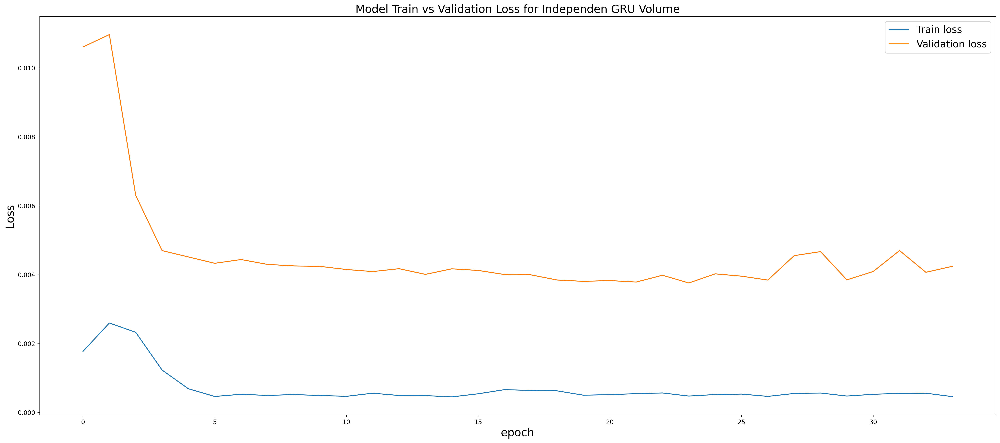

In [ ]:
plot_loss(history_gru_volume, 'Independen GRU Volume') 

17/17 [==============================] - 1s 5ms/step


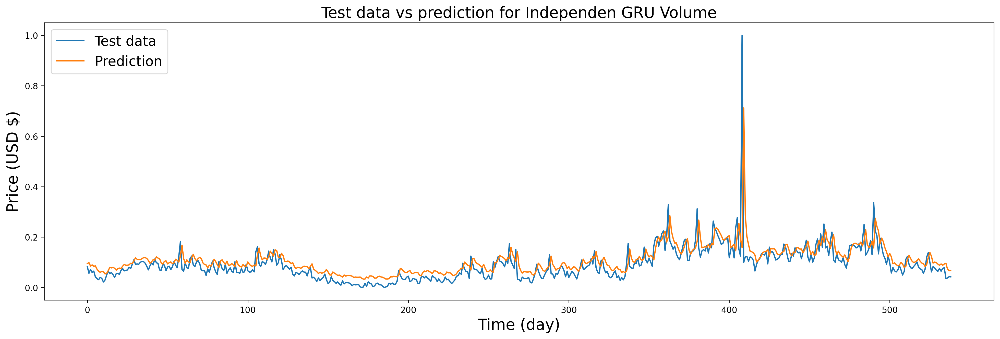

In [ ]:
prediction_gru_volume = prediction(model_gru_volume, X_test_volume)
plot_future(prediction_gru_volume, 'Independen GRU Volume', y_test_volume)

In [ ]:
scaler = MinMaxScaler(feature_range=(0,1)).fit(test_dataset_volume)
pred_inv_gru_volume = scaler.inverse_transform(prediction_gru_volume)

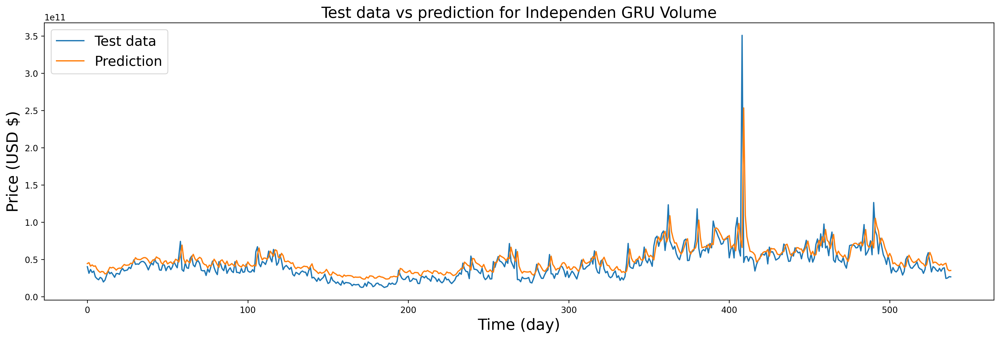

In [ ]:
plot_future(pred_inv_gru_volume, 'Independen GRU Volume', y_test_volume_inv)

### Ukuran Kinerja Model Independen GRU

In [ ]:
mse = mean_squared_error(y_test_high_inv, pred_inv_gru_high, squared=True, multioutput='raw_values')
rmse = mean_squared_error(y_test_high_inv, pred_inv_gru_high, squared=False, multioutput='raw_values')
mae = mean_absolute_error(y_test_high_inv, pred_inv_gru_high, multioutput='raw_values')
mape = mean_absolute_percentage_error(y_test_high_inv, pred_inv_gru_high, multioutput='raw_values')
print('Prediksi Metode Independen GRU High')
print('MSE High = %.4f'%(mse[0]))
print()
print('RMSE High = %.4f'%(rmse[0]))
print()
print('MAE High = %.4f'%(mae[0]))
print()
print('MAPE High = %.4f'%((mape[0])*100), '%')

Prediksi Metode Independen GRU High
MSE High = 12591358.2645

RMSE High = 3548.4304

MAE High = 3288.5958

MAPE High = 26.5300 %


In [ ]:
mse = mean_squared_error(y_test_low_inv, pred_inv_gru_low, squared=True, multioutput='raw_values')
rmse = mean_squared_error(y_test_low_inv, pred_inv_gru_low, squared=False, multioutput='raw_values')
mae = mean_absolute_error(y_test_low_inv, pred_inv_gru_low, multioutput='raw_values')
mape = mean_absolute_percentage_error(y_test_low_inv, pred_inv_gru_low, multioutput='raw_values')
print('Prediksi Metode Independen GRU Low')
print('MSE Low = %.4f'%(mse[0]))
print()
print('RMSE Low = %.4f'%(rmse[0]))
print()
print('MAE Low = %.4f'%(mae[0]))
print()
print('MAPE Low = %.4f'%((mape[0])*100), '%')

Prediksi Metode Independen GRU Low
MSE Low = 19851840.0820

RMSE Low = 4455.5404

MAE Low = 4130.6144

MAPE Low = 32.6691 %


In [ ]:
mse = mean_squared_error(y_test_open_inv, pred_inv_gru_open, squared=True, multioutput='raw_values')
rmse = mean_squared_error(y_test_open_inv, pred_inv_gru_open, squared=False, multioutput='raw_values')
mae = mean_absolute_error(y_test_open_inv, pred_inv_gru_open, multioutput='raw_values')
mape = mean_absolute_percentage_error(y_test_open_inv, pred_inv_gru_open, multioutput='raw_values')
print('Prediksi Metode Independen GRU Open')
print('MSE Open = %.4f'%(mse[0]))
print()
print('RMSE Open = %.4f'%(rmse[0]))
print()
print('MAE Open = %.4f'%(mae[0]))
print()
print('MAPE Open = %.4f'%((mape[0])*100), '%')

Prediksi Metode Independen GRU Open
MSE Open = 4985772.1824

RMSE Open = 2232.8843

MAE Open = 1929.3846

MAPE Open = 14.3104 %


In [ ]:
mse = mean_squared_error(y_test_close_inv, pred_inv_gru_close, squared=True, multioutput='raw_values')
rmse = mean_squared_error(y_test_close_inv, pred_inv_gru_close, squared=False, multioutput='raw_values')
mae = mean_absolute_error(y_test_close_inv, pred_inv_gru_close, multioutput='raw_values')
mape = mean_absolute_percentage_error(y_test_close_inv, pred_inv_gru_close, multioutput='raw_values')
print('Prediksi Metode Independen GRU Close')
print('MSE Close = %.4f'%(mse[0]))
print()
print('RMSE Close = %.4f'%(rmse[0]))
print()
print('MAE Close = %.4f'%(mae[0]))
print()
print('MAPE Close = %.4f'%((mape[0])*100), '%')

Prediksi Metode Independen GRU Close
MSE Close = 9594779.9286

RMSE Close = 3097.5442

MAE Close = 2817.8714

MAPE Close = 22.9387 %


In [ ]:
mse = mean_squared_error(y_test_volume_inv, pred_inv_gru_volume, squared=True, multioutput='raw_values')
rmse = mean_squared_error(y_test_volume_inv, pred_inv_gru_volume, squared=False, multioutput='raw_values')
mae = mean_absolute_error(y_test_volume_inv, pred_inv_gru_volume, multioutput='raw_values')
mape = mean_absolute_percentage_error(y_test_volume_inv, pred_inv_gru_volume, multioutput='raw_values')
print('Prediksi Metode Independen GRU Volume')
print('MSE Volume = %.4f'%(mse[0]))
print()
print('RMSE Volume = %.4f'%(rmse[0]))
print()
print('MAE Volume = %.4f'%(mae[0]))
print()
print('MAPE Volume = %.4f'%((mape[0])*100), '%')

Prediksi Metode Independen GRU Volume
MSE Volume = 381771264357101862912.0000

RMSE Volume = 19538967842.6754

MAE Volume = 10786469118.6973

MAPE Volume = 29.5729 %


### Prediksi H+1 Independen GRU

#### GRU High

In [ ]:
scaler = MinMaxScaler(feature_range=(0,1)).fit(test_dataset_high)
y_high_inde_gru = model_gru_high.predict(data_pred_high)
yhat_high_gru = y_high_inde_gru
nextday_pred_high_gru = np.hstack(y_high_inde_gru).reshape(-1,1)
nextday_pred_high_gru2 = scaler.inverse_transform(nextday_pred_high_gru)
print('Next day prediction Independen GRU High =  %.3f'%(nextday_pred_high_gru2))

1/1 [==============================] - 0s 17ms/step
Next day prediction Independen GRU High =  39894.449


In [ ]:
nextday_pred_high_gru

array([[0.5805792]], dtype=float32)

#### GRU Low

In [ ]:
scaler = MinMaxScaler(feature_range=(0,1)).fit(test_dataset_low)
y_low_inde_gru = model_gru_low.predict(data_pred_low)
yhat_low_gru = y_low_inde_gru
nextday_pred_low_gru = np.hstack(y_low_inde_gru).reshape(-1,1)
nextday_pred_low_gru2 = scaler.inverse_transform(nextday_pred_low_gru)
print('Next day prediction Independen GRU Low =  %.3f'%(nextday_pred_low_gru2))

1/1 [==============================] - 0s 16ms/step
Next day prediction Independen GRU Low =  39152.461


In [ ]:
nextday_pred_low_gru

array([[0.6031718]], dtype=float32)

#### GRU Open

In [ ]:
scaler = MinMaxScaler(feature_range=(0,1)).fit(test_dataset_open)
y_open_inde_gru = model_gru_open.predict(data_pred_open)
yhat_open_gru = y_open_inde_gru
nextday_pred_open_gru = np.hstack(y_open_inde_gru).reshape(-1,1)
nextday_pred_open_gru2 = scaler.inverse_transform(nextday_pred_open_gru)
print('Next day prediction Independen GRU Open =  %.3f'%(nextday_pred_open_gru2))

1/1 [==============================] - 0s 16ms/step
Next day prediction Independen GRU Open =  37503.910


In [ ]:
nextday_pred_open_gru

array([[0.5553773]], dtype=float32)

#### GRU Close

In [ ]:
scaler = MinMaxScaler(feature_range=(0,1)).fit(test_dataset_close)
y_close_inde_gru = model_gru_close.predict(data_pred_close)
yhat_close_gru = y_close_inde_gru
nextday_pred_close_gru = np.hstack(y_close_inde_gru).reshape(-1,1)
nextday_pred_close_gru2 = scaler.inverse_transform(nextday_pred_close_gru)
print('Next day prediction Independen GRU Close =  %.3f'%(nextday_pred_close_gru2))

1/1 [==============================] - 0s 16ms/step
Next day prediction Independen GRU Close =  38340.758


In [ ]:
nextday_pred_close_gru

array([[0.5701084]], dtype=float32)

#### GRU Volume

In [ ]:
scaler = MinMaxScaler(feature_range=(0,1)).fit(test_dataset_volume)
y_volume_inde_gru = model_gru_volume.predict(data_pred_volume)
yhat_volume_gru = y_volume_inde_gru
nextday_pred_volume_gru = np.hstack(y_volume_inde_gru).reshape(-1,1)
nextday_pred_volume_gru2 = scaler.inverse_transform(nextday_pred_volume_gru)
print('Next day prediction Independen GRU Volume =  %.3f'%(nextday_pred_volume_gru2))

1/1 [==============================] - 0s 16ms/step
Next day prediction Independen GRU Volume =  44700413952.000


In [ ]:
nextday_pred_volume_gru

array([[0.0957967]], dtype=float32)

## Model Independen BiLSTM

In [ ]:
# Create Independen BiLSTM model
def create_independen_bilstm(units, x_train):
    model = Sequential()
    # Input layer
    model.add(Bidirectional(LSTM(units = units, return_sequences=True), 
              input_shape = ([x_train.shape[1], x_train.shape[2]])))
    model.add(Dropout(0.3))
    # Hidden layer
    model.add(Bidirectional(LSTM(units = units*2)))
    model.add(Dropout(0.3))
    # Output Layer
    model.add(Dense(units = 1))
    #Compile model
    model.compile(optimizer='adam', loss='mse')
    return model

### Independen BiLSTM High

In [ ]:
# Independen BiLSTM High
model_bilstm_high = create_independen_bilstm(32, X_train_high)

In [ ]:
print(model_bilstm_high.summary())

Model: "sequential_10"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 bidirectional (Bidirectiona  (None, 60, 64)           8704      
 l)                                                              
                                                                 
 dropout_20 (Dropout)        (None, 60, 64)            0         
                                                                 
 bidirectional_1 (Bidirectio  (None, 128)              66048     
 nal)                                                            
                                                                 
 dropout_21 (Dropout)        (None, 128)               0         
                                                                 
 dense_10 (Dense)            (None, 1)                 129       
                                                                 
Total params: 74,881
Trainable params: 74,881
Non-tra

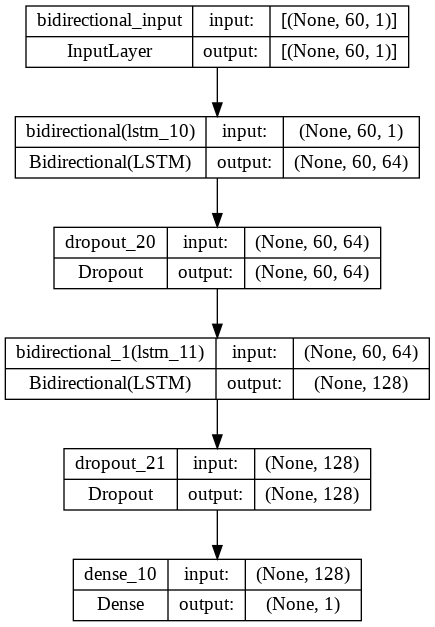

In [ ]:
plot_model(model_bilstm_high, to_file='model_bilstm_high.png', show_shapes=True, show_layer_names=True)

In [ ]:
history_bilstm_high = fit_model(model_bilstm_high, X_train_high, y_train_high)

Epoch 1/50
59/59 [==============================] - 8s 39ms/step - loss: 0.0055 - val_loss: 0.0299
Epoch 2/50
59/59 [==============================] - 1s 16ms/step - loss: 0.0152 - val_loss: 0.0278
Epoch 3/50
59/59 [==============================] - 1s 16ms/step - loss: 0.0088 - val_loss: 0.0115
Epoch 4/50
59/59 [==============================] - 1s 16ms/step - loss: 0.0030 - val_loss: 0.0049
Epoch 5/50
59/59 [==============================] - 1s 16ms/step - loss: 0.0033 - val_loss: 0.0065
Epoch 6/50
59/59 [==============================] - 1s 16ms/step - loss: 0.0018 - val_loss: 9.7818e-04
Epoch 7/50
59/59 [==============================] - 1s 17ms/step - loss: 0.0017 - val_loss: 0.0027
Epoch 8/50
59/59 [==============================] - 1s 16ms/step - loss: 0.0015 - val_loss: 0.0013
Epoch 9/50
59/59 [==============================] - 1s 16ms/step - loss: 0.0013 - val_loss: 0.0018
Epoch 10/50
59/59 [==============================] - 1s 16ms/step - loss: 0.0012 - val_loss: 6.9233e-04
E

In [ ]:
evaluation_BiLSTM_high = model_bilstm_high.evaluate(X_test_high, y_test_high)
print(evaluation_BiLSTM_high)

17/17 [==============================] - 0s 7ms/step - loss: 0.0016
0.001613796572200954


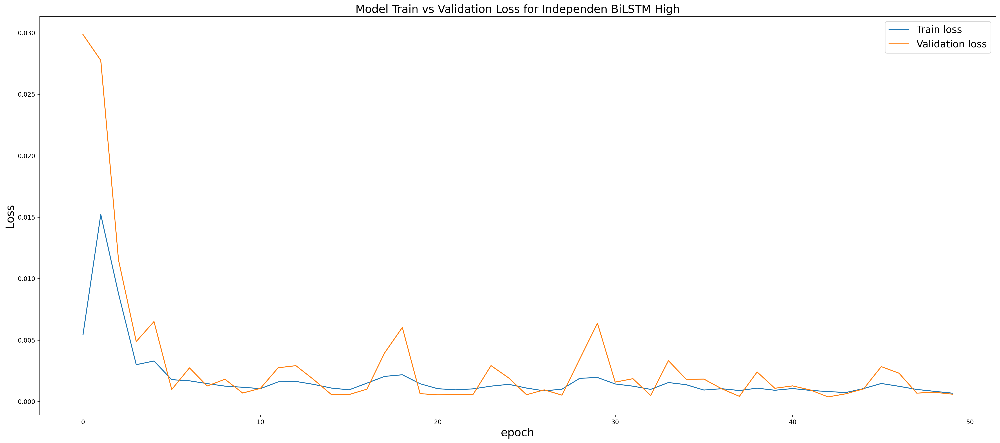

In [ ]:
plot_loss(history_bilstm_high, 'Independen BiLSTM High') 

17/17 [==============================] - 1s 7ms/step


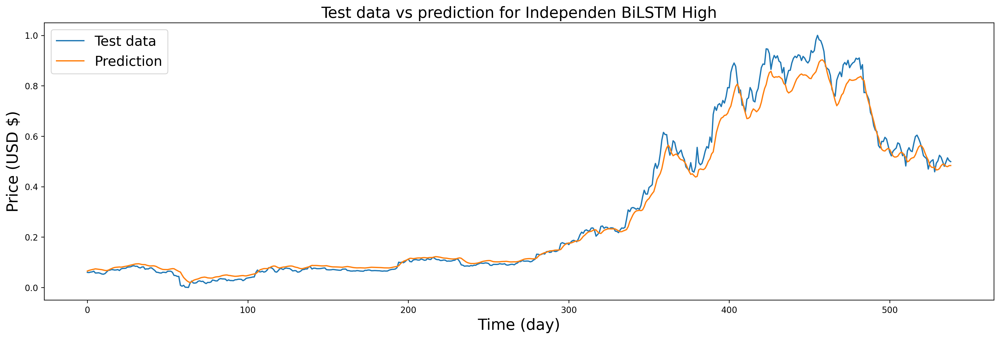

In [ ]:
prediction_bilstm_high = prediction(model_bilstm_high, X_test_high)
plot_future(prediction_bilstm_high, 'Independen BiLSTM High', y_test_high)

In [ ]:
scaler = MinMaxScaler(feature_range=(0,1)).fit(test_dataset_high)
pred_inv_bilstm_high = scaler.inverse_transform(prediction_bilstm_high)

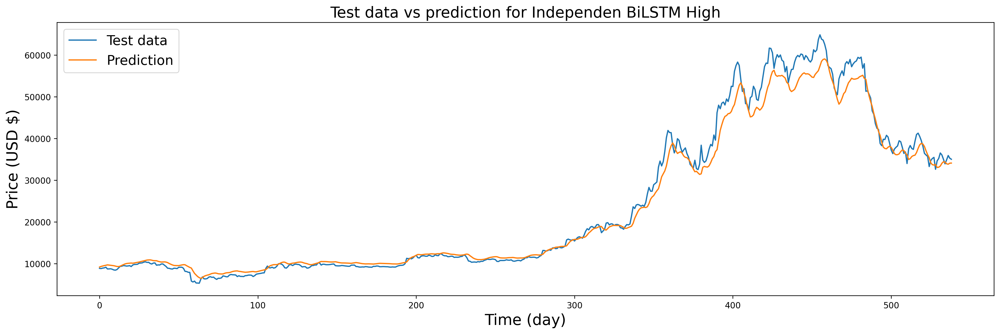

In [ ]:
plot_future(pred_inv_bilstm_high, 'Independen BiLSTM High', y_test_high_inv)

### Independen BiLSTM Low

In [ ]:
# Independen BiLSTM Low
model_bilstm_low = create_independen_bilstm(32, X_train_low)

In [ ]:
print(model_bilstm_low.summary())

Model: "sequential_11"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 bidirectional_2 (Bidirectio  (None, 60, 64)           8704      
 nal)                                                            
                                                                 
 dropout_22 (Dropout)        (None, 60, 64)            0         
                                                                 
 bidirectional_3 (Bidirectio  (None, 128)              66048     
 nal)                                                            
                                                                 
 dropout_23 (Dropout)        (None, 128)               0         
                                                                 
 dense_11 (Dense)            (None, 1)                 129       
                                                                 
Total params: 74,881
Trainable params: 74,881
Non-tra

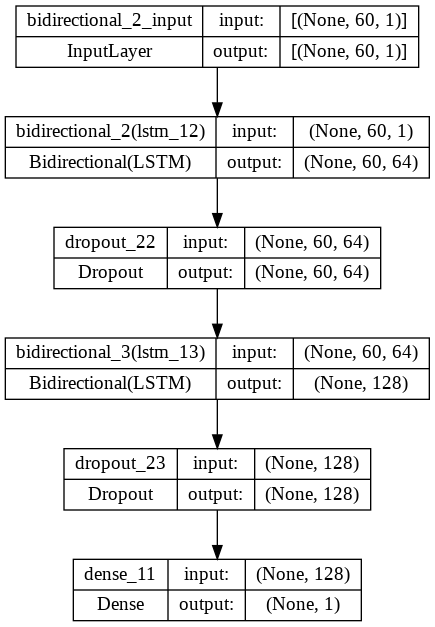

In [ ]:
plot_model(model_bilstm_low, to_file='model_bilstm_low.png', show_shapes=True, show_layer_names=True)

In [ ]:
history_bilstm_low = fit_model(model_bilstm_low, X_train_low, y_train_low)

Epoch 1/50
59/59 [==============================] - 7s 38ms/step - loss: 0.0085 - val_loss: 0.0337
Epoch 2/50
59/59 [==============================] - 1s 16ms/step - loss: 0.0148 - val_loss: 0.0254
Epoch 3/50
59/59 [==============================] - 1s 16ms/step - loss: 0.0087 - val_loss: 0.0073
Epoch 4/50
59/59 [==============================] - 1s 16ms/step - loss: 0.0037 - val_loss: 0.0075
Epoch 5/50
59/59 [==============================] - 1s 16ms/step - loss: 0.0044 - val_loss: 0.0067
Epoch 6/50
59/59 [==============================] - 1s 16ms/step - loss: 0.0029 - val_loss: 0.0031
Epoch 7/50
59/59 [==============================] - 1s 16ms/step - loss: 0.0027 - val_loss: 0.0055
Epoch 8/50
59/59 [==============================] - 1s 16ms/step - loss: 0.0021 - val_loss: 0.0037
Epoch 9/50
59/59 [==============================] - 1s 16ms/step - loss: 0.0027 - val_loss: 0.0065
Epoch 10/50
59/59 [==============================] - 1s 16ms/step - loss: 0.0020 - val_loss: 0.0045
Epoch 11/

In [ ]:
evaluation_BiLSTM_low = model_bilstm_low.evaluate(X_test_low, y_test_low)
print(evaluation_BiLSTM_low)

17/17 [==============================] - 0s 7ms/step - loss: 0.0040
0.004011231008917093


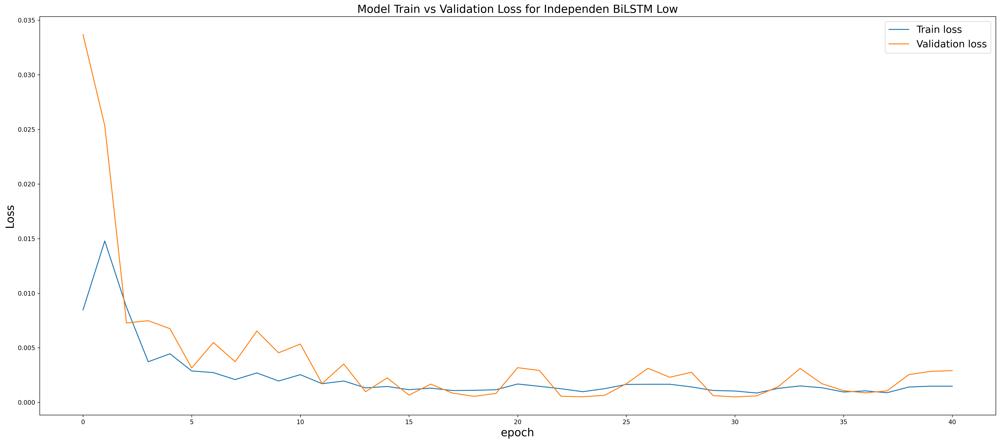

In [ ]:
plot_loss(history_bilstm_low, 'Independen BiLSTM Low') 

17/17 [==============================] - 1s 7ms/step


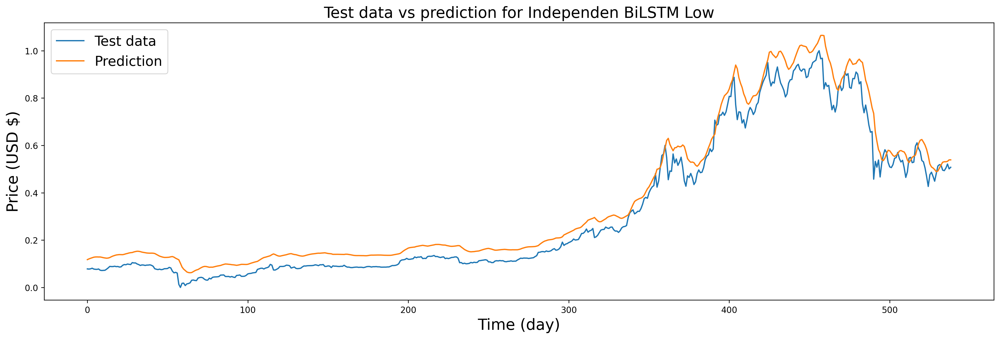

In [ ]:
prediction_bilstm_low = prediction(model_bilstm_low, X_test_low)
plot_future(prediction_bilstm_low, 'Independen BiLSTM Low', y_test_low)

In [ ]:
scaler = MinMaxScaler(feature_range=(0,1)).fit(test_dataset_low)
pred_inv_bilstm_low = scaler.inverse_transform(prediction_bilstm_low)

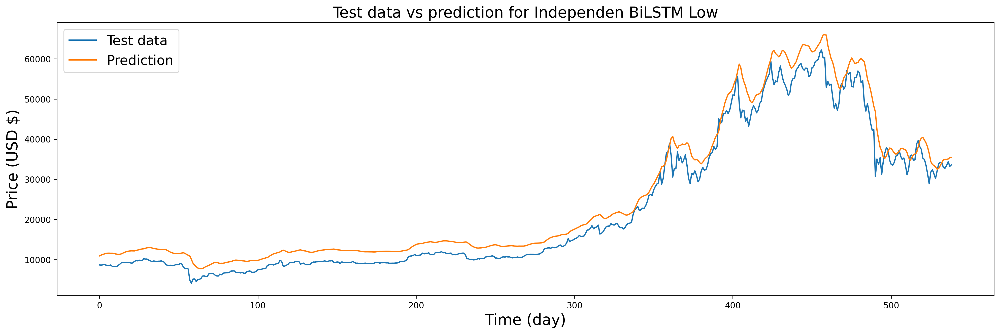

In [ ]:
plot_future(pred_inv_bilstm_low, 'Independen BiLSTM Low', y_test_low_inv)

### Independen BiLSTM Open

In [ ]:
# Independen BiLSTM Open
model_bilstm_open = create_independen_bilstm(32, X_train_open)

In [ ]:
print(model_bilstm_open.summary())

Model: "sequential_12"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 bidirectional_4 (Bidirectio  (None, 60, 64)           8704      
 nal)                                                            
                                                                 
 dropout_24 (Dropout)        (None, 60, 64)            0         
                                                                 
 bidirectional_5 (Bidirectio  (None, 128)              66048     
 nal)                                                            
                                                                 
 dropout_25 (Dropout)        (None, 128)               0         
                                                                 
 dense_12 (Dense)            (None, 1)                 129       
                                                                 
Total params: 74,881
Trainable params: 74,881
Non-tra

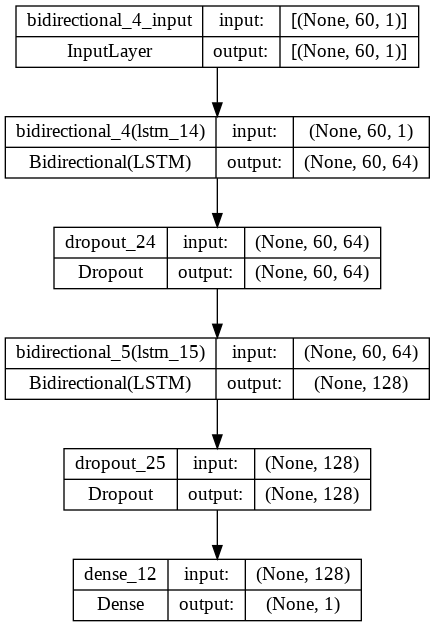

In [ ]:
plot_model(model_bilstm_open, to_file='model_bilstm_open.png', show_shapes=True, show_layer_names=True)

In [ ]:
history_bilstm_open = fit_model(model_bilstm_open, X_train_open, y_train_open)

Epoch 1/50
59/59 [==============================] - 8s 38ms/step - loss: 0.0071 - val_loss: 0.0369
Epoch 2/50
59/59 [==============================] - 1s 16ms/step - loss: 0.0186 - val_loss: 0.0283
Epoch 3/50
59/59 [==============================] - 1s 16ms/step - loss: 0.0069 - val_loss: 0.0018
Epoch 4/50
59/59 [==============================] - 1s 21ms/step - loss: 0.0027 - val_loss: 0.0032
Epoch 5/50
59/59 [==============================] - 1s 23ms/step - loss: 0.0020 - val_loss: 0.0018
Epoch 6/50
59/59 [==============================] - 1s 22ms/step - loss: 0.0029 - val_loss: 0.0050
Epoch 7/50
59/59 [==============================] - 1s 16ms/step - loss: 0.0018 - val_loss: 9.3931e-04
Epoch 8/50
59/59 [==============================] - 1s 16ms/step - loss: 0.0016 - val_loss: 8.1360e-04
Epoch 9/50
59/59 [==============================] - 1s 16ms/step - loss: 0.0016 - val_loss: 0.0020
Epoch 10/50
59/59 [==============================] - 1s 16ms/step - loss: 0.0014 - val_loss: 8.3728e-

In [ ]:
evaluation_BiLSTM_open = model_bilstm_open.evaluate(X_test_open, y_test_open)
print(evaluation_BiLSTM_open)

17/17 [==============================] - 0s 7ms/step - loss: 9.7686e-04
0.0009768586605787277


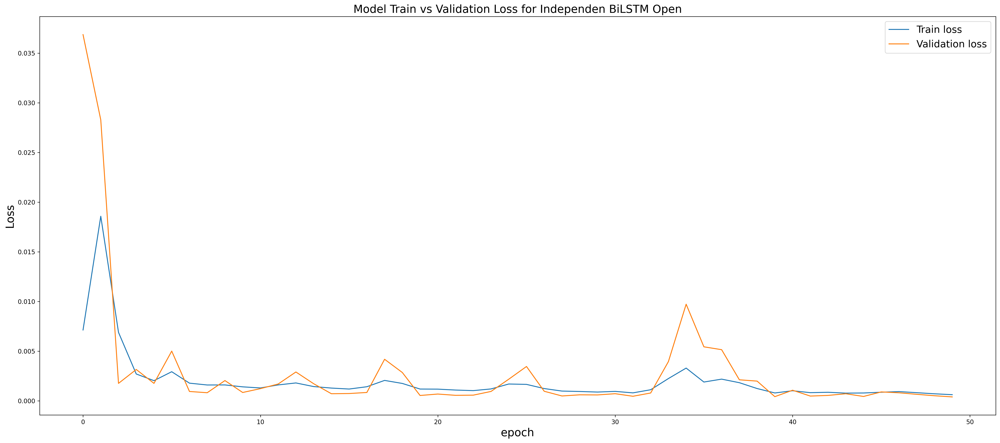

In [ ]:
plot_loss(history_bilstm_open, 'Independen BiLSTM Open') 

17/17 [==============================] - 1s 8ms/step


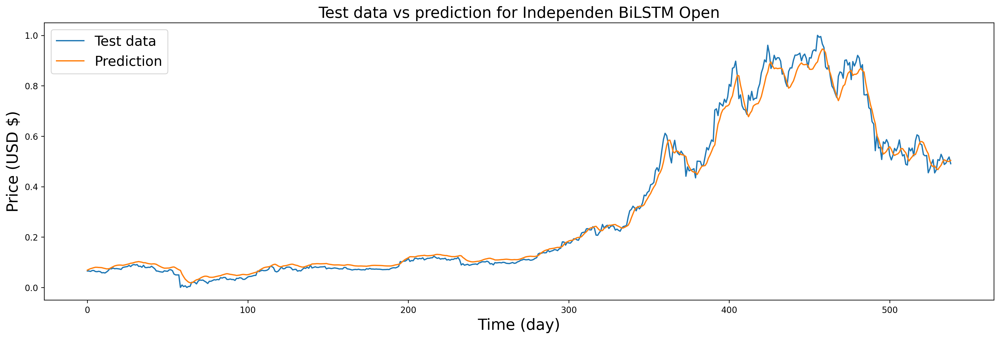

In [ ]:
prediction_bilstm_open = prediction(model_bilstm_open, X_test_open)
plot_future(prediction_bilstm_open, 'Independen BiLSTM Open', y_test_open)

In [ ]:
scaler = MinMaxScaler(feature_range=(0,1)).fit(test_dataset_open)
pred_inv_bilstm_open = scaler.inverse_transform(prediction_bilstm_open)

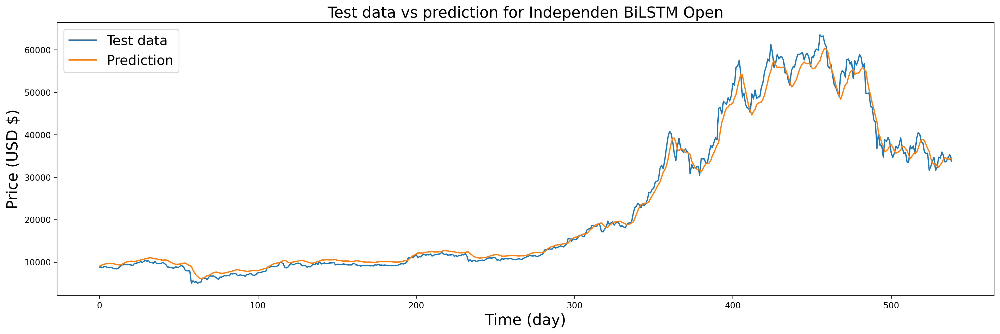

In [ ]:
plot_future(pred_inv_bilstm_open, 'Independen BiLSTM Open', y_test_open_inv)

### Independen BiLSTM Close

In [ ]:
# Independen BiLSTM Close
model_bilstm_close = create_independen_bilstm(32, X_train_close)

In [ ]:
print(model_bilstm_close.summary())

Model: "sequential_13"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 bidirectional_6 (Bidirectio  (None, 60, 64)           8704      
 nal)                                                            
                                                                 
 dropout_26 (Dropout)        (None, 60, 64)            0         
                                                                 
 bidirectional_7 (Bidirectio  (None, 128)              66048     
 nal)                                                            
                                                                 
 dropout_27 (Dropout)        (None, 128)               0         
                                                                 
 dense_13 (Dense)            (None, 1)                 129       
                                                                 
Total params: 74,881
Trainable params: 74,881
Non-tra

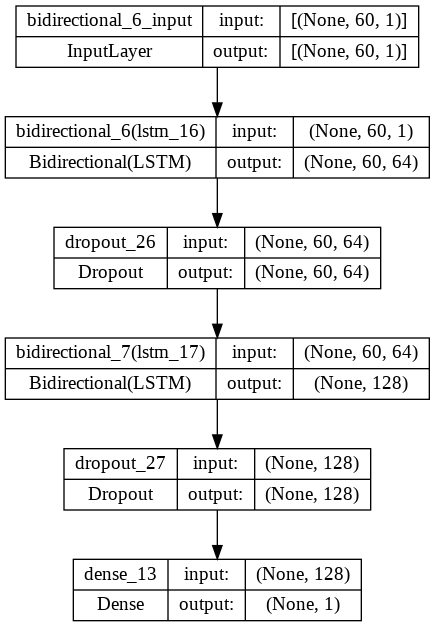

In [ ]:
plot_model(model_bilstm_close, to_file='model_bilstm_close.png', show_shapes=True, show_layer_names=True)

In [ ]:
history_bilstm_close = fit_model(model_bilstm_close, X_train_close, y_train_close)

Epoch 1/50
59/59 [==============================] - 7s 38ms/step - loss: 0.0079 - val_loss: 0.0290
Epoch 2/50
59/59 [==============================] - 1s 16ms/step - loss: 0.0176 - val_loss: 0.0286
Epoch 3/50
59/59 [==============================] - 1s 16ms/step - loss: 0.0078 - val_loss: 0.0032
Epoch 4/50
59/59 [==============================] - 1s 16ms/step - loss: 0.0021 - val_loss: 0.0013
Epoch 5/50
59/59 [==============================] - 1s 16ms/step - loss: 0.0021 - val_loss: 0.0019
Epoch 6/50
59/59 [==============================] - 1s 16ms/step - loss: 0.0025 - val_loss: 0.0034
Epoch 7/50
59/59 [==============================] - 1s 16ms/step - loss: 0.0018 - val_loss: 0.0026
Epoch 8/50
59/59 [==============================] - 1s 16ms/step - loss: 0.0016 - val_loss: 0.0018
Epoch 9/50
59/59 [==============================] - 1s 16ms/step - loss: 0.0015 - val_loss: 0.0013
Epoch 10/50
59/59 [==============================] - 1s 16ms/step - loss: 0.0017 - val_loss: 0.0017
Epoch 11/

In [ ]:
evaluation_BiLSTM_close = model_bilstm_close.evaluate(X_test_close, y_test_close)
print(evaluation_BiLSTM_close)

17/17 [==============================] - 0s 9ms/step - loss: 0.0012
0.0012066239723935723


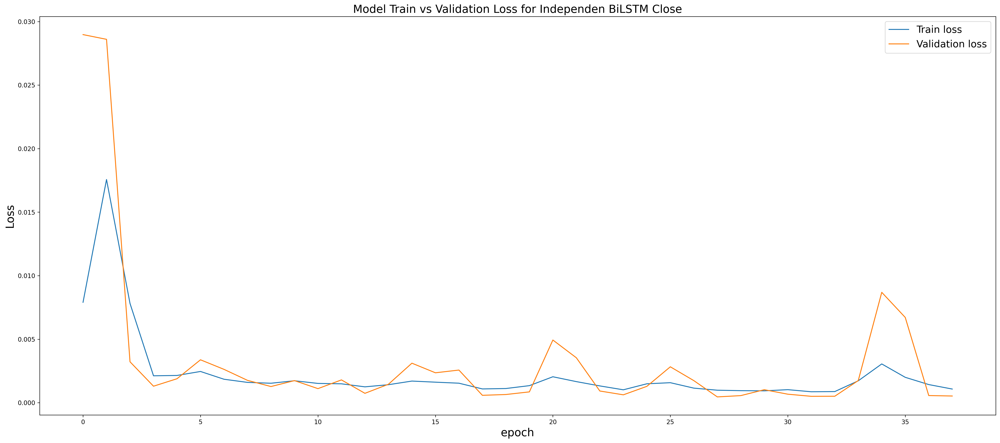

In [ ]:
plot_loss(history_bilstm_close, 'Independen BiLSTM Close') 

17/17 [==============================] - 1s 7ms/step


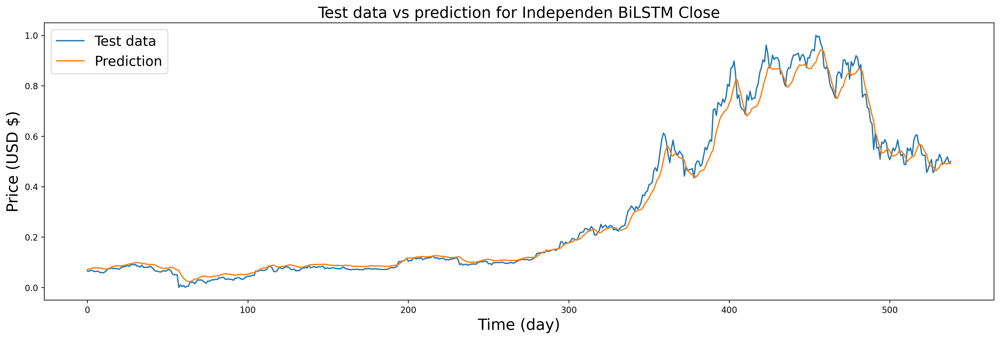

In [ ]:
prediction_bilstm_close = prediction(model_bilstm_close, X_test_close)
plot_future(prediction_bilstm_close, 'Independen BiLSTM Close', y_test_close)

In [ ]:
scaler = MinMaxScaler(feature_range=(0,1)).fit(test_dataset_close)
pred_inv_bilstm_close = scaler.inverse_transform(prediction_bilstm_close)

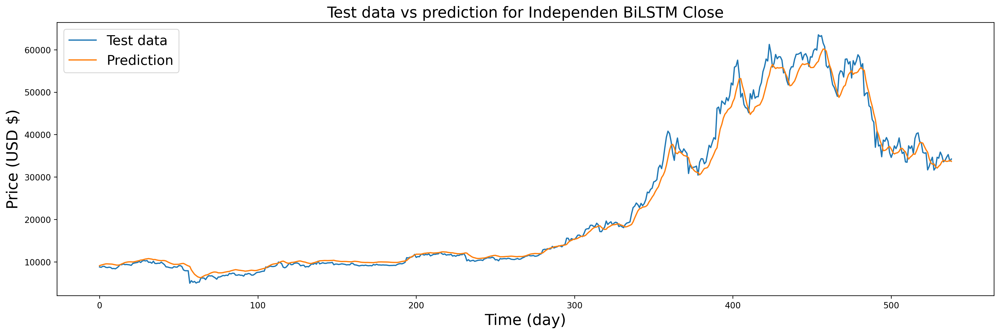

In [ ]:
plot_future(pred_inv_bilstm_close, 'Independen BiLSTM Close', y_test_close_inv)

### Independen BiLSTM Volume

In [ ]:
# Independen BiLSTM Volume
model_bilstm_volume = create_independen_bilstm(32, X_train_volume)

In [ ]:
print(model_bilstm_volume.summary())

Model: "sequential_14"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 bidirectional_8 (Bidirectio  (None, 60, 64)           8704      
 nal)                                                            
                                                                 
 dropout_28 (Dropout)        (None, 60, 64)            0         
                                                                 
 bidirectional_9 (Bidirectio  (None, 128)              66048     
 nal)                                                            
                                                                 
 dropout_29 (Dropout)        (None, 128)               0         
                                                                 
 dense_14 (Dense)            (None, 1)                 129       
                                                                 
Total params: 74,881
Trainable params: 74,881
Non-tra

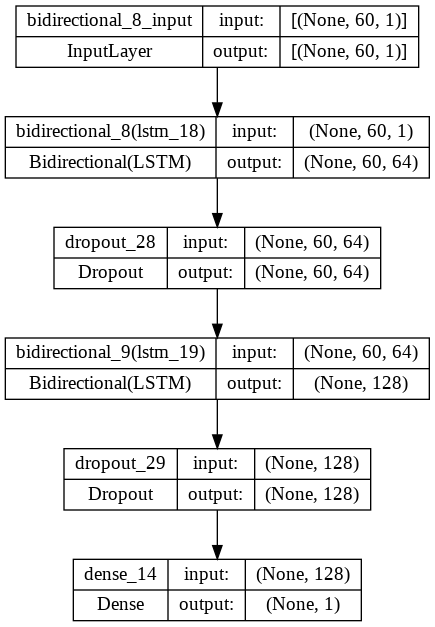

In [ ]:
plot_model(model_bilstm_volume, to_file='model_bilstm_volume.png', show_shapes=True, show_layer_names=True)

In [ ]:
history_bilstm_volume = fit_model(model_bilstm_volume, X_train_volume, y_train_volume)

Epoch 1/50
59/59 [==============================] - 8s 39ms/step - loss: 0.0016 - val_loss: 0.0292
Epoch 2/50
59/59 [==============================] - 1s 16ms/step - loss: 0.0033 - val_loss: 0.0098
Epoch 3/50
59/59 [==============================] - 1s 16ms/step - loss: 0.0024 - val_loss: 0.0093
Epoch 4/50
59/59 [==============================] - 1s 16ms/step - loss: 0.0016 - val_loss: 0.0081
Epoch 5/50
59/59 [==============================] - 1s 16ms/step - loss: 7.1086e-04 - val_loss: 0.0093
Epoch 6/50
59/59 [==============================] - 1s 16ms/step - loss: 0.0010 - val_loss: 0.0070
Epoch 7/50
59/59 [==============================] - 1s 16ms/step - loss: 8.3784e-04 - val_loss: 0.0097
Epoch 8/50
59/59 [==============================] - 1s 16ms/step - loss: 0.0010 - val_loss: 0.0064
Epoch 9/50
59/59 [==============================] - 1s 16ms/step - loss: 7.7415e-04 - val_loss: 0.0060
Epoch 10/50
59/59 [==============================] - 1s 16ms/step - loss: 6.3694e-04 - val_loss: 

In [ ]:
evaluation_BiLSTM_volume = model_bilstm_volume.evaluate(X_test_volume, y_test_volume)
print(evaluation_BiLSTM_volume)

17/17 [==============================] - 0s 7ms/step - loss: 0.0033
0.0032634164672344923


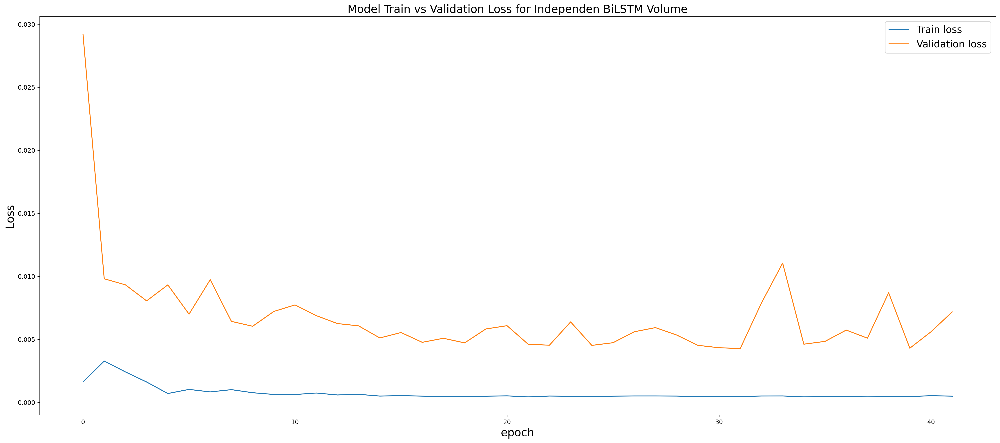

In [ ]:
plot_loss(history_bilstm_volume, 'Independen BiLSTM Volume') 

17/17 [==============================] - 1s 7ms/step


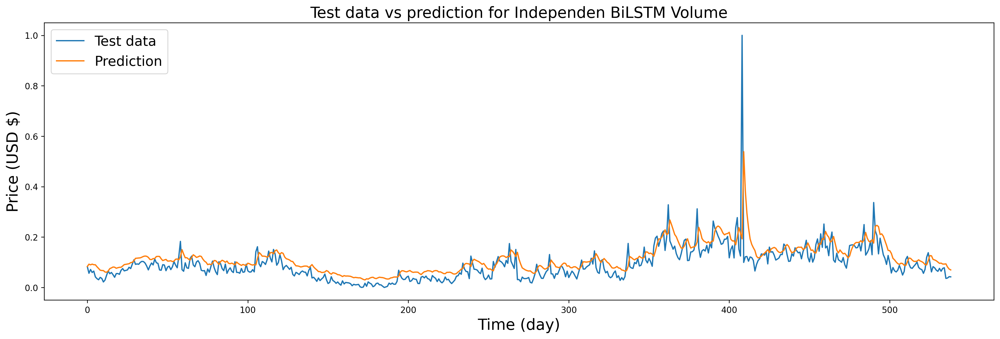

In [ ]:
prediction_bilstm_volume = prediction(model_bilstm_volume, X_test_volume)
plot_future(prediction_bilstm_volume, 'Independen BiLSTM Volume', y_test_volume)

In [ ]:
scaler = MinMaxScaler(feature_range=(0,1)).fit(test_dataset_volume)
pred_inv_bilstm_volume = scaler.inverse_transform(prediction_bilstm_volume)

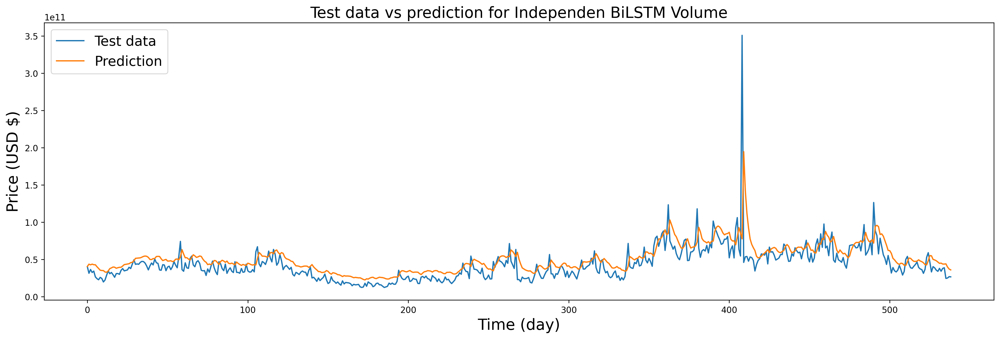

In [ ]:
plot_future(pred_inv_bilstm_volume, 'Independen BiLSTM Volume', y_test_volume_inv)

### Ukuran Kinerja Model Independen BiLSTM

In [ ]:
mse = mean_squared_error(y_test_high_inv, pred_inv_bilstm_high, squared=True, multioutput='raw_values')
rmse = mean_squared_error(y_test_high_inv, pred_inv_bilstm_high, squared=False, multioutput='raw_values')
mae = mean_absolute_error(y_test_high_inv, pred_inv_bilstm_high, multioutput='raw_values')
mape = mean_absolute_percentage_error(y_test_high_inv, pred_inv_bilstm_high, multioutput='raw_values')
print('Prediksi Metode Independen BiLSTM High')
print('MSE High = %.4f'%(mse[0]))
print()
print('RMSE High = %.4f'%(rmse[0]))
print()
print('MAE High = %.4f'%(mae[0]))
print()
print('MAPE High = %.4f'%((mape[0])*100), '%')

Prediksi Metode Independen BiLSTM High
MSE High = 5719247.0946

RMSE High = 2391.4947

MAE High = 1561.7484

MAPE High = 6.7799 %


In [ ]:
mse = mean_squared_error(y_test_low_inv, pred_inv_bilstm_low, squared=True, multioutput='raw_values')
rmse = mean_squared_error(y_test_low_inv, pred_inv_bilstm_low, squared=False, multioutput='raw_values')
mae = mean_absolute_error(y_test_low_inv, pred_inv_bilstm_low, multioutput='raw_values')
mape = mean_absolute_percentage_error(y_test_low_inv, pred_inv_bilstm_low, multioutput='raw_values')
print('Prediksi Metode Independen BiLSTM Low')
print('MSE Low = %.4f'%(mse[0]))
print()
print('RMSE Low = %.4f'%(rmse[0]))
print()
print('MAE Low = %.4f'%(mae[0]))
print()
print('MAPE Low = %.4f'%((mape[0])*100), '%')

Prediksi Metode Independen BiLSTM Low
MSE Low = 13541280.7357

RMSE Low = 3679.8479

MAE Low = 3188.9746

MAPE Low = 22.1029 %


In [ ]:
mse = mean_squared_error(y_test_open_inv, pred_inv_bilstm_open, squared=True, multioutput='raw_values')
rmse = mean_squared_error(y_test_open_inv, pred_inv_bilstm_open, squared=False, multioutput='raw_values')
mae = mean_absolute_error(y_test_open_inv, pred_inv_bilstm_open, multioutput='raw_values')
mape = mean_absolute_percentage_error(y_test_open_inv, pred_inv_bilstm_open, multioutput='raw_values')
print('Prediksi Metode Independen BiLSTM Open')
print('MSE Open = %.4f'%(mse[0]))
print()
print('RMSE Open = %.4f'%(rmse[0]))
print()
print('MAE Open = %.4f'%(mae[0]))
print()
print('MAPE Open = %.4f'%((mape[0])*100), '%')

Prediksi Metode Independen BiLSTM Open
MSE Open = 3345475.6600

RMSE Open = 1829.0641

MAE Open = 1309.9920

MAPE Open = 6.9614 %


In [ ]:
mse = mean_squared_error(y_test_close_inv, pred_inv_bilstm_close, squared=True, multioutput='raw_values')
rmse = mean_squared_error(y_test_close_inv, pred_inv_bilstm_close, squared=False, multioutput='raw_values')
mae = mean_absolute_error(y_test_close_inv, pred_inv_bilstm_close, multioutput='raw_values')
mape = mean_absolute_percentage_error(y_test_close_inv, pred_inv_bilstm_close, multioutput='raw_values')
print('Prediksi Metode Independen BiLSTM Close')
print('MSE Close = %.4f'%(mse[0]))
print()
print('RMSE Close = %.4f'%(rmse[0]))
print()
print('MAE Close = %.4f'%(mae[0]))
print()
print('MAPE Close = %.4f'%((mape[0])*100), '%')

Prediksi Metode Independen BiLSTM Close
MSE Close = 4133981.6691

RMSE Close = 2033.2195

MAE Close = 1381.1824

MAPE Close = 6.6273 %


In [ ]:
mse = mean_squared_error(y_test_volume_inv, pred_inv_bilstm_volume, squared=True, multioutput='raw_values')
rmse = mean_squared_error(y_test_volume_inv, pred_inv_bilstm_volume, squared=False, multioutput='raw_values')
mae = mean_absolute_error(y_test_volume_inv, pred_inv_bilstm_volume, multioutput='raw_values')
mape = mean_absolute_percentage_error(y_test_volume_inv, pred_inv_bilstm_volume, multioutput='raw_values')
print('Prediksi Metode Independen BiLSTM Volume')
print('MSE Volume = %.4f'%(mse[0]))
print()
print('RMSE Volume = %.4f'%(rmse[0]))
print()
print('MAE Volume = %.4f'%(mae[0]))
print()
print('MAPE Volume = %.4f'%((mape[0])*100), '%')

Prediksi Metode Independen BiLSTM Volume
MSE Volume = 374405508985280462848.0000

RMSE Volume = 19349560950.7110

MAE Volume = 12086420582.1726

MAPE Volume = 33.0454 %


### Prediksi H+1 Independen BiLSTM

#### BiLSTM High

In [ ]:
scaler = MinMaxScaler(feature_range=(0,1)).fit(test_dataset_high)
y_high_inde_bilstm = model_bilstm_high.predict(data_pred_high)
yhat_high_bilstm = y_high_inde_bilstm
nextday_pred_high_bilstm = np.hstack(y_high_inde_bilstm).reshape(-1,1)
nextday_pred_high_bilstm2 = scaler.inverse_transform(nextday_pred_high_bilstm)
print('Next day prediction Independen BiLSTM High =  %.3f'%(nextday_pred_high_bilstm2))

1/1 [==============================] - 0s 22ms/step
Next day prediction Independen BiLSTM High =  36180.902


In [ ]:
nextday_pred_high_bilstm

array([[0.51819944]], dtype=float32)

#### BiLSTM Low

In [ ]:
scaler = MinMaxScaler(feature_range=(0,1)).fit(test_dataset_low)
y_low_inde_bilstm = model_bilstm_low.predict(data_pred_low)
yhat_low_bilstm = y_low_inde_bilstm
nextday_pred_low_bilstm = np.hstack(y_low_inde_bilstm).reshape(-1,1)
nextday_pred_low_bilstm2 = scaler.inverse_transform(nextday_pred_low_bilstm)
print('Next day prediction Independen BiLSTM Low =  %.3f'%(nextday_pred_low_bilstm2))

1/1 [==============================] - 0s 21ms/step
Next day prediction Independen BiLSTM Low =  37507.465


In [ ]:
nextday_pred_low_bilstm

array([[0.5748596]], dtype=float32)

#### BiLSTM Open

In [ ]:
scaler = MinMaxScaler(feature_range=(0,1)).fit(test_dataset_open)
y_open_inde_bilstm = model_bilstm_open.predict(data_pred_open)
yhat_open_bilstm = y_open_inde_bilstm
nextday_pred_open_bilstm = np.hstack(y_open_inde_bilstm).reshape(-1,1)
nextday_pred_open_bilstm2 = scaler.inverse_transform(nextday_pred_open_bilstm)
print('Next day prediction Independen BiLSTM Open =  %.3f'%(nextday_pred_open_bilstm2))

1/1 [==============================] - 0s 19ms/step
Next day prediction Independen BiLSTM Open =  36329.070


In [ ]:
nextday_pred_open_bilstm

array([[0.53530186]], dtype=float32)

#### BiLSTM Close

In [ ]:
scaler = MinMaxScaler(feature_range=(0,1)).fit(test_dataset_close)
y_close_inde_bilstm = model_bilstm_close.predict(data_pred_close)
yhat_close_bilstm = y_close_inde_bilstm
nextday_pred_close_bilstm = np.hstack(y_close_inde_bilstm).reshape(-1,1)
nextday_pred_close_bilstm2 = scaler.inverse_transform(nextday_pred_close_bilstm)
print('Next day prediction Independen BiLSTM Close =  %.3f'%(nextday_pred_close_bilstm2))

1/1 [==============================] - 0s 23ms/step
Next day prediction Independen BiLSTM Close =  35697.156


In [ ]:
nextday_pred_close_bilstm

array([[0.5249439]], dtype=float32)

#### BiLSTM Volume

In [ ]:
scaler = MinMaxScaler(feature_range=(0,1)).fit(test_dataset_volume)
y_volume_inde_bilstm = model_bilstm_volume.predict(data_pred_volume)
yhat_volume_bilstm = y_volume_inde_bilstm
nextday_pred_volume_bilstm = np.hstack(y_volume_inde_bilstm).reshape(-1,1)
nextday_pred_volume_bilstm2 = scaler.inverse_transform(nextday_pred_volume_bilstm)
print('Next day prediction Independen BiLSTM Volume =  %.3f'%(nextday_pred_volume_bilstm2))

1/1 [==============================] - 0s 23ms/step
Next day prediction Independen BiLSTM Volume =  45376393216.000


In [ ]:
nextday_pred_volume_bilstm

array([[0.09779242]], dtype=float32)

# Model Tunggal

## Tunggal LSTM

In [ ]:
# Create LSTM model
def create_lstm(units):
    model = Sequential()
    # Input layer
    model.add(LSTM(units = units, return_sequences = True, 
                    input_shape = ([X_train.shape[1], X_train.shape[2]])))
    model.add(Dropout(0.3)) 
    # Hidden layer
    model.add(LSTM(units = units*2))
    model.add(Dropout(0.3))
    # Output Layer
    model.add(Dense(units = 5)) 
    #Compile model
    model.compile(optimizer='adam', loss='mse')
    return model

In [ ]:
model_lstm = create_lstm(32)

In [ ]:
print(model_lstm.summary())

Model: "sequential_15"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_20 (LSTM)              (None, 60, 32)            4864      
                                                                 
 dropout_30 (Dropout)        (None, 60, 32)            0         
                                                                 
 lstm_21 (LSTM)              (None, 64)                24832     
                                                                 
 dropout_31 (Dropout)        (None, 64)                0         
                                                                 
 dense_15 (Dense)            (None, 5)                 325       
                                                                 
Total params: 30,021
Trainable params: 30,021
Non-trainable params: 0
_________________________________________________________________
None


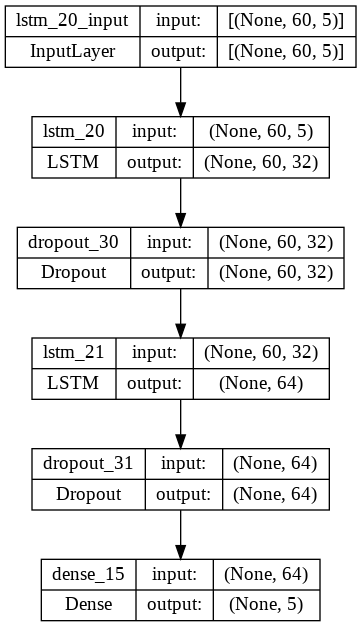

In [ ]:
plot_model(model_lstm, to_file='model_lstm.png', show_shapes=True, show_layer_names=True)

In [ ]:
history_lstm = fit_model(model_lstm, X_test, y_test)

Epoch 1/50
14/14 [==============================] - 4s 65ms/step - loss: 0.0151 - val_loss: 0.0216
Epoch 2/50
14/14 [==============================] - 0s 13ms/step - loss: 0.0166 - val_loss: 0.0065
Epoch 3/50
14/14 [==============================] - 0s 12ms/step - loss: 0.0097 - val_loss: 0.0093
Epoch 4/50
14/14 [==============================] - 0s 13ms/step - loss: 0.0206 - val_loss: 0.0426
Epoch 5/50
14/14 [==============================] - 0s 13ms/step - loss: 0.0097 - val_loss: 0.0095
Epoch 6/50
14/14 [==============================] - 0s 12ms/step - loss: 0.0107 - val_loss: 0.0183
Epoch 7/50
14/14 [==============================] - 0s 12ms/step - loss: 0.0081 - val_loss: 0.0073
Epoch 8/50
14/14 [==============================] - 0s 11ms/step - loss: 0.0138 - val_loss: 0.0348
Epoch 9/50
14/14 [==============================] - 0s 11ms/step - loss: 0.0053 - val_loss: 0.0091
Epoch 10/50
14/14 [==============================] - 0s 11ms/step - loss: 0.0050 - val_loss: 0.0066
Epoch 11/

In [ ]:
#TESTING
evaluation_LSTM = model_lstm.evaluate(X_test, y_test)
print(evaluation_LSTM)

17/17 [==============================] - 0s 6ms/step - loss: 0.0018
0.0018028978956863284


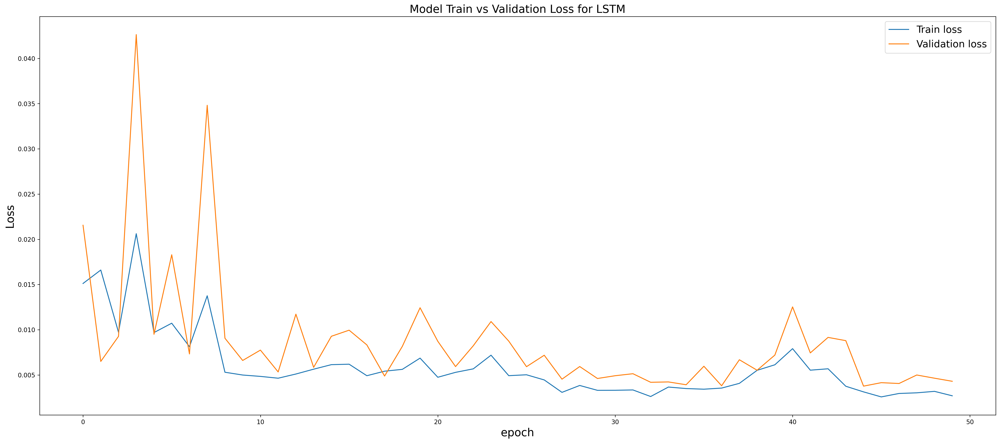

In [ ]:
plot_loss (history_lstm, 'LSTM') 

## Tunggal GRU

In [ ]:
# Create GRU model
def create_gru(units):
    model = Sequential()
    # Input layer
    model.add(GRU(units = units, return_sequences = True, 
                   input_shape = ([X_train.shape[1], X_train.shape[2]])))
    model.add(Dropout(0.3)) 
    # Hidden layer
    model.add(GRU(units = units*2)) 
    model.add(Dropout(0.3))
    # Output Layer
    model.add(Dense(units = 5)) 
    #Compile model
    model.compile(optimizer='adam',loss='mse')
    return model

In [ ]:
model_gru = create_gru(32)

In [ ]:
print(model_gru.summary())

Model: "sequential_16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru_10 (GRU)                (None, 60, 32)            3744      
                                                                 
 dropout_32 (Dropout)        (None, 60, 32)            0         
                                                                 
 gru_11 (GRU)                (None, 64)                18816     
                                                                 
 dropout_33 (Dropout)        (None, 64)                0         
                                                                 
 dense_16 (Dense)            (None, 5)                 325       
                                                                 
Total params: 22,885
Trainable params: 22,885
Non-trainable params: 0
_________________________________________________________________
None


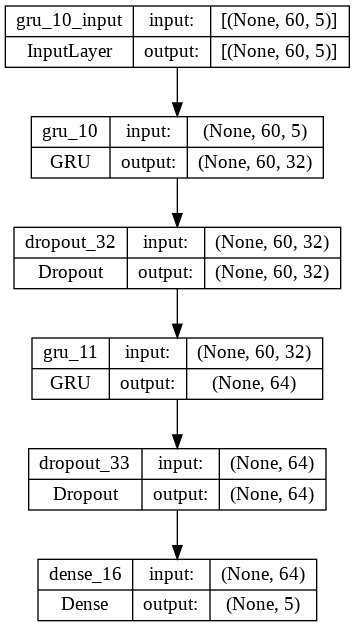

In [ ]:
plot_model(model_gru, to_file='model_gru.png', show_shapes=True, show_layer_names=True)

In [ ]:
history_gru = fit_model(model_gru, X_test, y_test)

Epoch 1/50
14/14 [==============================] - 3s 59ms/step - loss: 0.0191 - val_loss: 0.0327
Epoch 2/50
14/14 [==============================] - 0s 12ms/step - loss: 0.0173 - val_loss: 0.0053
Epoch 3/50
14/14 [==============================] - 0s 11ms/step - loss: 0.0092 - val_loss: 0.0113
Epoch 4/50
14/14 [==============================] - 0s 12ms/step - loss: 0.0090 - val_loss: 0.0041
Epoch 5/50
14/14 [==============================] - 0s 11ms/step - loss: 0.0102 - val_loss: 0.0098
Epoch 6/50
14/14 [==============================] - 0s 11ms/step - loss: 0.0086 - val_loss: 0.0074
Epoch 7/50
14/14 [==============================] - 0s 12ms/step - loss: 0.0069 - val_loss: 0.0083
Epoch 8/50
14/14 [==============================] - 0s 11ms/step - loss: 0.0055 - val_loss: 0.0041
Epoch 9/50
14/14 [==============================] - 0s 10ms/step - loss: 0.0050 - val_loss: 0.0035
Epoch 10/50
14/14 [==============================] - 0s 10ms/step - loss: 0.0054 - val_loss: 0.0046
Epoch 11/

In [ ]:
#TESTING
evaluation_GRU = model_gru.evaluate(X_test, y_test)
print(evaluation_GRU)

17/17 [==============================] - 0s 4ms/step - loss: 0.0018
0.001838324940763414


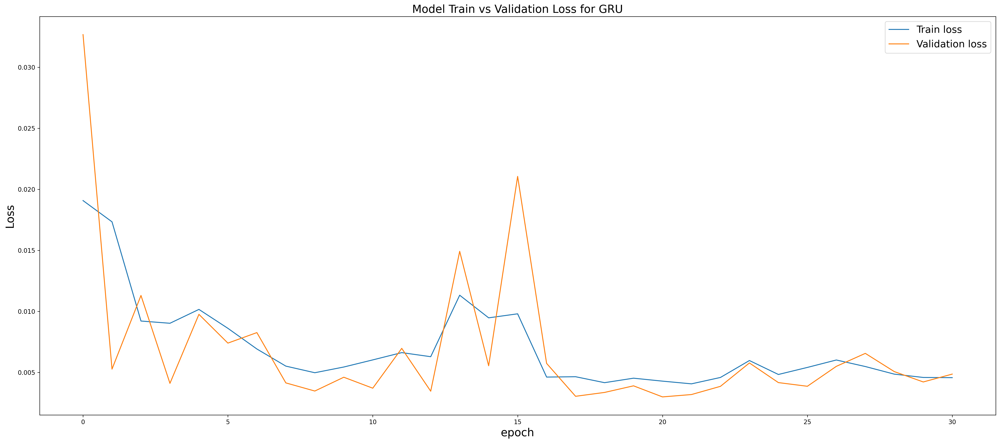

In [ ]:
plot_loss(history_gru, 'GRU')

## Tunggal BiLSTM

In [ ]:
# Create BiLSTM model
def create_bilstm(units):
    model = Sequential()
    # Input layer
    model.add(Bidirectional(LSTM(units = units, return_sequences=True), 
              input_shape=([X_train.shape[1], X_train.shape[2]])))
    model.add(Dropout(0.3))
    # Hidden layer
    model.add(Bidirectional(LSTM(units = units*2)))
    model.add(Dense(units = 5))
    model.add(Dropout(0.3))
    #Compile model
    model.compile(optimizer='adam',loss='mse')
    return model

In [ ]:
model_bilstm = create_bilstm(32)

In [ ]:
print(model_bilstm.summary())

Model: "sequential_17"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 bidirectional_10 (Bidirecti  (None, 60, 64)           9728      
 onal)                                                           
                                                                 
 dropout_34 (Dropout)        (None, 60, 64)            0         
                                                                 
 bidirectional_11 (Bidirecti  (None, 128)              66048     
 onal)                                                           
                                                                 
 dense_17 (Dense)            (None, 5)                 645       
                                                                 
 dropout_35 (Dropout)        (None, 5)                 0         
                                                                 
Total params: 76,421
Trainable params: 76,421
Non-tra

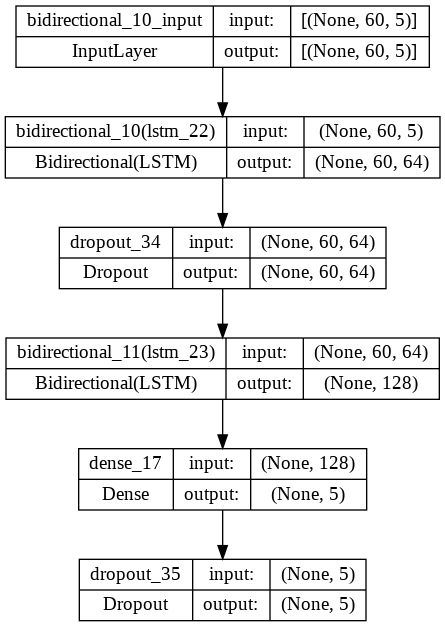

In [ ]:
plot_model(model_bilstm, to_file='model_bilstm.png', show_shapes=True, show_layer_names=True)

In [ ]:
history_bilstm = fit_model(model_bilstm, X_test, y_test)

Epoch 1/50
14/14 [==============================] - 7s 119ms/step - loss: 0.0286 - val_loss: 0.0219
Epoch 2/50
14/14 [==============================] - 0s 18ms/step - loss: 0.0354 - val_loss: 0.0229
Epoch 3/50
14/14 [==============================] - 0s 18ms/step - loss: 0.0436 - val_loss: 0.0756
Epoch 4/50
14/14 [==============================] - 0s 20ms/step - loss: 0.0328 - val_loss: 0.0293
Epoch 5/50
14/14 [==============================] - 0s 18ms/step - loss: 0.0341 - val_loss: 0.0203
Epoch 6/50
14/14 [==============================] - 0s 20ms/step - loss: 0.0373 - val_loss: 0.0736
Epoch 7/50
14/14 [==============================] - 0s 18ms/step - loss: 0.0274 - val_loss: 0.0196
Epoch 8/50
14/14 [==============================] - 0s 18ms/step - loss: 0.0310 - val_loss: 0.0412
Epoch 9/50
14/14 [==============================] - 0s 17ms/step - loss: 0.0302 - val_loss: 0.0198
Epoch 10/50
14/14 [==============================] - 0s 17ms/step - loss: 0.0280 - val_loss: 0.0417
Epoch 11

In [ ]:
#TESTING
evaluation_BiLSTM = model_bilstm.evaluate(X_test, y_test)
print(evaluation_BiLSTM)

17/17 [==============================] - 0s 7ms/step - loss: 0.0099
0.009933430701494217


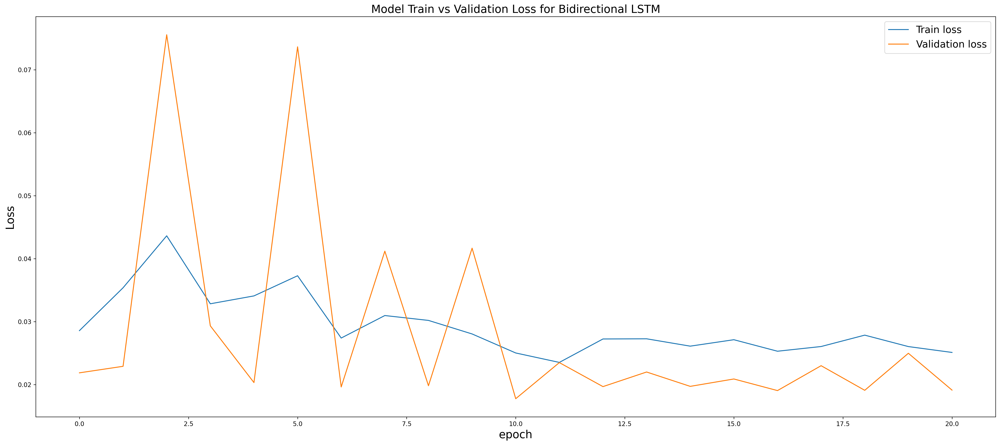

In [ ]:
plot_loss(history_bilstm, 'Bidirectional LSTM')

In [ ]:
prediction_lstm = prediction(model_lstm, X_test)
prediction_gru = prediction(model_gru, X_test)
prediction_bilstm = prediction(model_bilstm, X_test)

17/17 [==============================] - 2s 7ms/step


## Visualisasi model Tunggal

### LSTM

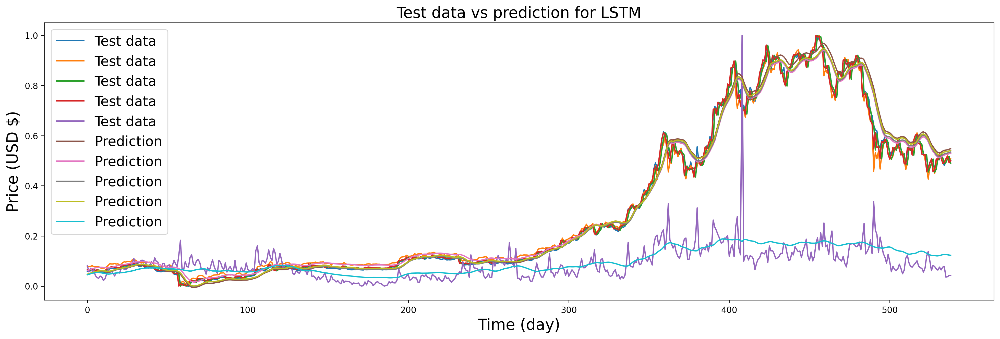

In [ ]:
plot_future(prediction_lstm, 'LSTM', y_test)

In [ ]:
scaler = MinMaxScaler(feature_range=(0,1)).fit(test_dataset)
pred_inv_lstm = scaler.inverse_transform(prediction_lstm)
print(pred_inv_lstm)

[[8.0701138e+03 7.7456094e+03 7.6808721e+03 7.7469551e+03 2.7506915e+10]
 [8.2083467e+03 7.8653037e+03 7.8172563e+03 7.8698057e+03 2.8226937e+10]
 [8.3459502e+03 7.9886299e+03 7.9600332e+03 8.0001211e+03 2.8865741e+10]
 ...
 [3.7692398e+04 3.4645340e+04 3.6054461e+04 3.6402434e+04 5.4552048e+10]
 [3.7841145e+04 3.4796113e+04 3.6203230e+04 3.6541234e+04 5.4216548e+10]
 [3.7938469e+04 3.4899504e+04 3.6309453e+04 3.6639164e+04 5.3808271e+10]]


In [ ]:
pred_inv_lstm.shape

(539, 5)

In [ ]:
y_test_inv = scaler.inverse_transform(y_test)

In [ ]:
y_test

array([[0.05977168, 0.07831414, 0.06532277, 0.06553985, 0.08222312],
       [0.05903834, 0.07753806, 0.06510299, 0.064118  , 0.05627552],
       [0.06091401, 0.07866058, 0.0636117 , 0.06762462, 0.07120887],
       ...,
       [0.51411193, 0.52131605, 0.50687612, 0.51794992, 0.03741108],
       [0.50313916, 0.50095846, 0.51744972, 0.49160946, 0.04271715],
       [0.4990101 , 0.50760634, 0.49077843, 0.49996704, 0.04206676]])

In [ ]:
y_test_inv.shape

(539, 5)

In [ ]:
y_test_inv

array([[8.89011742e+03, 8.65718745e+03, 8.82534368e+03, 8.80701028e+03,
        4.01028346e+10],
       [8.84646110e+03, 8.61209584e+03, 8.81248149e+03, 8.72378577e+03,
        3.13139819e+10],
       [8.95812195e+03, 8.67731635e+03, 8.72520996e+03, 8.92903768e+03,
        3.63721393e+10],
       ...,
       [3.59375671e+04, 3.43964775e+04, 3.46655649e+04, 3.52877798e+04,
        2.49243079e+10],
       [3.52843444e+04, 3.32136610e+04, 3.52843444e+04, 3.37460025e+04,
        2.67215543e+10],
       [3.50385364e+04, 3.35999162e+04, 3.37235097e+04, 3.42351935e+04,
        2.65012599e+10]])

In [ ]:
pred_inv_lstm_without_volume = pred_inv_lstm[:,[0,1,2,3]]
pred_inv_lstm_without_volume

array([[ 8070.114 ,  7745.6094,  7680.872 ,  7746.955 ],
       [ 8208.347 ,  7865.3037,  7817.2563,  7869.8057],
       [ 8345.95  ,  7988.63  ,  7960.033 ,  8000.121 ],
       ...,
       [37692.4   , 34645.34  , 36054.46  , 36402.434 ],
       [37841.145 , 34796.113 , 36203.23  , 36541.234 ],
       [37938.47  , 34899.504 , 36309.453 , 36639.164 ]], dtype=float32)

In [ ]:
pred_inv_lstm_volume = pred_inv_lstm[:,[4]]
pred_inv_lstm_volume

array([[2.7506915e+10],
       [2.8226937e+10],
       [2.8865741e+10],
       [2.9492226e+10],
       [3.0023145e+10],
       [3.0477550e+10],
       [3.0649639e+10],
       [3.0583921e+10],
       [3.0361014e+10],
       [3.0066868e+10],
       [2.9687216e+10],
       [2.9202754e+10],
       [2.8737309e+10],
       [2.8505129e+10],
       [2.8612856e+10],
       [2.8909967e+10],
       [2.9305256e+10],
       [2.9671512e+10],
       [2.9893976e+10],
       [3.0082525e+10],
       [3.0241898e+10],
       [3.0320990e+10],
       [3.0474680e+10],
       [3.0796890e+10],
       [3.1164539e+10],
       [3.1538149e+10],
       [3.1933198e+10],
       [3.2388561e+10],
       [3.2790473e+10],
       [3.3322007e+10],
       [3.4006944e+10],
       [3.4617151e+10],
       [3.5145040e+10],
       [3.5519963e+10],
       [3.5827081e+10],
       [3.6134150e+10],
       [3.6483023e+10],
       [3.6715672e+10],
       [3.6823605e+10],
       [3.6768129e+10],
       [3.6728820e+10],
       [3.678592

In [ ]:
y_test_inv_without_volume = y_test_inv[:,[0,1,2,3]]
y_test_inv_without_volume

array([[ 8890.11741953,  8657.18744654,  8825.34368451,  8807.01027532],
       [ 8846.46109861,  8612.09583682,  8812.48149122,  8723.78576573],
       [ 8958.12195167,  8677.3163483 ,  8725.20996387,  8929.0376776 ],
       ...,
       [35937.56714724, 34396.47745754, 34665.56486608, 35287.77976616],
       [35284.34443007, 33213.66103397, 35284.34443007, 33746.00245614],
       [35038.53636342, 33599.91616924, 33723.50965515, 34235.19345116]])

In [ ]:
y_test_inv_volume = y_test_inv[:,[4]]
y_test_inv_volume

array([[4.01028346e+10],
       [3.13139819e+10],
       [3.63721393e+10],
       [3.23377726e+10],
       [3.42173205e+10],
       [2.64223757e+10],
       [2.40974185e+10],
       [2.26002041e+10],
       [2.57706808e+10],
       [2.43979130e+10],
       [1.96473315e+10],
       [2.21776788e+10],
       [2.86473384e+10],
       [3.43987444e+10],
       [3.06825981e+10],
       [3.23787929e+10],
       [2.94324897e+10],
       [2.59226565e+10],
       [3.08357369e+10],
       [3.09340965e+10],
       [2.98931837e+10],
       [3.52220609e+10],
       [3.76288237e+10],
       [3.45227182e+10],
       [3.51720438e+10],
       [3.58078847e+10],
       [3.93865481e+10],
       [3.76480594e+10],
       [4.34443038e+10],
       [4.93560714e+10],
       [4.33382642e+10],
       [4.38650548e+10],
       [4.33747803e+10],
       [4.59982984e+10],
       [4.72710240e+10],
       [4.69920197e+10],
       [4.49252602e+10],
       [4.09305475e+10],
       [3.58380252e+10],
       [4.11851858e+10],


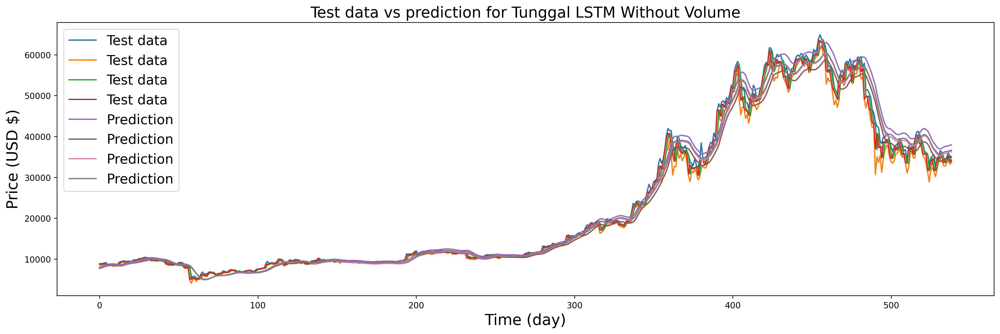

In [ ]:
plot_future(pred_inv_lstm_without_volume, 'Tunggal LSTM Without Volume', y_test_inv_without_volume)

In [ ]:
pred_inv_lstm_without_volume[:,3]

array([ 7746.955 ,  7869.8057,  8000.121 ,  8128.6743,  8258.179 ,
        8372.68  ,  8452.889 ,  8505.736 ,  8543.555 ,  8552.657 ,
        8530.069 ,  8490.11  ,  8447.258 ,  8431.1   ,  8463.128 ,
        8547.107 ,  8659.869 ,  8784.567 ,  8903.905 ,  9007.254 ,
        9091.71  ,  9146.013 ,  9186.969 ,  9243.094 ,  9314.8955,
        9393.334 ,  9485.162 ,  9580.028 ,  9665.613 ,  9766.193 ,
        9866.827 ,  9955.654 , 10020.613 , 10043.944 , 10028.311 ,
        9996.674 ,  9965.345 ,  9909.053 ,  9847.697 ,  9792.7   ,
        9755.26  ,  9731.807 ,  9694.686 ,  9609.704 ,  9474.324 ,
        9312.799 ,  9148.209 ,  8989.749 ,  8855.482 ,  8759.67  ,
        8694.266 ,  8662.968 ,  8673.386 ,  8704.217 ,  8699.759 ,
        8617.598 ,  8489.258 ,  8334.33  ,  8055.58  ,  7576.6123,
        7052.455 ,  6545.2783,  6065.757 ,  5647.27  ,  5309.9644,
        5084.1504,  5001.766 ,  5013.3003,  5074.735 ,  5157.0444,
        5289.152 ,  5456.414 ,  5631.2876,  5792.578 ,  5905.1

In [ ]:
y_test_inv_without_volume[:,1]

array([ 8657.18744654,  8612.09583682,  8677.3163483 ,  8827.33234474,
        8620.0799932 ,  8560.47404294,  8544.52045256,  8636.7474349 ,
        8333.63787363,  8266.84057849,  8296.21900672,  8325.49808268,
        8597.30877926,  8908.44692853,  9269.46813861,  9230.89727886,
        9230.77618023,  9313.2387904 ,  9217.82397728,  9248.63423233,
        9112.8114171 ,  9163.70413921,  9539.8180851 ,  9726.00315742,
        9678.90979138,  9850.39221314,  9784.563802  ,  9729.33489054,
       10202.3876541 , 10116.1614999 , 10125.5337907 ,  9874.4275077 ,
        9722.38715745,  9507.63799409,  9632.38276334,  9611.22354001,
        9507.90006137,  9589.74360064,  9600.72878571,  9657.79114467,
        9537.04322252,  9305.02118582,  8704.4265506 ,  8577.19930942,
        8492.93215312,  8599.50861972,  8471.21262606,  8532.63094465,
        8704.99029396,  8712.43181192,  8757.25403405,  9032.07958273,
        8890.74417157,  8105.25280434,  7690.09818591,  7814.76324378,
      

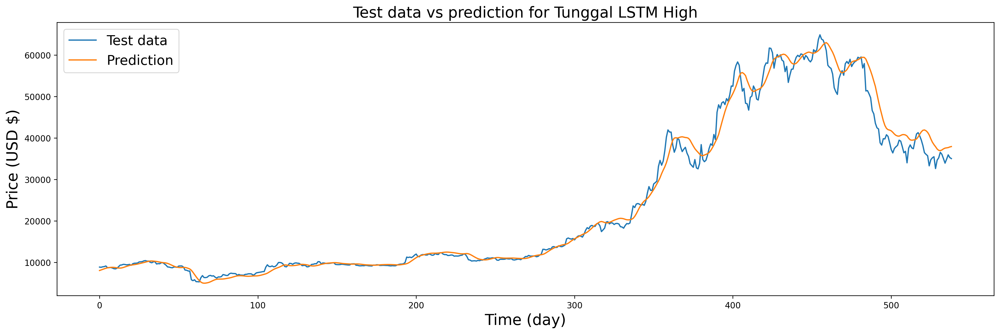

In [ ]:
plot_future(pred_inv_lstm_without_volume[:,0], 'Tunggal LSTM High', y_test_inv_without_volume[:,0])

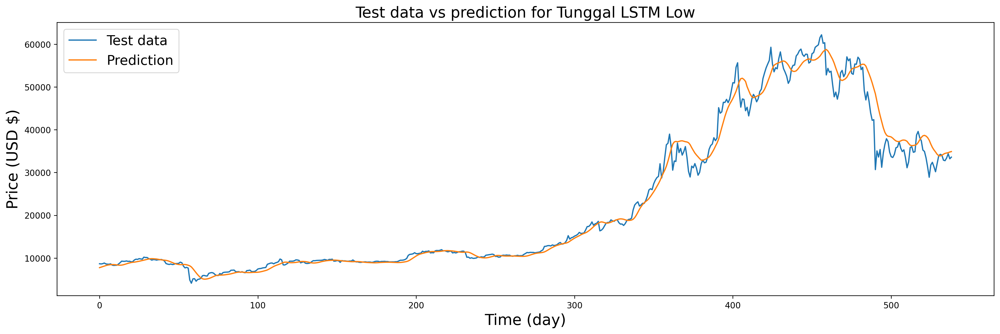

In [ ]:
plot_future(pred_inv_lstm_without_volume[:,1], 'Tunggal LSTM Low', y_test_inv_without_volume[:,1])

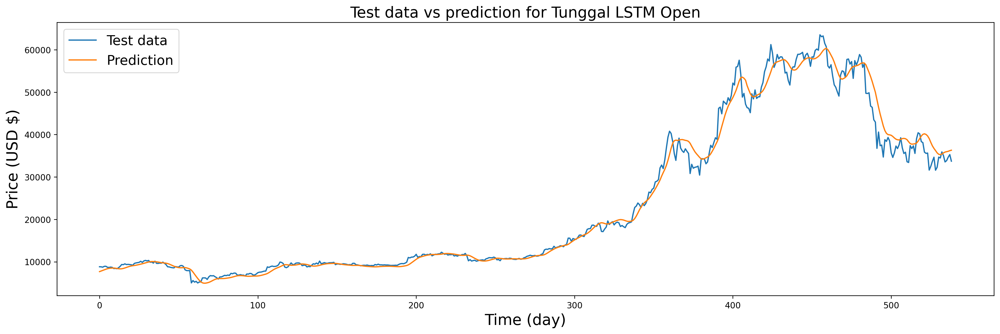

In [ ]:
plot_future(pred_inv_lstm_without_volume[:,2], 'Tunggal LSTM Open', y_test_inv_without_volume[:,2])

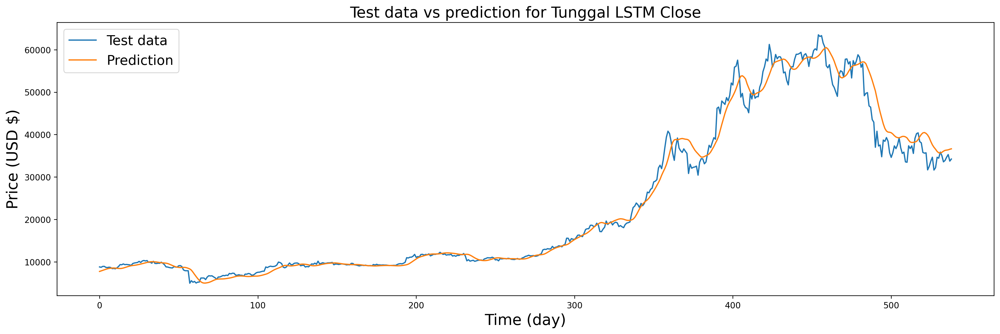

In [ ]:
plot_future(pred_inv_lstm_without_volume[:,3], 'Tunggal LSTM Close', y_test_inv_without_volume[:,3])

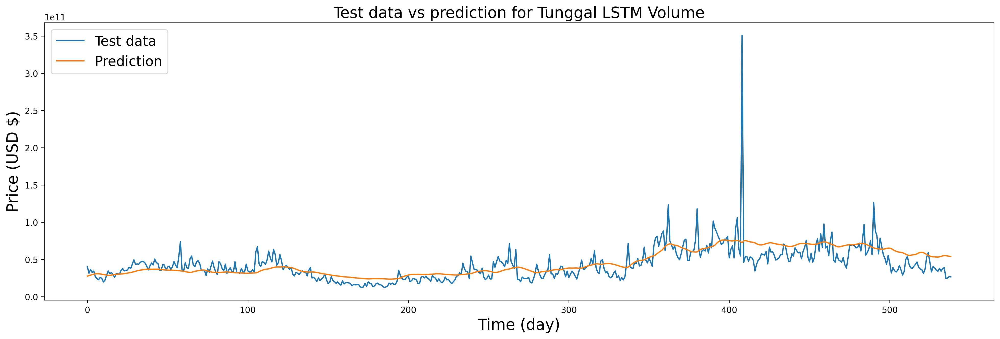

In [ ]:
plot_future(pred_inv_lstm_volume, 'Tunggal LSTM Volume', y_test_inv_volume)

### GRU

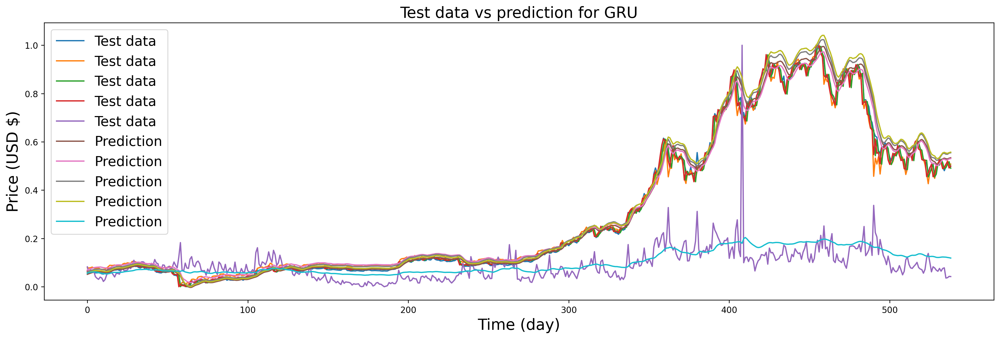

In [ ]:
plot_future(prediction_gru, 'GRU', y_test)

In [ ]:
scaler = MinMaxScaler(feature_range=(0,1)).fit(test_dataset)
pred_inv_gru = scaler.inverse_transform(prediction_gru)
print(pred_inv_gru)

[[8.3853516e+03 8.1284180e+03 8.6238779e+03 8.2742676e+03 3.1195963e+10]
 [8.5389932e+03 8.2362119e+03 8.7622930e+03 8.4438154e+03 3.2205474e+10]
 [8.6791709e+03 8.4171562e+03 8.9046963e+03 8.5722295e+03 3.2580106e+10]
 ...
 [3.6826008e+04 3.4601184e+04 3.7106895e+04 3.7298258e+04 5.3297132e+10]
 [3.7015777e+04 3.4866602e+04 3.7383152e+04 3.7481637e+04 5.2952883e+10]
 [3.7127664e+04 3.4940035e+04 3.7466355e+04 3.7585148e+04 5.2450722e+10]]


In [ ]:
pred_inv_gru_without_volume = pred_inv_gru[:,[0,1,2,3]]
pred_inv_gru_without_volume

array([[ 8385.352 ,  8128.418 ,  8623.878 ,  8274.268 ],
       [ 8538.993 ,  8236.212 ,  8762.293 ,  8443.815 ],
       [ 8679.171 ,  8417.156 ,  8904.696 ,  8572.2295],
       ...,
       [36826.008 , 34601.184 , 37106.895 , 37298.258 ],
       [37015.777 , 34866.6   , 37383.152 , 37481.637 ],
       [37127.664 , 34940.035 , 37466.355 , 37585.15  ]], dtype=float32)

In [ ]:
pred_inv_gru_volume = pred_inv_gru[:,[4]]
pred_inv_gru_volume

array([[3.1195963e+10],
       [3.2205474e+10],
       [3.2580106e+10],
       [3.2930533e+10],
       [3.3025536e+10],
       [3.3031719e+10],
       [3.2628535e+10],
       [3.2079714e+10],
       [3.1509029e+10],
       [3.1125537e+10],
       [3.0817231e+10],
       [3.0371439e+10],
       [3.0128146e+10],
       [3.0372796e+10],
       [3.1097102e+10],
       [3.1675881e+10],
       [3.2186765e+10],
       [3.2409590e+10],
       [3.2320612e+10],
       [3.2361124e+10],
       [3.2421186e+10],
       [3.2408889e+10],
       [3.2695122e+10],
       [3.3190515e+10],
       [3.3526610e+10],
       [3.3783112e+10],
       [3.4034516e+10],
       [3.4350049e+10],
       [3.4592993e+10],
       [3.5077435e+10],
       [3.5791213e+10],
       [3.6185035e+10],
       [3.6331114e+10],
       [3.6331102e+10],
       [3.6369887e+10],
       [3.6550337e+10],
       [3.6656497e+10],
       [3.6596650e+10],
       [3.6338807e+10],
       [3.5832832e+10],
       [3.5628761e+10],
       [3.569982

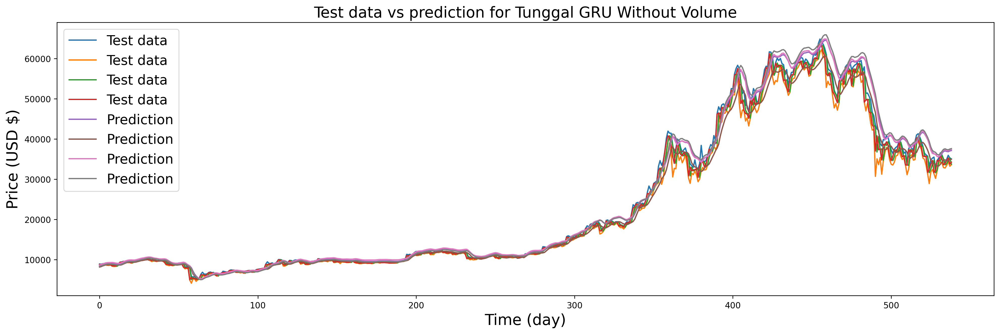

In [ ]:
plot_future(pred_inv_gru_without_volume, 'Tunggal GRU Without Volume', y_test_inv_without_volume)

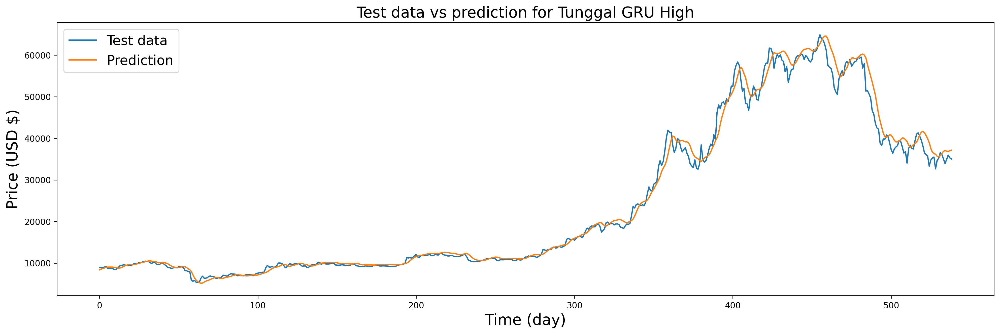

In [ ]:
plot_future(pred_inv_gru_without_volume[:,0], 'Tunggal GRU High', y_test_inv_without_volume[:,0])

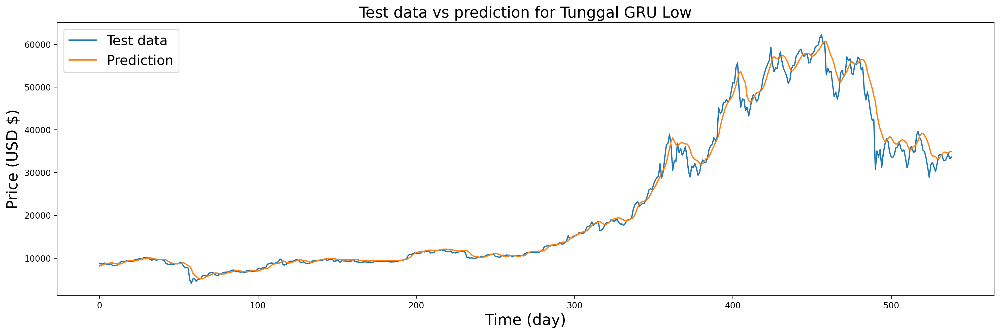

In [ ]:
plot_future(pred_inv_gru_without_volume[:,1], 'Tunggal GRU Low', y_test_inv_without_volume[:,1])

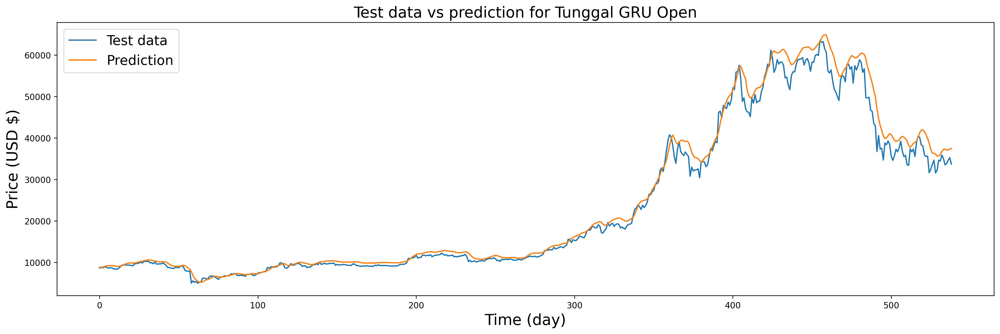

In [ ]:
plot_future(pred_inv_gru_without_volume[:,2], 'Tunggal GRU Open', y_test_inv_without_volume[:,2])

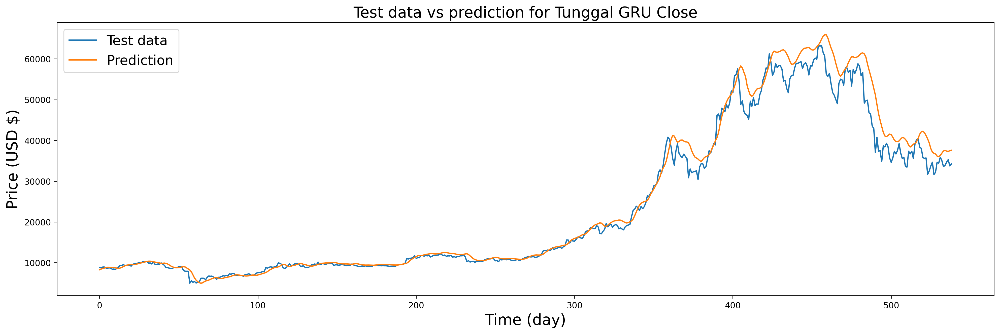

In [ ]:
plot_future(pred_inv_gru_without_volume[:,3], 'Tunggal GRU Close', y_test_inv_without_volume[:,3])

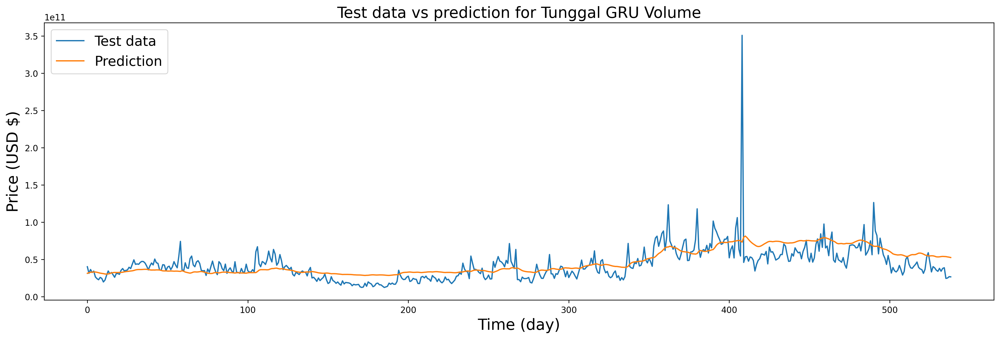

In [ ]:
plot_future(pred_inv_gru_volume, 'Tunggal GRU Volume', y_test_inv_volume)

### BiLSTM

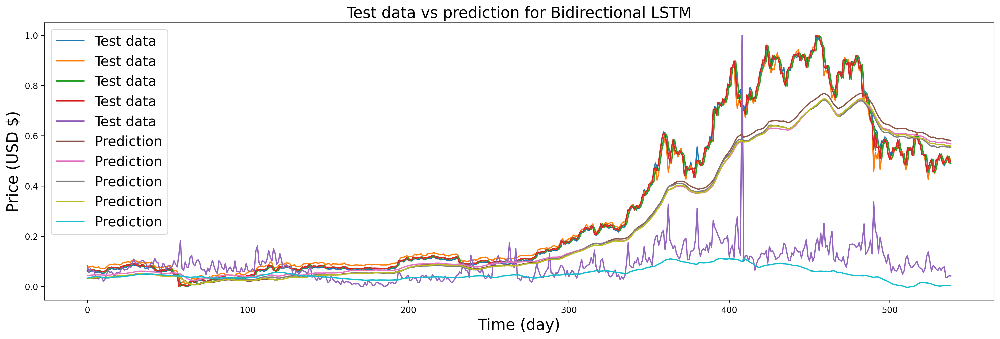

In [ ]:
plot_future(prediction_bilstm, 'Bidirectional LSTM', y_test)

In [ ]:
scaler = MinMaxScaler(feature_range=(0,1)).fit(test_dataset)
pred_inv_bilstm = scaler.inverse_transform(prediction_bilstm)
print(pred_inv_bilstm)

[[7.1842798e+03 6.6351641e+03 6.8538384e+03 6.9080703e+03 2.3562975e+10]
 [7.2034888e+03 6.6940449e+03 6.9201318e+03 6.9288481e+03 2.4180644e+10]
 [7.2340962e+03 6.7256929e+03 6.9604551e+03 6.9561079e+03 2.4590698e+10]
 ...
 [4.0071141e+04 3.7276609e+04 3.7505379e+04 3.7837578e+04 1.3501369e+10]
 [4.0046062e+04 3.7259445e+04 3.7536754e+04 3.7865312e+04 1.3645923e+10]
 [3.9861996e+04 3.7101020e+04 3.7402762e+04 3.7711766e+04 1.3918606e+10]]


In [ ]:
pred_inv_bilstm_without_volume = pred_inv_bilstm[:,[0,1,2,3]]
pred_inv_bilstm_without_volume

array([[ 7184.28  ,  6635.164 ,  6853.8384,  6908.0703],
       [ 7203.489 ,  6694.045 ,  6920.132 ,  6928.848 ],
       [ 7234.096 ,  6725.693 ,  6960.455 ,  6956.108 ],
       ...,
       [40071.14  , 37276.61  , 37505.38  , 37837.58  ],
       [40046.062 , 37259.445 , 37536.754 , 37865.312 ],
       [39861.996 , 37101.02  , 37402.76  , 37711.766 ]], dtype=float32)

In [ ]:
pred_inv_bilstm_volume = pred_inv_bilstm[:,[4]]
pred_inv_bilstm_volume

array([[2.3562975e+10],
       [2.4180644e+10],
       [2.4590698e+10],
       [2.5038107e+10],
       [2.5353232e+10],
       [2.5618975e+10],
       [2.5559992e+10],
       [2.5411314e+10],
       [2.5106416e+10],
       [2.4826933e+10],
       [2.4618854e+10],
       [2.4255715e+10],
       [2.4003590e+10],
       [2.4012909e+10],
       [2.4297050e+10],
       [2.4548639e+10],
       [2.4833010e+10],
       [2.5009134e+10],
       [2.5023619e+10],
       [2.5137390e+10],
       [2.5264654e+10],
       [2.5343005e+10],
       [2.5585267e+10],
       [2.5908869e+10],
       [2.6175894e+10],
       [2.6420986e+10],
       [2.6670168e+10],
       [2.6969960e+10],
       [2.7230550e+10],
       [2.7598242e+10],
       [2.8044085e+10],
       [2.8336499e+10],
       [2.8493177e+10],
       [2.8632080e+10],
       [2.8784284e+10],
       [2.8986640e+10],
       [2.9106670e+10],
       [2.9106586e+10],
       [2.9078170e+10],
       [2.8880099e+10],
       [2.8776534e+10],
       [2.876483

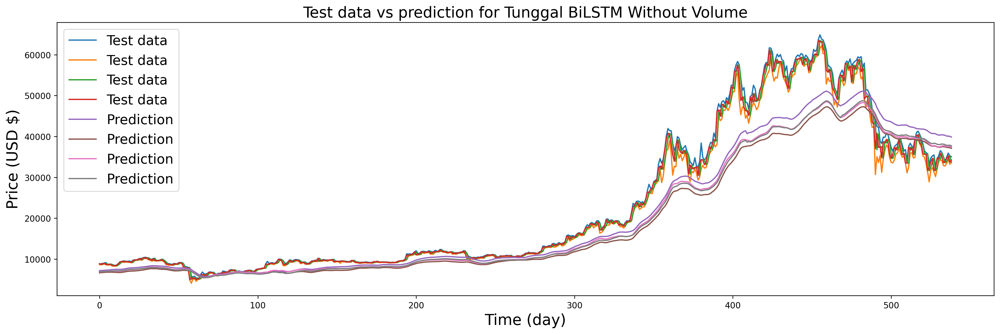

In [ ]:
plot_future(pred_inv_bilstm_without_volume, 'Tunggal BiLSTM Without Volume', y_test_inv_without_volume)

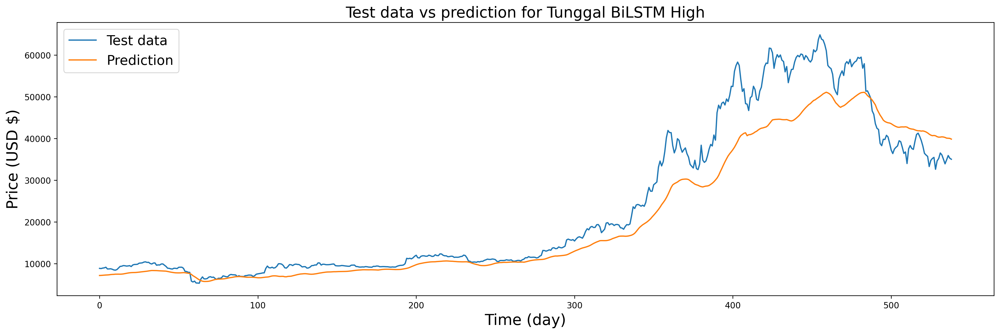

In [ ]:
plot_future(pred_inv_bilstm_without_volume[:,0], 'Tunggal BiLSTM High', y_test_inv_without_volume[:,0])

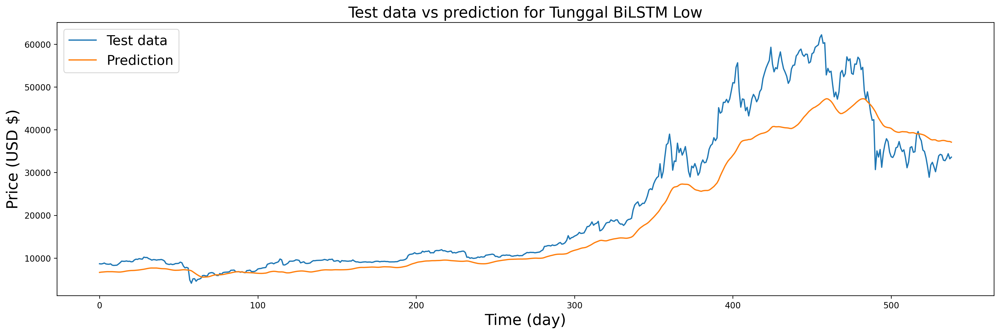

In [ ]:
plot_future(pred_inv_bilstm_without_volume[:,1], 'Tunggal BiLSTM Low', y_test_inv_without_volume[:,1])

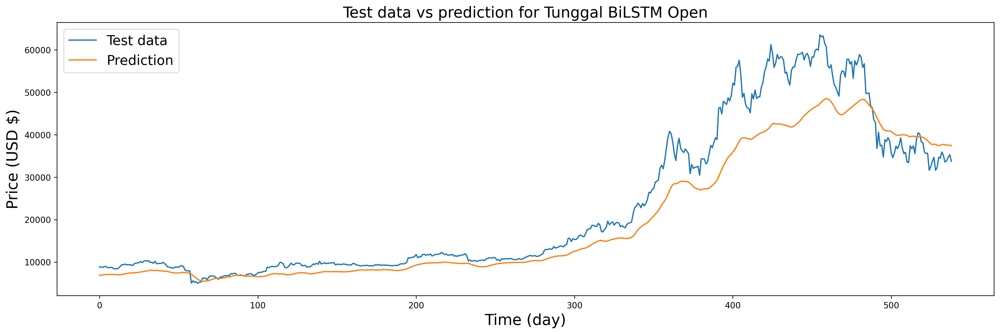

In [ ]:
plot_future(pred_inv_bilstm_without_volume[:,2], 'Tunggal BiLSTM Open', y_test_inv_without_volume[:,2])

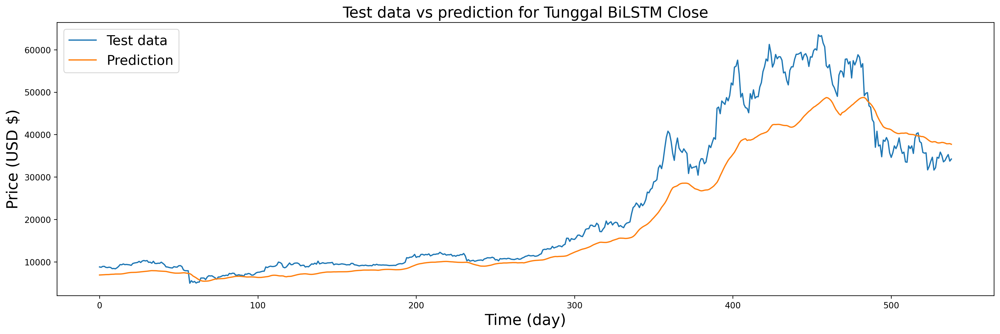

In [ ]:
plot_future(pred_inv_bilstm_without_volume[:,3], 'Tunggal BiLSTM Close', y_test_inv_without_volume[:,3])

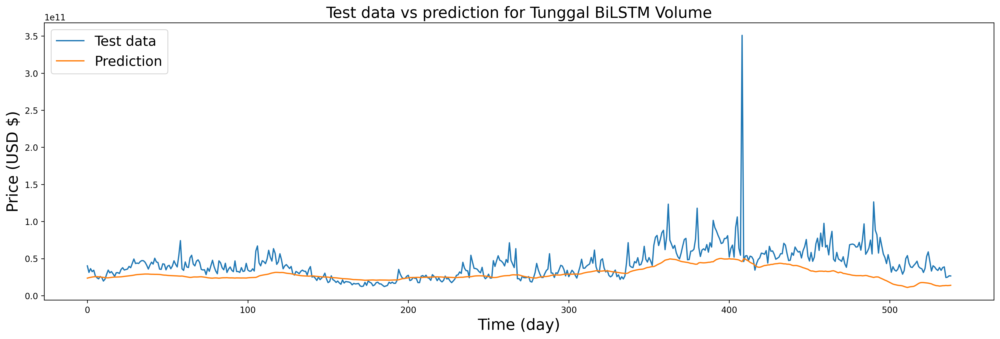

In [ ]:
plot_future(pred_inv_bilstm_volume, 'Tunggal BiLSTM Volume', y_test_inv_volume)

## Ukuran Kinerja Model Tunggal

In [ ]:
mse = mean_squared_error(y_test_inv, pred_inv_lstm, squared=True, multioutput='raw_values')
rmse = mean_squared_error(y_test_inv, pred_inv_lstm, squared=False, multioutput='raw_values')
mae = mean_absolute_error(y_test_inv, pred_inv_lstm, multioutput='raw_values')
mape = mean_absolute_percentage_error(y_test_inv, pred_inv_lstm, multioutput='raw_values')
print('Prediksi Metode Tunggal LSTM')
print('MSE High = %.4f'%(mse[0]))
print('MSE Low = %.4f'%(mse[1]))
print('MSE Open = %.4f'%(mse[2]))
print('MSE Close = %.4f'%(mse[3]))
print('MSE Volume = %.4f'%(mse[4]))
print()
print('RMSE High = %.4f'%(rmse[0]))
print('RMSE Low = %.4f'%(rmse[1]))
print('RMSE Open = %.4f'%(rmse[2]))
print('RMSE Close = %.4f'%(rmse[3]))
print('RMSE Volume = %.4f'%(rmse[4]))
print()
print('MAE High = %.4f'%(mae[0]))
print('MAE Low = %.4f'%(mae[1]))
print('MAE Open = %.4f'%(mae[2]))
print('MAE Close = %.4f'%(mae[3]))
print('MAE Volume = %.4f'%(mae[4]))
print()
print('MAPE High = %.4f'%((mape[0])*100), '%')
print('MAPE Low = %.4f'%((mape[1])*100), '%')
print('MAPE Open = %.4f'%((mape[2])*100), '%')
print('MAPE Close = %.4f'%((mape[3])*100), '%')
print('MAPE Volume = %.4f'%((mape[4])*100), '%')

Prediksi Metode Tunggal LSTM
MSE High = 4989755.5360
MSE Low = 6114991.4874
MSE Open = 4348342.7736
MSE Close = 6032565.6483
MSE Volume = 317184732974957789184.0000

RMSE High = 2233.7761
RMSE Low = 2472.8509
RMSE Open = 2085.2680
RMSE Close = 2456.1282
RMSE Volume = 17809680877.9652

MAE High = 1368.7760
MAE Low = 1436.8066
MAE Open = 1275.3943
MAE Close = 1484.6265
MAE Volume = 10642030042.3691

MAPE High = 5.6785 %
MAPE Low = 6.1517 %
MAPE Open = 5.4895 %
MAPE Close = 6.2486 %
MAPE Volume = 27.5605 %


In [ ]:
mse = mean_squared_error(y_test_inv, pred_inv_gru, squared=True, multioutput='raw_values')
rmse = mean_squared_error(y_test_inv, pred_inv_gru, squared=False, multioutput='raw_values')
mae = mean_absolute_error(y_test_inv, pred_inv_gru, multioutput='raw_values')
mape = mean_absolute_percentage_error(y_test_inv, pred_inv_gru, multioutput='raw_values')
print('Prediksi Metode Tunggal GRU')
print('MSE High = %.4f'%(mse[0]))
print('MSE Low = %.4f'%(mse[1]))
print('MSE Open = %.4f'%(mse[2]))
print('MSE Close = %.4f'%(mse[3]))
print('MSE Volume = %.4f'%(mse[4]))
print('MSE = ', mse)
print()
print('RMSE High = %.4f'%(rmse[0]))
print('RMSE Low = %.4f'%(rmse[1]))
print('RMSE Open = %.4f'%(rmse[2]))
print('RMSE Close = %.4f'%(rmse[3]))
print('RMSE Volume = %.4f'%(rmse[4]))
print('RMSE = ', rmse)
print()
print('MAE High = %.4f'%(mae[0]))
print('MAE Low = %.4f'%(mae[1]))
print('MAE Open = %.4f'%(mae[2]))
print('MAE Close = %.4f'%(mae[3]))
print('MAE Volume = %.4f'%(mae[4]))
print('MAE = ', mae)
print()
print('MAPE High = %.4f'%((mape[0])*100), '%')
print('MAPE Low = %.4f'%((mape[1])*100), '%')
print('MAPE Open = %.4f'%((mape[2])*100), '%')
print('MAPE Close = %.4f'%((mape[3])*100), '%')
print('MAPE Volume = %.4f'%((mape[4])*100), '%')
print('MAPE = ', mape)

Prediksi Metode Tunggal GRU
MSE High = 3460910.8040
MSE Low = 4410367.1801
MSE Open = 5137893.3450
MSE Close = 8606330.9646
MSE Volume = 332294779956094435328.0000
MSE =  [3.46091080e+06 4.41036718e+06 5.13789335e+06 8.60633096e+06
 3.32294780e+20]

RMSE High = 1860.3523
RMSE Low = 2100.0874
RMSE Open = 2266.6922
RMSE Close = 2933.6549
RMSE Volume = 18228954439.4651
RMSE =  [1.86035233e+03 2.10008742e+03 2.26669216e+03 2.93365488e+03
 1.82289544e+10]

MAE High = 1119.9943
MAE Low = 1160.2694
MAE Open = 1449.2633
MAE Close = 1669.6129
MAE Volume = 11342234373.3138
MAE =  [1.11999431e+03 1.16026941e+03 1.44926333e+03 1.66961293e+03
 1.13422344e+10]

MAPE High = 4.4985 %
MAPE Low = 4.7992 %
MAPE Open = 6.1262 %
MAPE Close = 6.1297 %
MAPE Volume = 30.5388 %
MAPE =  [0.04498468 0.04799159 0.06126179 0.06129675 0.30538767]


In [ ]:
mse = mean_squared_error(y_test_inv, pred_inv_bilstm, squared=True, multioutput='raw_values')
rmse = mean_squared_error(y_test_inv, pred_inv_bilstm, squared=False, multioutput='raw_values')
mae = mean_absolute_error(y_test_inv, pred_inv_bilstm, multioutput='raw_values')
mape = mean_absolute_percentage_error(y_test_inv, pred_inv_bilstm, multioutput='raw_values')
print('Prediksi Metode Tunggal Bidirectional LSTM')
print('MSE High = %.4f'%(mse[0]))
print('MSE Low = %.4f'%(mse[1]))
print('MSE Open = %.4f'%(mse[2]))
print('MSE Close = %.4f'%(mse[3]))
print('MSE Volume = %.4f'%(mse[4]))
print()
print('RMSE High = %.4f'%(rmse[0]))
print('RMSE Low = %.4f'%(rmse[1]))
print('RMSE Open = %.4f'%(rmse[2]))
print('RMSE Close = %.4f'%(rmse[3]))
print('RMSE Volume = %.4f'%(rmse[4]))
print()
print('MAE High = %.4f'%(mae[0]))
print('MAE Low = %.4f'%(mae[1]))
print('MAE Open = %.4f'%(mae[2]))
print('MAE Close = %.4f'%(mae[3]))
print('MAE Volume = %.4f'%(mae[4]))
print()
print('MAPE High = %.4f'%((mape[0])*100), '%')
print('MAPE Low = %.4f'%((mape[1])*100), '%')
print('MAPE Open = %.4f'%((mape[2])*100), '%')
print('MAPE Close = %.4f'%((mape[3])*100), '%')
print('MAPE Volume = %.4f'%((mape[4])*100), '%')

Prediksi Metode Tunggal Bidirectional LSTM
MSE High = 36309896.4896
MSE Low = 38805953.0880
MSE Open = 37330891.4060
MSE Close = 41147477.2948
MSE Volume = 575467517771288674304.0000

RMSE High = 6025.7694
RMSE Low = 6229.4424
RMSE Open = 6109.9011
RMSE Close = 6414.6299
RMSE Volume = 23988904055.2354

MAE High = 4146.2365
MAE Low = 4446.0734
MAE Open = 4230.5335
MAE Close = 4477.2244
MAE Volume = 15397394937.9473

MAPE High = 15.4093 %
MAPE Low = 18.7566 %
MAPE Open = 16.7493 %
MAPE Close = 17.9143 %
MAPE Volume = 31.5247 %


## Prediksi H+1 Model Tunggal

In [ ]:
data_tunggal = df.filter(['High','Low','Open','Close','Volume'])
dataset_tunggal = data_tunggal.values

In [ ]:
Normalizer = MinMaxScaler(feature_range=(0,1))
NormalizedDataTunggal = Normalizer.fit_transform(dataset_tunggal)
num_data = len(NormalizedDataTunggal)

In [ ]:
data_pred = NormalizedDataTunggal[num_data-300:,:5].reshape(5,60,5)
data_pred

array([[[0.16097526, 0.16369564, 0.16033071, 0.16228744, 0.15501827],
        [0.15991041, 0.16212992, 0.16232736, 0.16288294, 0.12878989],
        [0.16213172, 0.16456863, 0.16297086, 0.1635333 , 0.10471064],
        ...,
        [0.24431601, 0.24397288, 0.24444351, 0.2443043 , 0.11350849],
        [0.24174854, 0.23104092, 0.24422527, 0.23276294, 0.09979531],
        [0.24020853, 0.23620489, 0.23268759, 0.24294364, 0.07588179]],

       [[0.24249005, 0.23815874, 0.2428655 , 0.24062234, 0.09729981],
        [0.23732235, 0.24233345, 0.24054504, 0.2399695 , 0.07286973],
        [0.24451393, 0.24498935, 0.23989195, 0.2464397 , 0.08482933],
        ...,
        [0.53038748, 0.48525897, 0.502851  , 0.53478338, 0.1924601 ],
        [0.568081  , 0.53824681, 0.53494564, 0.57942646, 0.2145194 ],
        [0.61902627, 0.58615462, 0.57939051, 0.61957271, 0.24150964]],

       [[0.64628991, 0.59174566, 0.61954308, 0.64206136, 0.2510415 ],
        [0.63841214, 0.62621818, 0.64171421, 0.63350041, 0.1

In [ ]:
print(NormalizedDataTunggal)

[[0.00112561 0.00110187 0.00103914 0.00119979 0.        ]
 [0.001117   0.00110267 0.00118974 0.00111246 0.        ]
 [0.00100834 0.00067898 0.00111094 0.00076549 0.        ]
 ...
 [0.55353936 0.55244693 0.54521982 0.5552035  0.07101591]
 [0.54345698 0.53341328 0.55497125 0.53089867 0.07613674]
 [0.53966298 0.53962882 0.53037384 0.53861036 0.07550906]]


### LSTM

In [ ]:
scaler = MinMaxScaler(feature_range=(0,1)).fit(test_dataset)
yhigh_lstm, ylow_lstm, yopen_lstm, yclose_lstm, yvolume_lstm = model_lstm.predict(data_pred)
yhat_lstm = yhigh_lstm, ylow_lstm, yopen_lstm, yclose_lstm, yvolume_lstm
nextday_pred_lstm = np.hstack((yhigh_lstm, ylow_lstm, yopen_lstm, yclose_lstm, yvolume_lstm)).reshape(-1,5)
nextday_pred_lstm2 = scaler.inverse_transform(nextday_pred_lstm)
print('Next day prediction Tunggal LSTM High = %.3f'%(nextday_pred_lstm2[4][0]))
print('Next day prediction Tunggal LSTM Low = %.3f'%(nextday_pred_lstm2[4][1]))
print('Next day prediction Tunggal LSTM Open = %.3f'%(nextday_pred_lstm2[4][2]))
print('Next day prediction Tunggal LSTM Close = %.3f'%(nextday_pred_lstm2[4][3]))
print('Next day prediction Tunggal LSTM Volume = %.3f'%(nextday_pred_lstm2[4][4]))

1/1 [==============================] - 0s 20ms/step
Next day prediction Tunggal LSTM High = 40234.633
Next day prediction Tunggal LSTM Low = 37084.066
Next day prediction Tunggal LSTM Open = 38546.535
Next day prediction Tunggal LSTM Close = 38888.105
Next day prediction Tunggal LSTM Volume = 58303283200.000


In [ ]:
'Next day = {:,.3f}'.format(nextday_pred_lstm2[4][4])

'Next day = 58,303,283,200.000'

In [ ]:
nextday_pred_lstm[4]

array([0.5862936 , 0.5675724 , 0.5731935 , 0.57945955, 0.13595688],
      dtype=float32)

### GRU

In [ ]:
scaler = MinMaxScaler(feature_range=(0,1)).fit(test_dataset)
yhigh_gru, ylow_gru, yopen_gru, yclose_gru, yvolume_gru = model_gru.predict(data_pred)
yhat_gru = yhigh_gru, ylow_gru, yopen_gru, yclose_gru, yvolume_gru
nextday_pred_gru = np.hstack((yhigh_gru, ylow_gru, yopen_gru, yclose_gru, yvolume_gru)).reshape(-1,5)
nextday_pred_gru2 = scaler.inverse_transform(nextday_pred_gru)
print('Next day prediction Tunggal GRU High = %.3f'%(nextday_pred_gru2[4][0]))
print('Next day prediction Tunggal GRU Low = %.3f'%(nextday_pred_gru2[4][1]))
print('Next day prediction Tunggal GRU Open = %.3f'%(nextday_pred_gru2[4][2]))
print('Next day prediction Tunggal GRU Close = %.3f'%(nextday_pred_gru2[4][3]))
print('Next day prediction Tunggal GRU Volume = %.3f'%(nextday_pred_gru2[4][4]))

1/1 [==============================] - 0s 19ms/step
Next day prediction Tunggal GRU High = 39360.660
Next day prediction Tunggal GRU Low = 36941.793
Next day prediction Tunggal GRU Open = 39599.676
Next day prediction Tunggal GRU Close = 39887.160
Next day prediction Tunggal GRU Volume = 56238346240.000


In [ ]:
'Next day = {:,.3f}'.format(nextday_pred_gru2[4][4])

'Next day = 56,238,346,240.000'

In [ ]:
nextday_pred_gru[4]

array([0.57161266, 0.56512374, 0.5911894 , 0.5965279 , 0.1298605 ],
      dtype=float32)

### BiLSTM

In [ ]:
scaler = MinMaxScaler(feature_range=(0,1)).fit(test_dataset)
yhigh_bilstm, ylow_bilstm, yopen_bilstm, yclose_bilstm, yvolume_bilstm = model_bilstm.predict(data_pred)
yhat_bilstm = yhigh_bilstm, ylow_bilstm, yopen_bilstm, yclose_bilstm, yvolume_bilstm
nextday_pred_bilstm = np.hstack((yhigh_bilstm, ylow_bilstm, yopen_bilstm, yclose_bilstm, yvolume_bilstm)).reshape(-1,5)
nextday_pred_bilstm2 = scaler.inverse_transform(nextday_pred_bilstm)
print('Next day prediction Tunggal BiLSTM High = %.3f'%(nextday_pred_bilstm2[4][0]))
print('Next day prediction Tunggal BiLSTM Low = %.3f'%(nextday_pred_bilstm2[4][1]))
print('Next day prediction Tunggal BiLSTM Open = %.3f'%(nextday_pred_bilstm2[4][2]))
print('Next day prediction Tunggal BiLSTM Close = %.3f'%(nextday_pred_bilstm2[4][3]))
print('Next day prediction Tunggal BiLSTM Volume = %.3f'%(nextday_pred_bilstm2[4][4]))

1/1 [==============================] - 0s 23ms/step
Next day prediction Tunggal BiLSTM High = 40982.289
Next day prediction Tunggal BiLSTM Low = 38171.965
Next day prediction Tunggal BiLSTM Open = 38632.379
Next day prediction Tunggal BiLSTM Close = 38772.012
Next day prediction Tunggal BiLSTM Volume = 17173165056.000


In [ ]:
'Next day = {:,.3f}'.format(nextday_pred_bilstm2[4][4])

'Next day = 17,173,165,056.000'

In [ ]:
nextday_pred_bilstm[4]

array([0.59885263, 0.5862964 , 0.57466036, 0.5774762 , 0.01452713],
      dtype=float32)